#Librerías necesarias para la realización del TP

In [1473]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import math

In [1474]:
!pip install plotly
!pip install pyclustertend
import plotly.express as px

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [1475]:
#no quiero notacion cientifica
pd.options.display.float_format = '{:20,.2f}'.format

In [1476]:
def scatter_predicted_versus_real(pred,real,size=4):
  sns.scatterplot(x=pred, y=real,s=size)

#Datasets necesarios para la realización del TP

In [1477]:
from google.colab import drive
drive.mount('/content/drive')
quick_exec = False # setear a true para prevenir dibujos

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [1478]:

try:
  # el archivo ya está cargado en el sistema
  csv = pd.read_csv('properati_argentina_2021.csv')
except:
  # cargar usando el acceso directo 'Datasets' 
  # puesto en la carpeta MyDrive del drive del usuario
  csv = pd.read_csv('drive/MyDrive/Datasets/properati_argentina_2021.csv')

#**1. Análisis Exploratorio y Preprocesamiento de Datos**

## Se separa el conjunto de datos inicial en 2: conjunto de entrenamiento (80%) y un conjunto de test (20%).

In [1479]:
from sklearn.model_selection import train_test_split

df_prop_x = csv.drop(columns=['property_price'])
df_prop_y = csv['property_price'].copy()

train, test, train_target, test_target = train_test_split(df_prop_x, df_prop_y, test_size=0.2,random_state=12)

In [1480]:
csv.shape

(460154, 20)

In [1481]:
train.shape

(368123, 19)

In [1482]:
test.shape

(92031, 19)

##Se filtran los datos al subconjunto pedido por el enunciado, es decir, los anuncios de propiedades de tipo vivienda ( Casa, PH y Departamento ) ubicados en Capital Federal cuyo tipo de operación sea venta y su precio se encuentre en dólares (USD).

In [1483]:
def index_caba(df):
  return df.loc[(csv['property_type'].isin(['Casa','PH','Departamento'])) & (csv.operation == 'Venta') & (csv.place_l2 == 'Capital Federal') & (csv.property_currency == 'USD')]

In [1484]:
prop_caba_data = index_caba(train)

In [1485]:
prop_caba_test =  index_caba(test)

Se aplica el filtrado a targets:

In [1486]:
train_target = train_target.filter(prop_caba_data.index)
test_target = test_target.filter(prop_caba_test.index)

##**a) Exploración Inicial :**

Se observa un resumen conciso del DataSet obtenido para train:

In [1487]:
prop_caba_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75517 entries, 100248 to 391107
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id                        75517 non-null  object 
 1   start_date                75517 non-null  object 
 2   end_date                  75517 non-null  object 
 3   created_on                75517 non-null  object 
 4   latitud                   72553 non-null  float64
 5   longitud                  72553 non-null  float64
 6   place_l2                  75517 non-null  object 
 7   place_l3                  75183 non-null  object 
 8   place_l4                  2917 non-null   object 
 9   place_l5                  0 non-null      object 
 10  place_l6                  0 non-null      float64
 11  operation                 75517 non-null  object 
 12  property_type             75517 non-null  object 
 13  property_rooms            74687 non-null  float64
 14  

In [1488]:
prop_caba_data.head(3)

,id,start_date,end_date,created_on,latitud,longitud,place_l2,place_l3,place_l4,place_l5,place_l6,operation,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,property_currency,property_title
100248,bQGhCCPR+p49agTNUppQ7Q==,2021-04-07,2021-04-13,2021-04-07,-34.64,-58.46,Capital Federal,Flores,NaN,NaN,NaN,Venta,Casa,7.00,5.00,260.00,260.00,USD,VENTA CASA COCHERA PATIO TERRAZA FLORES
251283,kKN0zE6H/OvQngzg9evWBQ==,2021-08-23,2021-09-15,2021-08-23,NaN,NaN,Capital Federal,Villa Urquiza,NaN,NaN,NaN,Venta,Departamento,2.00,1.00,46.00,43.00,USD,Departamento - Villa Urquiza
360251,9OfQxzDYdETLlAbCyDoB8A==,2021-06-11,2021-06-18,2021-06-11,-34.59,-58.41,Capital Federal,Recoleta,NaN,NaN,NaN,Venta,Departamento,3.00,2.00,39.00,38.00,USD,VENTA TRES AMBIENTES RECOLETA


### Tipos de variables

Se analiza el tipo de variable de cada columna del dataset:

In [1489]:
prop_caba_data.columns.to_list()

['id',
 'start_date',
 'end_date',
 'created_on',
 'latitud',
 'longitud',
 'place_l2',
 'place_l3',
 'place_l4',
 'place_l5',
 'place_l6',
 'operation',
 'property_type',
 'property_rooms',
 'property_bedrooms',
 'property_surface_total',
 'property_surface_covered',
 'property_currency',
 'property_title']

Se observan los siguientes tipos de variables:

**• 'id':** Cualitativa

**• 'start_date', 'created_on', 'end_date':** Cuantitativa 

**• 'latitud', 'longitud'**: Cuantitativas Continuas

**• 'place_li':** Cualitativa Nominal

**• 'operation':** Cualitativa Nominal

**• 'property_type':** Cualitativa Nominal

**• 'property_rooms', 'property_bedrooms':** Cuantitativa Discreta

**• 'property_surface_total', 'property_surface_covered', 'property_price':** Cuantitativa Continua

**• 'property_currency', 'property_title':** Cualitativa

In [1490]:
direcciones_a_borrar = ['place_l5', 'place_l6','place_l2']
cuantitativas = ['latitud', 'longitud', 'property_rooms', 'property_bedrooms', 'property_surface_total', 'property_surface_covered']
campos_direccion = set(['place_l2', 'place_l3', 'place_l4', 'place_l5','place_l6']) - set(direcciones_a_borrar)
categoricas = ['property_type'] + list(campos_direccion)
texto = ['property_title']
fecha = ['start_date', 'end_date', 'created_on']

Las variables categóricas son los campos de dirección (Provincia, Ciudad, Barrio, Zona, etc...), los tipos de propiedad, el tipo de operación y la moneda en la que está publicado el precio de venta de la propiedad.

Las variables numéricas son latitud y longitud, property_surface_total, property_surface_covered, property_rooms, property_bedrooms y property_price. A su vez las fechas también lo son, se consideran variables cuantitativas discretas (permiten realizar por ejemplo cálculos de intervalos), para las cuales podría resultar de interés calcular la duración de la publicación.

### Variables irrelevantes

En primer lugar, las columnas que se utilizaron para filtrar el DataSet original tendrán un único valor posible que no aportará información útil. Por lo detallado anteriormente, se descartan **place_l2, property_currency, operation**, ya que éstas toman los valores únicos: 'Capital Federal' , 'USD', 'Venta' respectivamente.

Luego, en el resumen conciso del DataFrame obtenido se puede observar que tanto **place_l5** como **place_l6** tienen el 100% de sus datos nulos, por lo que también se descartan.

In [1491]:
assert(len(prop_caba_data[prop_caba_data.id.isna()])==0)
def unused_cols(prop_caba_data):
  prop_caba_data = prop_caba_data.drop('operation', axis=1)
  prop_caba_data = prop_caba_data.drop('property_currency', axis=1)
  prop_caba_data = prop_caba_data.drop('place_l2', axis=1)
  prop_caba_data = prop_caba_data.drop('place_l5', axis=1)
  prop_caba_data = prop_caba_data.drop('place_l6', axis=1)
  return prop_caba_data

In [1492]:
prop_caba_data = unused_cols(prop_caba_data)
prop_caba_test = unused_cols(prop_caba_test)

Por otro lado, se considera que **id** es también irrelevante, ya que es un hash único que no parece ser usado en el resto del dataset. Si bien el hash es el mismo que tienen las propiedades en el dataset que contiene las descripciones, se toma la decisión de utilizar el index de las filas y no el id.

In [1493]:
prop_caba_data = prop_caba_data.drop('id', axis=1)
prop_caba_test = prop_caba_test.drop('id', axis=1)

Se considera que la variable 'created_on' es irrelevante ya que las ocurrencias coinciden en su totalidad con el valor 'start_date'

In [1494]:
len(prop_caba_data.loc[prop_caba_data.start_date !=prop_caba_data.created_on])

0

De todos modos, para la realización del presente trabajo práctico se ignoran las fechas de inicio y fin de publicación de una propiedad, considerando que no tienen efecto en el precio de las mismas.

In [1495]:
for col in fecha:
  prop_caba_data = prop_caba_data.drop(col, axis=1)
  prop_caba_test = prop_caba_test.drop(col, axis=1)

A su vez, **property_title** se toma como irrelevante ya que no es posible extraer conclusiones directas a partir del texto que representa.

In [1496]:
prop_caba_data = prop_caba_data.drop('property_title', axis=1)
prop_caba_test = prop_caba_test.drop('property_title', axis=1)

### Variables cuantitativas
Describe() nos da la media, mediana, cuartiles...

In [1497]:
prop_caba_data[cuantitativas].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
count,"72,553.00","72,553.00","74,687.00","66,792.00","71,627.00","72,840.00"
mean,-34.59,-58.45,2.82,2.01,109.10,88.38
std,0.18,0.29,1.43,1.13,947.04,"1,007.55"
min,-53.79,-71.47,1.00,-1.00,10.00,1.00
25%,-34.62,-58.47,2.00,1.00,45.00,40.00
50%,-34.60,-58.44,3.00,2.00,65.00,58.00
75%,-34.58,-58.41,4.00,3.00,105.00,88.00
max,-24.22,-54.13,40.00,70.00,"137,000.00","217,000.00"


Ahora para calcular Q1, Medianas y Q3:

In [1498]:
prop_caba_data[cuantitativas].quantile([0.25, 0.5, 0.75])

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
0.25,-34.62,-58.47,2.00,1.00,45.00,40.00
0.50,-34.60,-58.44,3.00,2.00,65.00,58.00
0.75,-34.58,-58.41,4.00,3.00,105.00,88.00


Para el calculo de la moda se utiliza el método:

In [1499]:
prop_caba_data[cuantitativas].mode()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
0,-34.54,-58.47,3.00,1.00,50.00,40.00


A continuación se realizan los gráficos de distribuciones de variables cuantitativas

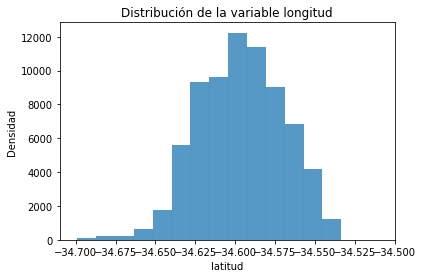

In [1500]:
lat_den = sns.histplot(prop_caba_data['latitud'], bins= 2500).set(title="Distribución de la variable longitud",
                                                            xlabel="latitud",
                                                            ylabel="Densidad",
                                                            xlim=(-34.71, -34.5))

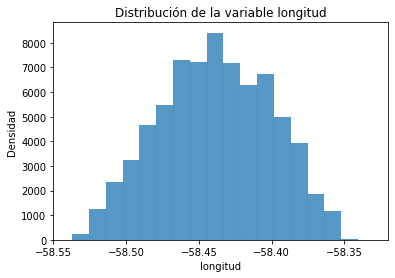

In [1501]:
long_den = sns.histplot(prop_caba_data['longitud'], bins = 1500).set(title="Distribución de la variable longitud",
                                                            xlabel="longitud",
                                                            ylabel="Densidad",
                                                            xlim=(-58.55, -58.32))

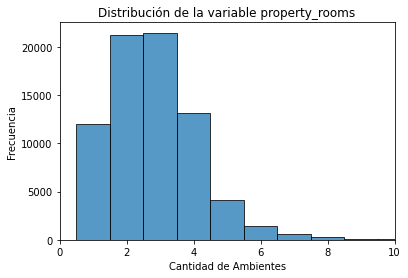

In [1502]:
rooms_hist = sns.histplot(prop_caba_data['property_rooms'], discrete=True).set(title="Distribución de la variable property_rooms",
                                                            xlabel="Cantidad de Ambientes",
                                                            ylabel="Frecuencia",
                                                            xlim=(0, 10))

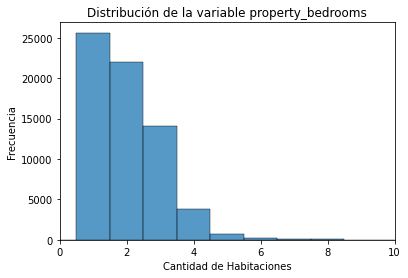

In [1503]:
bedrooms_hist = sns.histplot(prop_caba_data['property_bedrooms'], discrete=True).set(title="Distribución de la variable property_bedrooms",
                                                            xlabel="Cantidad de Habitaciones",
                                                            ylabel="Frecuencia",
                                                            xlim=(0, 10))

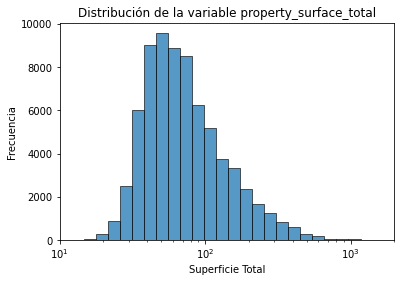

In [1504]:
sup_total_den = sns.histplot(prop_caba_data, x='property_surface_total', log_scale=True, bins = 50).set(title="Distribución de la variable property_surface_total",
                                                            xlabel="Superficie Total",
                                                            ylabel="Frecuencia",
                                                            xlim=(10, 2000))

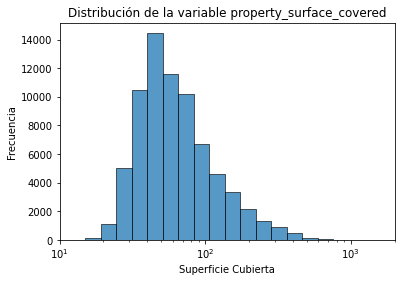

In [1505]:
sup_cubierta_den = sns.histplot(prop_caba_data, x='property_surface_covered', log_scale=True, bins=50).set(title="Distribución de la variable property_surface_covered",
                                                            xlabel="Superficie Cubierta",
                                                            ylabel="Frecuencia",
                                                            xlim=(10, 2000))

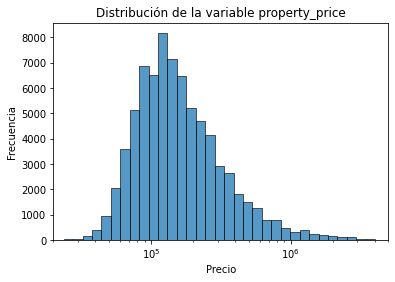

In [1506]:
price_den = sns.histplot(data=train_target, log_scale=True, bins=50).set(title="Distribución de la variable property_price",
                                                    xlabel="Precio",
                                                    ylabel="Frecuencia",
                                                    xlim=(20000, 5000000))
#plt.ticklabel_format(useOffset=False, style='plain')

Se puede apreciar que el precio de la mayoría de las propiedades ronda los cien mil dolares.

In [1507]:
train_target.mode()

0             110,000.00
dtype: float64

### Variables cualitativas
Vemos los valores únicos para las variables categóricas

In [1508]:
prop_caba_data[categoricas].nunique()

property_type     3
place_l4          4
place_l3         57
dtype: int64

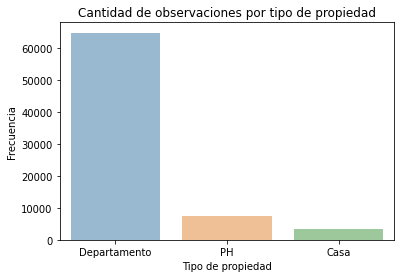

In [1509]:
#Tipo de Propiedad
prop_type_data = prop_caba_data['property_type'].value_counts()


sns_bar_plot=sns.barplot(x=prop_type_data.index.tolist(), y=prop_type_data.tolist() ,alpha=0.5).set(title="Cantidad de observaciones por tipo de propiedad",
                                                                      xlabel='Tipo de propiedad',
                                                                      ylabel='Frecuencia')

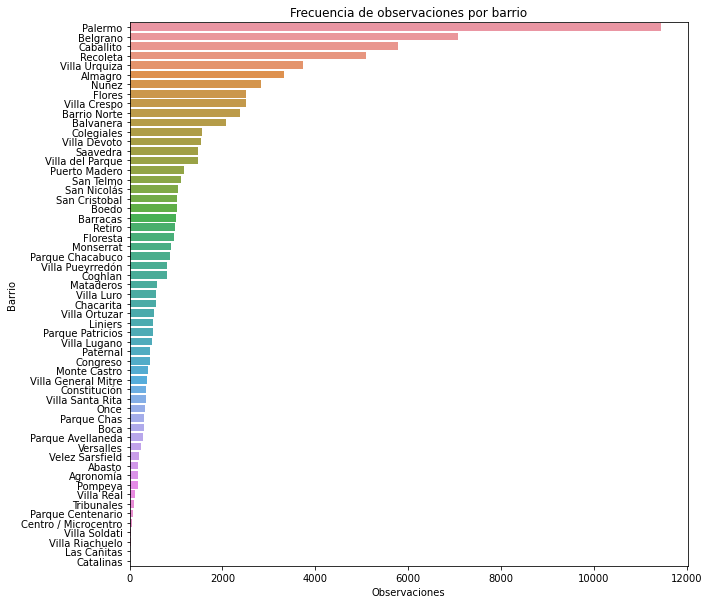

In [1510]:
# Barrio
barrio_data = prop_caba_data['place_l3'].value_counts()
barrios = barrio_data.index.tolist()

plt.figure(figsize = (10,10))
sns_bar_plot=sns.barplot(x=barrio_data.tolist(), y=barrios , orient="h").set(title="Frecuencia de observaciones por barrio",
                                                                      xlabel='Observaciones',
                                                                      ylabel='Barrio')

place_l4 sólo aplica a Palermo y lo subdivide en cuatro sub-zonas.

In [1511]:
prop_caba_data['place_l4'].value_counts(dropna=False)

NaN                  72600
Palermo Hollywood     1274
Palermo Chico          878
Palermo Soho           633
Palermo Viejo          132
Name: place_l4, dtype: int64

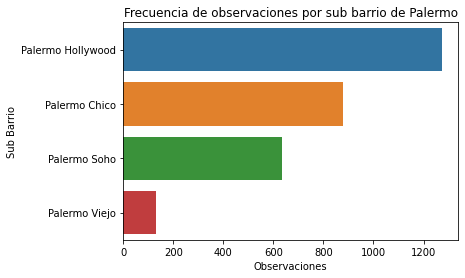

In [1512]:
# Sub Barrio
sub_barrio_data = prop_caba_data['place_l4'].value_counts()
sub_barrios = sub_barrio_data.index.tolist()

sns_bar_plot=sns.barplot(x=sub_barrio_data.tolist(), y=sub_barrios , orient="h").set(title="Frecuencia de observaciones por sub barrio de Palermo",
                                                                      xlabel='Observaciones',
                                                                      ylabel='Sub Barrio')

In [1513]:
prop_caba_data[prop_caba_data.place_l4.notna()].place_l3.value_counts()

Palermo    2917
Name: place_l3, dtype: int64

In [1514]:
prop_caba_data[prop_caba_data.place_l4.notna()].place_l3.isna().any()

False

Por lo tanto place_l4 sólo aplica a propiedades en Palermo. Pero de todos modos, no se considera irrelevante ya que se toma la decisión de sustituír las ocurrencias de 'Palermo' en place_l3 por las ocurrencias de place_l4 donde ésta tiene un valor no nulo.

### Correlaciones

A continuación se realiza un análisis de correlaciones entre las variables del Dataset de propiedades filtrado. Para ello se utiliza un mapa de calor de correlación, este tipo de gráfico visualiza la fuerza de las relaciones entre variables numéricas, y se utiliza para comprender qué variables están relacionadas entre sí y la fuerza de esta relación.

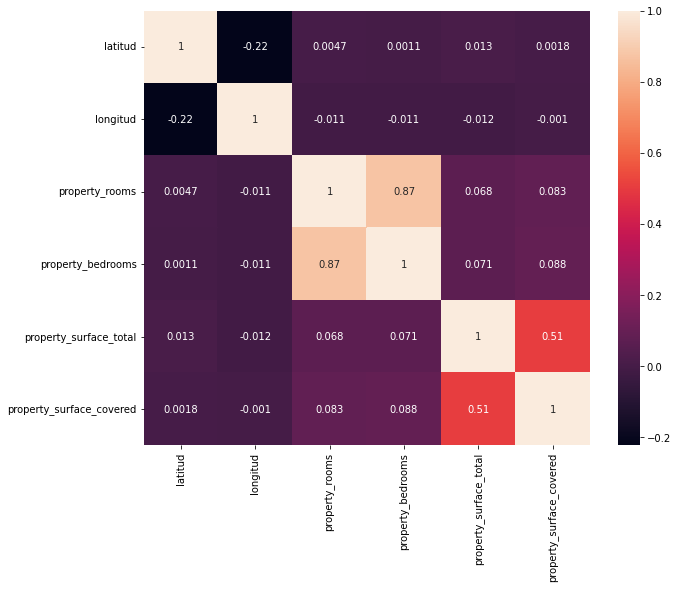

In [1515]:
if not quick_exec:
  plt.figure(figsize = (10,8))
  corr = prop_caba_data.corr()
  sns.heatmap(corr, annot=True)


Se puede apreciar en el gráfico que las variables más correlacionadas son 'property_rooms' con 'property_bedrooms', esta correlación es prácticamente lineal (0.87).

In [1516]:
table = prop_caba_data.pivot_table(index='property_rooms', columns='property_bedrooms',values='latitud', aggfunc='count', fill_value=0)
table_log=table.applymap(lambda x: math.log10(x) if x > 0 else 0)

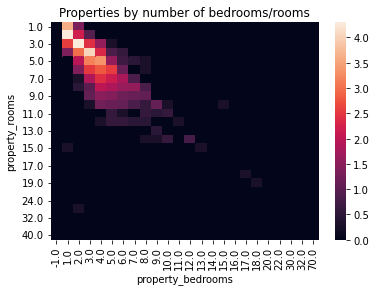

In [1517]:
if not quick_exec:
  sns.heatmap(table_log).set(title="Properties by number of bedrooms/rooms")

Los datos de beds y bedrooms están muy sesgados a la izquierda.

En segundo lugar, 'property_surface_total' y 'property_surface_covered' también están considerablemente correlacionadas (0.51)

In [1518]:
def areamap(x):
  return round(x, -1)
if not quick_exec:
  binned_surf = prop_caba_data[['property_surface_covered','property_surface_total']].applymap(areamap)
  binned_surf = binned_surf.assign(values=1)
  table_surf =  binned_surf.pivot_table(index='property_surface_total', columns='property_surface_covered', values='values', aggfunc='count',fill_value=0)
  table_log=table_surf.applymap(lambda x: math.log10(x) if x > 0 else 0)
  table_log.head()

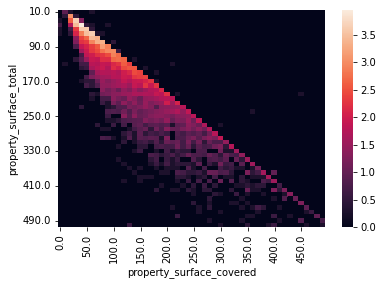

In [1519]:
if not quick_exec:
  sns.heatmap(table_log)
  plt.ylim(50,0)
  plt.xlim(0,50)
  plt.show()

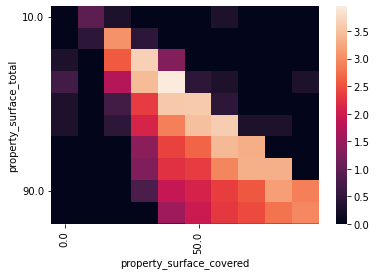

In [1520]:
if not quick_exec:
  sns.heatmap(table_log)
  plt.ylim(10,0)
  plt.xlim(0,10)
  plt.show()

##**b) Datos Faltantes :**

Veo el porcentaje de valores nulos de cada atributo

In [1521]:
prop_caba_data.shape

(75517, 9)

In [1522]:
def percentage_null_per_column(df):
  return df.isna().agg('sum', axis=0) * 100 / len(df)

In [1523]:
percentage_null_per_column(prop_caba_data)

latitud                                    3.92
longitud                                   3.92
place_l3                                   0.44
place_l4                                  96.14
property_type                              0.00
property_rooms                             1.10
property_bedrooms                         11.55
property_surface_total                     5.15
property_surface_covered                   3.54
dtype: float64

Veamos los datos faltantes según el tipo de propiedad.

In [1524]:
grouped_data = prop_caba_data.groupby('property_type')
for group in grouped_data.groups:
  print(group)
  print(percentage_null_per_column(grouped_data.get_group(group)))
  print('\n')

Casa
latitud                                    2.98
longitud                                   2.98
place_l3                                   4.11
place_l4                                  98.18
property_type                              0.00
property_rooms                             8.73
property_bedrooms                          3.58
property_surface_total                    10.31
property_surface_covered                   2.71
dtype: float64


Departamento
latitud                                    4.26
longitud                                   4.26
place_l3                                   0.27
place_l4                                  95.75
property_type                              0.00
property_rooms                             0.75
property_bedrooms                         12.95
property_surface_total                     5.01
property_surface_covered                   3.71
dtype: float64


PH
latitud                                    1.43
longitud                         

### Missing values: place_l4
place_l4 tiene muchos valores perdidos porque sólo descibe subregiones de Palermo.

In [1525]:
prop_caba_data.place_l3.value_counts()[:5]

Palermo          11444
Belgrano          7067
Caballito         5770
Recoleta          5088
Villa Urquiza     3742
Name: place_l3, dtype: int64

In [1526]:
prop_caba_data.place_l4.value_counts()[:5]

Palermo Hollywood    1274
Palermo Chico         878
Palermo Soho          633
Palermo Viejo         132
Name: place_l4, dtype: int64

### Valores nulos de ambientes y habitaciones
Las columnas de cantidad de 'ambientes' (rooms) y  'habitaciones' (bedrooms) tienen muchos valores nulos. Vemos los registros donde faltan ambas:


In [1527]:
room_data_missing = prop_caba_data[prop_caba_data.property_rooms.isna() & prop_caba_data.property_bedrooms.isna()]

In [1528]:
len(room_data_missing)

340

 Vemos una donde falta alguna, o rooms o bedrooms

In [1529]:
len(prop_caba_data[prop_caba_data.property_rooms.isna() | prop_caba_data.property_bedrooms.isna()])

9215

### Valores faltantes por fila
A cuántas filas les falta un dado porcentaje de sus atributos?

In [1530]:
def quantity_null_per_row(df):
  return df.isna().agg('sum', axis=1)

In [1531]:
percentage_missing = (quantity_null_per_row(prop_caba_data) * 100 / len(csv.columns))

In [1532]:
percentage_missing.head()

100248                   5.00
251283                  15.00
360251                   5.00
97804                   10.00
1472                     5.00
dtype: float64

In [1533]:
missing_values = percentage_missing.value_counts().sort_index()

In [1534]:
missing_values.index = missing_values.index.map(lambda label: str(round(label)) + '%')

In [1535]:
#cantidad de columnas
len(prop_caba_data.columns)

9

Text(0.5, 0, '% missed values')

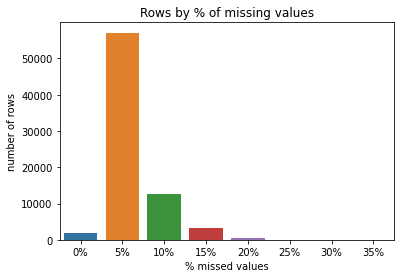

In [1536]:
sns.barplot(x=missing_values.index, y = missing_values.values)
plt.title("Rows by % of missing values")
plt.ylabel("number of rows")
plt.xlabel("% missed values")

En este gráfico se ve que a la mayoría de los registros le faltan 5% de los atributos

### Otros valores faltantes


In [1537]:
prop_caba_data.property_bedrooms.unique()

array([ 5.,  1.,  2.,  3.,  4., nan,  6., 17., 10.,  7.,  8., 20., 30.,
        9., 22., 13., 11., 70., 15., 14., 18., 16., 12., -1., 32.])

In [1538]:
prop_caba_data.property_rooms.unique()

array([ 7.,  2.,  3.,  4.,  5.,  1.,  6., nan,  8., 12., 10., 18.,  9.,
       11., 14., 15., 17., 36., 20., 19., 13., 30., 35., 16., 40., 32.,
       24.])

Se ve que bedrooms tiene el valor negativo -1, lo consideramos faltante.

### Estrategias para reparar valores faltantes

### rooms y bedrooms

#### Faltan ambas

In [1539]:
room_cols = ['property_rooms', 'property_bedrooms']

In [1540]:
median_rooms_res = prop_caba_data[room_cols].median()

In [1541]:
median_rooms_res

property_rooms                      3.00
property_bedrooms                   2.00
dtype: float64

Las medianas son razonables. Si faltan ambos valores, rellenamos con ellas:

In [1542]:
old_csv = prop_caba_data.copy(deep=True)

In [1543]:
# imputamos la columna usando fillna
new = prop_caba_data[prop_caba_data.property_rooms.isna() & prop_caba_data.property_bedrooms.isna()].property_bedrooms.fillna(median_rooms_res.property_bedrooms)
# sobreescribimos el dataset con la columna post-imputar
prop_caba_data.update(new)

In [1544]:
new_test = prop_caba_test[prop_caba_test.property_rooms.isna() & prop_caba_test.property_bedrooms.isna()].property_bedrooms.fillna(median_rooms_res.property_bedrooms)
prop_caba_test.update(new_test)

#### Hot Deck Imputing
Usamos la relación entre rooms y bedrooms para predecir una con la otra.

Definimos grupos de 'similaridad' como aquellos donde el valor de 'bedroom' es el mismo. Armamos una tabla de la mediana de rooms, para cada grupo, lo usamos para rellenar registros que les falta el valor de 'room'.

Si no hay ningun grupo con el mismo valor, usamos el grupo mas parecido.

Mismo procedimiento para registros que les falta el valor 'bedroom'.

In [1545]:
def closest_value(list, value_chosen):
  return min(list, key=lambda x:abs(x-value_chosen))
def hdi(prop_caba_data, criterion_col, target_col):
  similarity_criterion = prop_caba_data[criterion_col]
  modes = prop_caba_data.groupby(similarity_criterion)[target_col].agg(np.median)
  lacking_rows = prop_caba_data[prop_caba_data[target_col].isna()]
  newvalues = lacking_rows[criterion_col].map(lambda x: modes[x] if modes[x] else modes[closest_value(modes.keys, x)])
  return newvalues

In [1546]:
newrooms = hdi(prop_caba_data, 'property_bedrooms', 'property_rooms')
newbedrooms = hdi(prop_caba_data, 'property_rooms', 'property_bedrooms')

prop_caba_data.property_rooms.update(newrooms)
prop_caba_data.property_bedrooms.update(newbedrooms)

In [1547]:
len(prop_caba_data[prop_caba_data.property_rooms.isna()])

0

In [1548]:
len(prop_caba_data[prop_caba_data.property_bedrooms.isna()])

1

Repetir todo para test

In [1549]:
newrooms = hdi(prop_caba_test, 'property_bedrooms', 'property_rooms')
newbedrooms = hdi(prop_caba_test, 'property_rooms', 'property_bedrooms')

prop_caba_test.property_rooms.update(newrooms)
prop_caba_test.property_bedrooms.update(newbedrooms)

In [1550]:
len(prop_caba_test[prop_caba_test.property_rooms.isna()])

1

In [1551]:
len(prop_caba_test[prop_caba_test.property_bedrooms.isna()])

0

Rellenamos los registros que quedan con fillna

In [1552]:
new = prop_caba_data.property_bedrooms.fillna(median_rooms_res.property_bedrooms)
prop_caba_data.update(new)
new = prop_caba_data.property_rooms.fillna(median_rooms_res.property_rooms)
prop_caba_data.update(new)

In [1553]:
new_test = prop_caba_test.property_bedrooms.fillna(median_rooms_res.property_bedrooms)
prop_caba_test.update(new_test)
new_test = prop_caba_test.property_rooms.fillna(median_rooms_res.property_rooms)
prop_caba_test.update(new_test)

### Comparamos las distribuciones antes y despues

In [1554]:
old_csv[room_cols].describe()

,property_rooms,property_bedrooms
count,"74,687.00","66,792.00"
mean,2.82,2.01
std,1.43,1.13
min,1.00,-1.00
25%,2.00,1.00
50%,3.00,2.00
75%,4.00,3.00
max,40.00,70.00


In [1555]:
prop_caba_data[room_cols].describe()

,property_rooms,property_bedrooms
count,"75,517.00","75,517.00"
mean,2.83,1.91
std,1.44,1.11
min,1.00,-1.00
25%,2.00,1.00
50%,3.00,2.00
75%,4.00,3.00
max,40.00,70.00


Text(0, 0.5, 'Density')

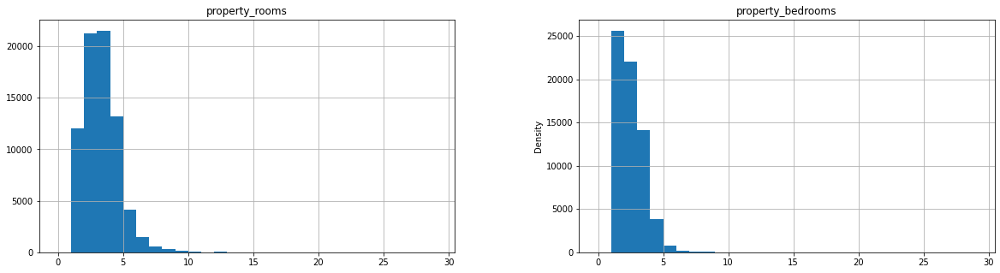

In [1556]:
old_csv[room_cols].hist(bins=range(0,30), figsize=(20,5))

plt.ylabel('Density')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fbe59765b90>,
      dtype=object)

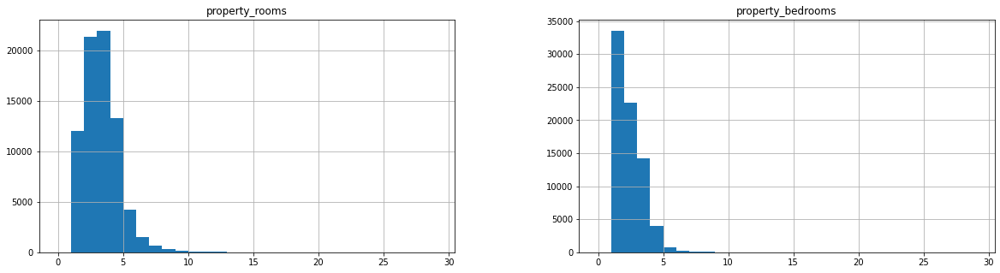

In [1557]:
prop_caba_data[room_cols].hist(bins=range(0,30), figsize=(20,5))

### place_l4
place_l3 son barrios de la ciudad y l4 son sub-barrios dentro de palermo. Podemos unirlos en un solo atributo, con los atributos de l3, y para las propiedades en palermo tiene la subregión de palermo en la que están

In [1558]:
indexer = prop_caba_data.place_l4.notna()
indexer_test = prop_caba_test.place_l4.notna()

prop_caba_data.loc[indexer,:]

,latitud,longitud,place_l3,place_l4,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
228951,-34.58,-58.44,Palermo,Palermo Hollywood,Departamento,2.00,1.00,52.00,52.00
196297,-34.58,-58.41,Palermo,Palermo Chico,Departamento,6.00,4.00,212.00,192.00
40673,-34.58,-58.42,Palermo,Palermo Chico,Departamento,3.00,2.00,86.00,79.00
293147,-34.58,-58.43,Palermo,Palermo Hollywood,Departamento,1.00,1.00,42.00,34.00
279823,-34.58,-58.44,Palermo,Palermo Hollywood,Departamento,2.00,1.00,NaN,52.00
...,...,...,...,...,...,...,...,...,...
55039,-34.58,-58.44,Palermo,Palermo Hollywood,Departamento,1.00,1.00,29.00,29.00
409237,-34.59,-58.42,Palermo,Palermo Soho,Departamento,1.00,1.00,NaN,48.00
316300,-34.58,-58.41,Palermo,Palermo Chico,Departamento,1.00,1.00,22.00,22.00
110783,-34.58,-58.42,Palermo,Palermo Chico,Departamento,4.00,3.00,80.00,70.00


In [1559]:
# Para todas las propiedades donde l4 tiene un valor, sustituir ese valor en l3 
prop_caba_data.loc[indexer, "place_l3"] = prop_caba_data.loc[indexer,"place_l4"]
#test
prop_caba_test.loc[indexer_test, "place_l3"] = prop_caba_test.loc[indexer_test,"place_l4"]

In [1560]:
# Veamos todos los lugares donde se aplicó la transformación
prop_caba_data[prop_caba_data.place_l4.notna()].place_l3.value_counts(dropna= False)

Palermo Hollywood    1274
Palermo Chico         878
Palermo Soho          633
Palermo Viejo         132
Name: place_l3, dtype: int64

In [1561]:
prop_caba_data = prop_caba_data.drop('place_l4',axis='columns')
prop_caba_test = prop_caba_test.drop('place_l4',axis='columns')

### sin place_l3
rellenamos con moda de place_l3

In [1562]:
mode_place =  prop_caba_data.place_l3.mode()

In [1563]:
prop_caba_data.loc[prop_caba_data.place_l3.isna(),'place_l3'] = mode_place.iloc[0]
#test
prop_caba_test.loc[prop_caba_test.place_l3.isna(),'place_l3'] = mode_place.iloc[0]

### Latitud y longitud
Cuando falta o longitud o longitud, faltan ambos.
Alrededor de un 10% de datos tiene latitud y longitud faltante. Eliminamos los faltantes
 TODO: rellenar con mediana por cada región l3

In [1564]:
old_csv = prop_caba_data.copy()

In [1565]:
(prop_caba_data[prop_caba_data.latitud.isna()].index == prop_caba_data[prop_caba_data.longitud.isna()].index).all()

True

In [1566]:
len(prop_caba_data[prop_caba_data.latitud.isna()])

2964

Agrupar por región l3, obtener tabla de medianas

In [1567]:
prop_caba_data.groupby('place_l3')[['longitud', 'latitud']].median()

,longitud,latitud
place_l3,,
Abasto,-58.41,-34.60
Agronomía,-58.49,-34.59
Almagro,-58.42,-34.61
Balvanera,-58.40,-34.61
Barracas,-58.37,-34.64
...,...,...
Villa Riachuelo,-58.47,-34.69
Villa Santa Rita,-58.48,-34.62
Villa Soldati,-58.44,-34.66


Usar tabla para rellenar valores

In [1568]:
def _get_table(X, col1, col2):
  return X.groupby(X[col1])[col2].agg(np.median)
def hdi(prop_caba_data, table, col1, col2):
  lacking_rows = prop_caba_data[prop_caba_data[col2].isna()]
  newvalues = lacking_rows[col1].map(lambda x: table[x] if table[x] else prop_caba_data[col2].median())
  return newvalues

In [1569]:
table = _get_table(prop_caba_data, 'place_l3', 'longitud')
newlon = hdi(prop_caba_data, table, 'place_l3', 'longitud')
newlat = hdi(prop_caba_data, table, 'place_l3', 'latitud')

prop_caba_data.longitud.update(newlon)
prop_caba_data.latitud.update(newlat)

In [1570]:
# test, usando la misma tabla
newlon = hdi(prop_caba_test, table, 'place_l3', 'longitud')
newlat = hdi(prop_caba_test, table, 'place_l3', 'latitud')

prop_caba_test.longitud.update(newlon)
prop_caba_test.latitud.update(newlat)

In [1571]:
percentage_null_per_column(prop_caba_test)

latitud                                    0.00
longitud                                   0.00
place_l3                                   0.00
property_type                              0.00
property_rooms                             0.00
property_bedrooms                          0.00
property_surface_total                     5.09
property_surface_covered                   3.61
dtype: float64

repito para test:

In [1572]:
newlon = hdi(prop_caba_data, table, 'place_l3', 'longitud')
newlat = hdi(prop_caba_data, table, 'place_l3', 'latitud')

prop_caba_data.longitud.update(newlon)
prop_caba_data.latitud.update(newlat)

Comparamos distribuciones (TODO histograma)

In [1573]:
old_csv.longitud.describe()

count              72,553.00
mean                  -58.45
std                     0.29
min                   -71.47
25%                   -58.47
50%                   -58.44
75%                   -58.41
max                   -54.13
Name: longitud, dtype: float64

In [1574]:
prop_caba_data.longitud.describe()

count              75,517.00
mean                  -58.45
std                     0.28
min                   -71.47
25%                   -58.47
50%                   -58.44
75%                   -58.41
max                   -54.13
Name: longitud, dtype: float64

### Área superficial
Creamos un modelo de regresión para la superficie cubierta en base a long, lat, rooms y bedrooms

In [1575]:
len(prop_caba_data[prop_caba_data.property_surface_total.isna()])

3890

In [1576]:
len(prop_caba_data[prop_caba_data.property_surface_covered.isna()])

2677

In [1577]:
from sklearn import preprocessing
def join_xy_nonull(X,y):
  joined = X.join(y, how='inner')
  joined = joined.dropna()
  X = joined[X.columns]
  y = joined[y.name]
  return X,y

def train_scaler(X):
  scaler = preprocessing.MinMaxScaler()
  scaler.fit(X.values)
  return scaler

def regress_column(y, X):
  from sklearn import linear_model
  # train with non null dataset
  X,y = join_xy_nonull(X,y)

  #scale data
  scaler = train_scaler(X)
  X_scale = scaler.transform(X.values)
  model = linear_model.LinearRegression()
  model.fit(X=X_scale, y=y)
  return scaler, model

def model_values(model, y, input_frame):
  # missing y, no null X
  X = input_frame.dropna()
  X_no_y = X.loc[y.isna(), :]
  # predict          
  raw_predictions = model.predict(X_no_y)
  predictions = pd.Series(raw_predictions, index = X_no_y.index, name = y.name)
  return predictions

'''must be non null X and y'''
def test_model(model, X, y):
  return model.score(X=X, y = y)

In [1578]:
X_input = prop_caba_test[['property_rooms', 'property_bedrooms','longitud','latitud']]
ycovered = prop_caba_test['property_surface_covered']
ytotal = prop_caba_test['property_surface_total']

X_input_test = prop_caba_data[['property_rooms', 'property_bedrooms','longitud','latitud']]
ycovered_test = prop_caba_data['property_surface_covered']
ytotal_test = prop_caba_data['property_surface_total']

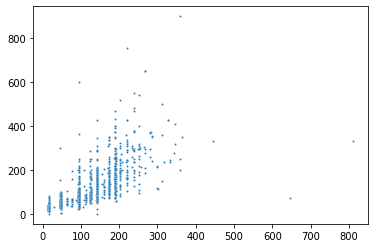

In [1579]:
# covered
X, X_eval, y, y_eval = train_test_split(X_input, ycovered, test_size=0.2,random_state=12)
median = y.median()

#train
scaler, model = regress_column(y, X)

#use
X_nn,y_nn = join_xy_nonull(X_eval,y_eval)
X_nn = scaler.transform(X_nn.values)
predictions = model.predict(X_nn)
scatter_predicted_versus_real(predictions, y_nn.values,size=4)
r2_score = test_model(model, X_nn, y_nn)

In [1580]:
r2_score

0.5179426488152368

Dependiendo del r2 score en train, uso o no el modelo en los conjuntos train y test

In [1581]:
values = model_values(model, y, X)
if(r2_score > 0.4):
  prop_caba_data.update(values)
ycovered.fillna(median, inplace=True)

#aplicar modelo a test
X = X_input_test
y = ycovered_test
values = model_values(model, y, X)

# si el r2 score en train dio bien, uso el modelo
if(r2_score > 0.4):
  prop_caba_test.update(values)
ycovered_test.fillna(median, inplace=True)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"


Repetir para superficie total

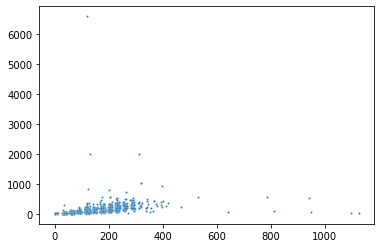

In [1582]:
# total
X, X_eval, y, y_eval = train_test_split(X_input, ytotal, test_size=0.2,random_state=12)
median = y.median()

#train
scaler, model = regress_column(y, X)

#use
X_nn,y_nn = join_xy_nonull(X_eval,y_eval)
X_nn = scaler.transform(X_nn.values)
predictions = model.predict(X_nn)
scatter_predicted_versus_real(predictions, y_nn.values,size=4)
r2_score = test_model(model, X_nn, y_nn)

In [1583]:
values = model_values(model, y, X)
if(r2_score > 0.4):
  prop_caba_data.update(values)
ytotal.fillna(median, inplace=True)

#aplicar modelo a test
X = X_input_test
y = ytotal_test
values = model_values(model, y, X)
if(r2_score > 0.4):
  prop_caba_test.update(values)
ytotal_test.fillna(median, inplace=True)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"


Vemos proporción de nulos después del preprocesamiento:

In [1584]:
percentage_null_per_column(prop_caba_data)

latitud                                    0.00
longitud                                   0.00
place_l3                                   0.00
property_type                              0.00
property_rooms                             0.00
property_bedrooms                          0.00
property_surface_total                     0.00
property_surface_covered                   0.00
dtype: float64

In [1585]:
percentage_null_per_column(prop_caba_test)

latitud                                    0.00
longitud                                   0.00
place_l3                                   0.00
property_type                              0.00
property_rooms                             0.00
property_bedrooms                          0.00
property_surface_total                     0.00
property_surface_covered                   0.00
dtype: float64

#### Distribución tras transformaciones

In [1586]:
old_csv[['property_surface_total', 'property_surface_covered']].describe()

,property_surface_total,property_surface_covered
count,"71,627.00","72,840.00"
mean,109.10,88.38
std,947.04,"1,007.55"
min,10.00,1.00
25%,45.00,40.00
50%,65.00,58.00
75%,105.00,88.00
max,"137,000.00","217,000.00"


In [1587]:
prop_caba_data[['property_surface_total', 'property_surface_covered']].describe()

,property_surface_total,property_surface_covered
count,"75,517.00","75,517.00"
mean,106.82,87.27
std,922.37,989.54
min,10.00,1.00
25%,46.00,41.00
50%,65.00,57.00
75%,100.00,86.00
max,"137,000.00","217,000.00"


In [1588]:
# quitmoslos place_l3 nulos
prop_caba_data = prop_caba_data.loc[prop_caba_data.place_l3.notna(), :]
#test
prop_caba_test = prop_caba_test.loc[prop_caba_test.place_l3.notna(), :]

Finalmente tenemos estos valores nulos:

In [1589]:
percentage_null_per_column(prop_caba_data)

latitud                                    0.00
longitud                                   0.00
place_l3                                   0.00
property_type                              0.00
property_rooms                             0.00
property_bedrooms                          0.00
property_surface_total                     0.00
property_surface_covered                   0.00
dtype: float64

In [1590]:
percentage_null_per_column(prop_caba_test)

latitud                                    0.00
longitud                                   0.00
place_l3                                   0.00
property_type                              0.00
property_rooms                             0.00
property_bedrooms                          0.00
property_surface_total                     0.00
property_surface_covered                   0.00
dtype: float64

##**c) Valores atípicos :**

In [1591]:
prop_caba_data.shape

(75517, 8)

In [1592]:
prop_caba_test.shape

(18732, 8)

### Univariados
Usaremos en longitud/latitud, rooms/bedrooms y property_surface técnicas para identificar outliers univariados.

#### Propiedades fuera de CABA

Las regiones que difieren por mas de 1 de las coordenadas -34, -58 seguramente no están en CABA, las tiro. (Esto es una estrategia pero se aplica antes de hacer el análisis con z-score)

In [1593]:
def crop_caba_square(prop_caba_data):
  return prop_caba_data[(prop_caba_data.latitud < -33) &(prop_caba_data.latitud > -35) & (prop_caba_data.longitud < -57) &(prop_caba_data.longitud > -59) ]

prop_caba_data = crop_caba_square(prop_caba_data)
# test
prop_caba_test = crop_caba_square(prop_caba_test)

In [1594]:
prop_caba_data.shape

(72396, 8)

In [1595]:
prop_caba_test.shape

(17928, 8)

#### Sacar outliers de rooms, bedrooms, property surface
Rooms, Bedrooms y property surface tienen una distribución que favorece valores pequeños, mientras que los valores grandes son cada vez menos comunes. La distribución tiene un sesgo, podemos usar una transformación para lograr normalidad (ingeniería de features) y usar este nuevo feature para clasificar outliers.

Por esto, para obtener outliers, le aplicamos a cada variable un logaritmo, y después le aplicamos la transformación z-score. Los valores cuya magnitud de z-score supere un threshold, se consideran outliers.

In [1596]:
ZSCORE_TH = 2.5
import scipy.stats as stats

In [1597]:
def get_outliers(series, ZSCORE_TH=ZSCORE_TH):
  # normalize using log
  log = series.map(lambda x: math.log10(x) if x>0 else np.nan)
  log_z = stats.zscore(log, nan_policy='omit')
  min = series[(-ZSCORE_TH < log_z)][ (log_z <ZSCORE_TH)].min()
  max = series[(-ZSCORE_TH < log_z)][ (log_z <ZSCORE_TH)].max()
  return min, max

In [1598]:
range_rooms = get_outliers(prop_caba_data.property_rooms)
range_beds = get_outliers(prop_caba_data.property_bedrooms)
range_st = get_outliers(prop_caba_data.property_surface_total)
range_sc = get_outliers(prop_caba_data.property_surface_covered)

Analizamos los rangos producidos por este procedimiento:

In [1599]:
def index_outliers(row, range):
  return (row > range[1]) | (row < range[0])
def outliers_from_range(df, row, range):
  return df[(row > range[1]) | (row < range[0])]

In [1600]:
# cuántos valores de 'property_bedrooms' son outliers?
len(outliers_from_range(prop_caba_data, prop_caba_data.property_bedrooms, range_beds))

411

In [1601]:
# cuántos valores de 'property_rooms' son outliers?
len(outliers_from_range(prop_caba_data, prop_caba_data.property_rooms, range_rooms))

311

In [1602]:
print(range_beds)

(1.0, 5.0)


In [1603]:
print(range_rooms)

(1.0, 8.0)


In [1604]:
print(range_st)

(15.0, 351.0)


In [1605]:
print(range_sc)

(14.0, 284.0)


#### Outliers del target 
El precio también tiene distribución con skew como rooms/bedrooms/surface, así que se utiliza el mismo método para hallar outliers

In [1606]:
range_price = get_outliers(train_target,1)

In [1607]:
print(range_price)

(77500.0, 330734.0)


Se analiza la cantidad de propiedades que se descartarían filtrando según el rango obtenido 

In [1608]:
len(prop_caba_data[index_outliers(train_target, range_price)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


19740

Es una cantidad demasiado significativa como para decidir descartarla arbitrariamente, por lo que se realizará un análisis más profundo posteriormete.

### Multivariados
Este método es apropiado para longitud y latitud. Graficamos los puntos en 2 dimensiones, se ve que los puntos crean la silueta de CABA:

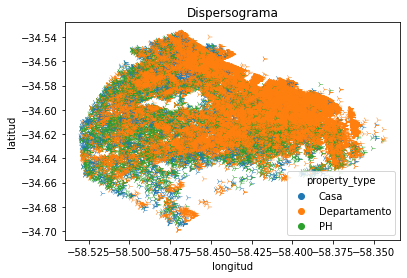

In [1609]:
if not quick_exec:
  #Scatter Plot
  sns.scatterplot( x=prop_caba_data.longitud, y=prop_caba_data.latitud, marker="4", hue=prop_caba_data.property_type)
  plt.title('Dispersograma')
  plt.show()
  prop_caba_data.columns

#### LOF
Usamos local outlier factor para identificar clusters de longitud y latitud, y limpiar los puntos atípicos en el espacio.

In [1610]:
from sklearn.neighbors import LocalOutlierFactor

In [1611]:
longlat_data= prop_caba_data[['longitud','latitud']]
longlat_test = prop_caba_test[['longitud','latitud']]

In [1612]:
#Conjunto de entrenamiento
X=longlat_data.values
#Creo el clasificador
clf = LocalOutlierFactor(n_neighbors=20,contamination=0.1)

#Genero prediccion
y_pred = clf.fit_predict(X)

#Guardo los scores
scores=clf.negative_outlier_factor_

In [1613]:
lof_train = pd.Series(y_pred, prop_caba_data.index)
lof_train.value_counts()

 1    65157
-1     7239
dtype: int64

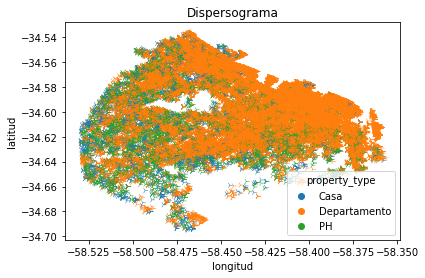

In [1614]:
if not quick_exec:
  #Scatter Plot
  sns.scatterplot( x=prop_caba_data[y_pred == 1].longitud, y=prop_caba_data[y_pred == 1].latitud, marker="4", hue=prop_caba_data[y_pred == 1].property_type)
  plt.title('Dispersograma')
  plt.show()
  prop_caba_data.columns

Analicemos los outliers:

In [1615]:
prop_caba_data[lof_train == -1].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
count,"7,239.00","7,239.00","7,239.00","7,239.00","7,239.00","7,239.00"
mean,-34.59,-58.44,2.86,1.93,99.25,83.69
std,0.03,0.04,1.44,1.08,229.20,194.89
min,-34.70,-58.53,1.00,1.00,14.00,1.00
25%,-34.61,-58.46,2.00,1.00,46.00,41.00
50%,-34.59,-58.44,3.00,2.00,65.00,57.00
75%,-34.57,-58.41,4.00,3.00,105.00,90.00
max,-34.54,-58.34,15.00,13.00,"14,744.00","13,717.00"


In [1616]:
prop_caba_data[lof_train == 1].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
count,"65,157.00","65,157.00","65,157.00","65,157.00","65,157.00","65,157.00"
mean,-34.60,-58.44,2.82,1.91,107.14,87.41
std,0.03,0.04,1.42,1.11,989.01,"1,063.01"
min,-34.69,-58.53,1.00,-1.00,10.00,1.00
25%,-34.62,-58.47,2.00,1.00,45.00,41.00
50%,-34.60,-58.44,3.00,2.00,65.00,57.00
75%,-34.58,-58.41,4.00,3.00,100.00,85.00
max,-34.54,-58.36,40.00,70.00,"137,000.00","217,000.00"


In [1617]:
prop_caba_data[lof_train == -1].sample(5)

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
104171,-34.61,-58.50,Villa del Parque,Departamento,3.00,2.00,120.00,74.00
326721,-34.57,-58.43,Palermo,Departamento,3.00,3.00,90.00,75.00
304222,-34.57,-58.47,Belgrano,Departamento,2.00,1.00,42.00,42.00
6118,-34.57,-58.43,Palermo,Departamento,1.00,1.00,31.00,27.00
265315,-34.59,-58.42,Palermo Soho,Departamento,3.00,2.00,64.00,60.00


In [1618]:
print(scores)

[-1.00760851e+00 -1.37886348e+00 -1.00309850e+00 ... -1.14800588e+00
 -9.74177960e-01 -4.29544632e+04]


##### Test

In [1619]:
# ahora usamos el mismo modelo para test
y_pred_test = clf.fit_predict(longlat_test.values)
lof_test = pd.Series(y_pred_test, prop_caba_test.index)
scores_test=clf.negative_outlier_factor_
print(scores_test)

[-1.01829219 -1.03934579 -0.98550436 ... -1.12184741 -1.03499675
 -1.02753402]


### Técnicas para los outliers

#### Atributos mayores que otros

Se descartan las propiedades con más bedrooms que rooms, y con más surface_covered que surface_total. Esto es debido a que se espera que las habitaciones sean un subconjunto de los ambientes, y que la superficie cubierta y la superficie no cubierta sumen para dar la superficie total.

In [1620]:
def more_than(prop_caba_data):
  return prop_caba_data[(prop_caba_data.property_rooms >= prop_caba_data.property_bedrooms) & (prop_caba_data.property_surface_total >= prop_caba_data.property_surface_covered)]

In [1621]:
prop_caba_data = more_than(prop_caba_data)
prop_caba_test = more_than(prop_caba_test)

#### Filtrado de outliers según rangos obtenidos mediante el análisis de logaritmo y z-score

Se descartan los outliers numéricos usando los rangos definidos anteriormente en el set de train

In [1622]:
def zscore_filtered(prop_caba_data):
  return prop_caba_data[
      ~index_outliers(prop_caba_data.property_bedrooms, range_beds)
      & ~index_outliers(prop_caba_data.property_rooms, range_rooms) 
      & ~index_outliers(prop_caba_data.property_surface_total, range_st) 
      & ~index_outliers(prop_caba_data.property_surface_covered, range_sc)]

In [1623]:
prop_caba_data = zscore_filtered(prop_caba_data)
prop_caba_test = zscore_filtered(prop_caba_test)

#### LOF

Se descartan los outliers obtenidos en el análisis LOF

In [1624]:
prop_caba_data = prop_caba_data[lof_train == 1]
prop_caba_test = prop_caba_test[lof_test == 1]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


#### Análisis de la relación entre el precio de venta y la superficie

En este inciso se analizará el precio por metro cuadrado (pxm2) de las propiedades

In [1625]:
#Se aplica filtrado según nuevo index a los targets
train_target = train_target.filter(prop_caba_data.index)
test_target = test_target.filter(prop_caba_test.index)

In [1626]:
#Dataset con el target, para poder analizar la relacion
with_target = pd.concat([prop_caba_data, train_target], axis = 1)
with_target_test = pd.concat([prop_caba_test, test_target], axis = 1)

In [1627]:
algorithm_pmx2 = lambda row: (row.property_price / row.property_surface_total)
pmx2 = with_target.apply(algorithm_pmx2, axis=1)
pmx2_test = with_target_test.apply(algorithm_pmx2, axis=1)

In [1628]:
pmx2.describe()

count              60,814.00
mean                2,342.11
std                   944.90
min                    42.73
25%                 1,764.71
50%                 2,212.12
75%                 2,727.27
max                37,777.78
dtype: float64

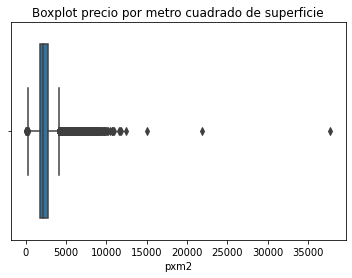

In [1629]:
bp = sns.boxplot(x=pmx2).set(title="Boxplot precio por metro cuadrado de superficie",
                                                            xlabel="pxm2")

El gráfico obtenido no permite realizar un análisis con claridad, por lo que se aplica logaritmo

In [1630]:
pxm2 = pmx2.map(lambda x: math.log10(x) if x>0 else np.nan)
pxm2_test = pmx2_test.map(lambda x: math.log10(x) if x>0 else np.nan)

In [1631]:
pxm2.describe()

count              60,814.00
mean                    3.34
std                     0.16
min                     1.63
25%                     3.25
50%                     3.34
75%                     3.44
max                     4.58
dtype: float64

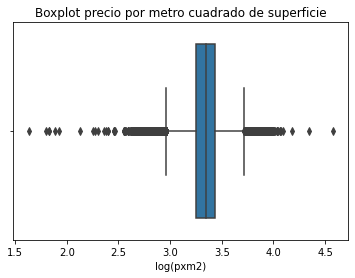

In [1632]:
bp = sns.boxplot(x=pxm2).set(title="Boxplot precio por metro cuadrado de superficie",
                                                            xlabel="log(pxm2)")

A continuación se realiza filtrado según la regla 1.5 IQR. Los datos que son más de 1.5 veces el valor del rango intercuartílico o, mejor dicho, que se encuentran a esa distancia del primer y tercer cuartil, se denominan valores atípicos.

In [1633]:
# finding the 1st quartile
q1 = np.quantile(pxm2, 0.25)
 
# finding the 3rd quartile
q3 = np.quantile(pxm2, 0.75)
med = np.median(pxm2)
 
# finding the iqr region
iqr = q3-q1
 
# finding upper and lower whiskers
upper_bound = q3+(1.5*iqr)
lower_bound = q1-(1.5*iqr)
print(iqr, upper_bound, lower_bound)

0.18905623622004875 3.7193129238915104 2.9630879790113154


In [1634]:
pxm2 = pxm2.loc[lambda x : x <= upper_bound].loc[lambda x : x >= lower_bound]

In [1635]:
prop_caba_data = prop_caba_data.filter(pxm2.index, axis=0)

Se replica el filtrado para test, a partir de los bounds calculados en train.

In [1636]:
pxm2_test = pxm2_test.loc[lambda x : x <= upper_bound].loc[lambda x : x >= lower_bound]

In [1637]:
prop_caba_test = prop_caba_test.filter(pxm2_test.index , axis=0)

### Se aplica finalmente filtrado según nuevo index de datos de train y test a los targets

In [1638]:
train_target = train_target.filter(prop_caba_data.index)
test_target = test_target.filter(prop_caba_test.index)

### Se guardan los conjuntos de datos obtenidos luego de realizar el trabajo de Análisis Exploratorio y Preprocesamiento de Datos:

In [1639]:
try:
  prop_caba_data.to_csv('drive/My Drive/tp1 datos grupal/Datasets/prop_caba_train.csv', index_label="index")
  prop_caba_test.to_csv('drive/My Drive/tp1 datos grupal/Datasets/prop_caba_test.csv', index_label="index")
except:
  prop_caba_data.to_csv('prop_caba_train.csv', index_label="index")
  prop_caba_test.to_csv('prop_caba_test.csv', index_label="index")

In [1640]:
prop_caba_data

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
100248,-34.64,-58.46,Flores,Casa,7.00,5.00,260.00,260.00
1472,-34.61,-58.37,San Telmo,PH,3.00,2.00,68.00,40.00
117479,-34.61,-58.43,Almagro,Departamento,4.00,3.00,210.00,175.00
79144,-34.64,-58.37,Barracas,Departamento,2.00,1.00,53.00,48.00
108699,-34.61,-58.40,Congreso,Departamento,4.00,3.00,124.00,104.00
...,...,...,...,...,...,...,...,...
290962,-34.61,-58.45,Villa Crespo,Departamento,1.00,1.00,32.00,29.00
105889,-34.58,-58.40,Palermo Chico,Departamento,1.00,1.00,20.00,20.00
136266,-34.61,-58.43,Caballito,Departamento,2.00,1.00,36.00,36.00
20953,-34.59,-58.39,Recoleta,Departamento,3.00,2.00,65.00,65.00


In [1641]:
prop_caba_test

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
352750,-34.56,-58.46,Belgrano,Departamento,3.00,2.00,65.00,65.00
94517,-34.56,-58.46,Belgrano,Departamento,3.00,2.00,57.00,49.00
65779,-34.56,-58.47,Villa Urquiza,Departamento,3.00,2.00,72.00,63.00
179714,-34.60,-58.43,Almagro,Departamento,1.00,1.00,29.00,29.00
171352,-34.65,-58.52,Mataderos,PH,3.00,2.00,86.00,66.00
...,...,...,...,...,...,...,...,...
419168,-34.59,-58.48,Parque Chas,PH,5.00,3.00,178.00,178.00
339511,-34.58,-58.43,Palermo,Departamento,2.00,1.00,38.00,35.00
187160,-34.58,-58.44,Palermo Hollywood,Departamento,3.00,1.00,111.00,111.00
30008,-34.56,-58.47,Coghlan,Departamento,2.00,1.00,53.00,47.00


In [1642]:
pre_encode = prop_caba_data.copy()

## **Análisis del dataset obtenido luego de pre-procesar los datos**

### Variables cuantitativas
Describe() nos da la media, mediana, cuartiles...

In [1643]:
prop_caba_data[cuantitativas].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
count,"58,682.00","58,682.00","58,682.00","58,682.00","58,682.00","58,682.00"
mean,-34.60,-58.44,2.69,1.80,79.04,67.02
std,0.03,0.04,1.19,0.90,51.33,41.41
min,-34.69,-58.53,1.00,1.00,15.00,14.00
25%,-34.62,-58.47,2.00,1.00,45.00,40.00
50%,-34.60,-58.44,3.00,2.00,65.00,55.00
75%,-34.58,-58.41,3.00,2.00,94.00,79.00
max,-34.54,-58.36,8.00,5.00,351.00,283.00


Ahora para calcular Q1, Medianas y Q3:

In [1644]:
prop_caba_data[cuantitativas].quantile([0.25, 0.5, 0.75])

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
0.25,-34.62,-58.47,2.00,1.00,45.00,40.00
0.50,-34.60,-58.44,3.00,2.00,65.00,55.00
0.75,-34.58,-58.41,3.00,2.00,94.00,79.00


Para el calculo de la moda se utiliza el método:

In [1645]:
prop_caba_data[cuantitativas].mode()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered
0,-34.54,-58.47,3.00,1.00,65.00,57.00


A continuación se realizan los gráficos de distribuciones de variables cuantitativas

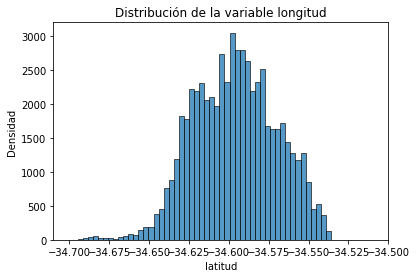

In [1646]:
lat_den = sns.histplot(prop_caba_data['latitud'], bins= 50).set(title="Distribución de la variable longitud",
                                                            xlabel="latitud",
                                                            ylabel="Densidad",
                                                            xlim=(-34.71, -34.5))

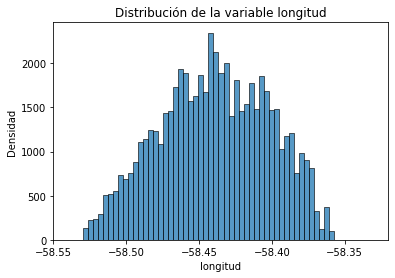

In [1647]:
long_den = sns.histplot(prop_caba_data['longitud'], bins = 50).set(title="Distribución de la variable longitud",
                                                            xlabel="longitud",
                                                            ylabel="Densidad",
                                                            xlim=(-58.55, -58.32))

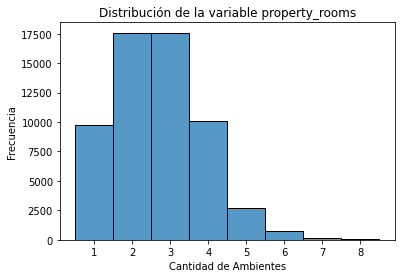

In [1648]:
rooms_hist = sns.histplot(prop_caba_data['property_rooms'], discrete=True).set(title="Distribución de la variable property_rooms",
                                                            xlabel="Cantidad de Ambientes",
                                                            ylabel="Frecuencia")

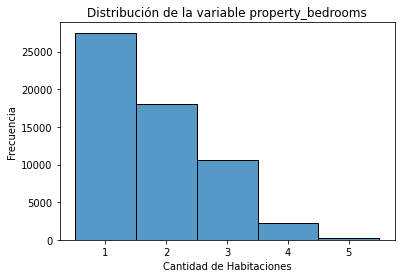

In [1649]:
bedrooms_hist = sns.histplot(prop_caba_data['property_bedrooms'], discrete=True).set(title="Distribución de la variable property_bedrooms",
                                                            xlabel="Cantidad de Habitaciones",
                                                            ylabel="Frecuencia")

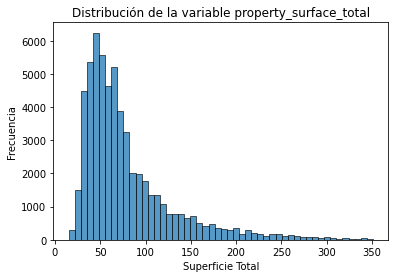

In [1650]:
sup_total_den = sns.histplot(prop_caba_data, x='property_surface_total', bins = 50).set(title="Distribución de la variable property_surface_total",
                                                            xlabel="Superficie Total",
                                                            ylabel="Frecuencia")

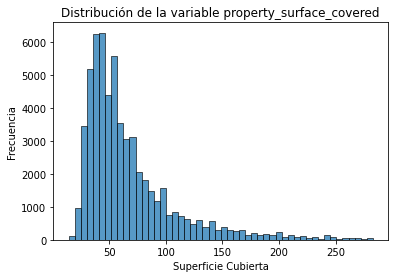

In [1651]:
sup_cubierta_den = sns.histplot(prop_caba_data, x='property_surface_covered', bins=50).set(title="Distribución de la variable property_surface_covered",
                                                            xlabel="Superficie Cubierta",
                                                            ylabel="Frecuencia")

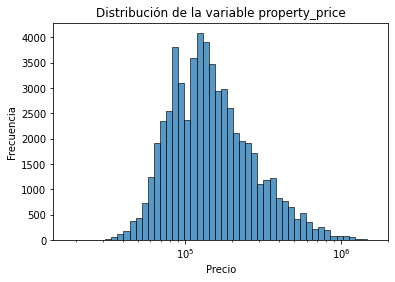

In [1652]:
price_den = sns.histplot(data=train_target, log_scale=True, bins=50).set(title="Distribución de la variable property_price",
                                                    xlabel="Precio",
                                                    ylabel="Frecuencia")
#plt.ticklabel_format(useOffset=False, style='plain')

Se puede apreciar que el precio de la mayoría de las propiedades ronda los cien mil dolares.

In [1653]:
train_target.mode()

0             110,000.00
dtype: float64

### Variables cualitativas
Vemos los valores únicos para las variables categóricas

In [1654]:
prop_caba_data[['property_type', 'place_l3']].nunique()

property_type     3
place_l3         61
dtype: int64

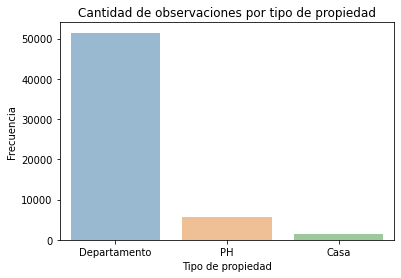

In [1655]:
#Tipo de Propiedad
prop_type_data = prop_caba_data['property_type'].value_counts()


sns_bar_plot=sns.barplot(x=prop_type_data.index.tolist(), y=prop_type_data.tolist() ,alpha=0.5).set(title="Cantidad de observaciones por tipo de propiedad",
                                                                      xlabel='Tipo de propiedad',
                                                                      ylabel='Frecuencia')

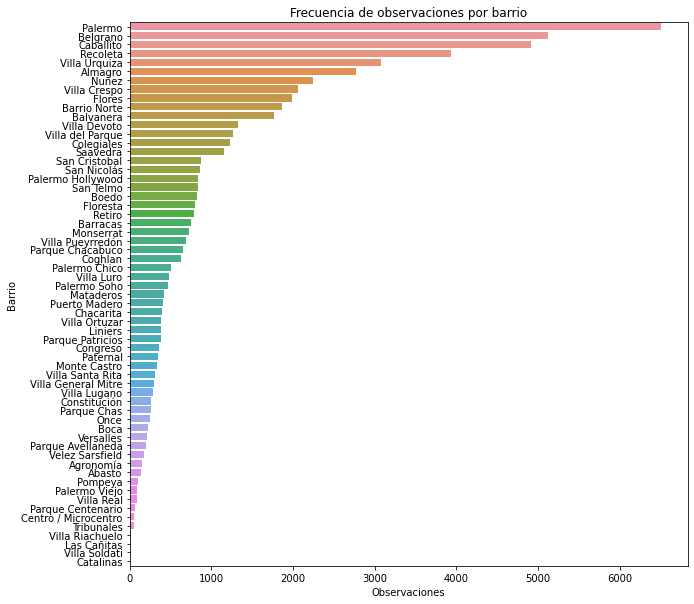

In [1656]:
# Barrio
barrio_data = prop_caba_data['place_l3'].value_counts()
barrios = barrio_data.index.tolist()

plt.figure(figsize = (10,10))
sns_bar_plot=sns.barplot(x=barrio_data.tolist(), y=barrios , orient="h").set(title="Frecuencia de observaciones por barrio",
                                                                      xlabel='Observaciones',
                                                                      ylabel='Barrio')

### Correlaciones

A continuación se realiza un análisis de correlaciones entre las variables del Dataset de propiedades filtrado. Para ello se utiliza un mapa de calor de correlación, este tipo de gráfico visualiza la fuerza de las relaciones entre variables numéricas, y se utiliza para comprender qué variables están relacionadas entre sí y la fuerza de esta relación.

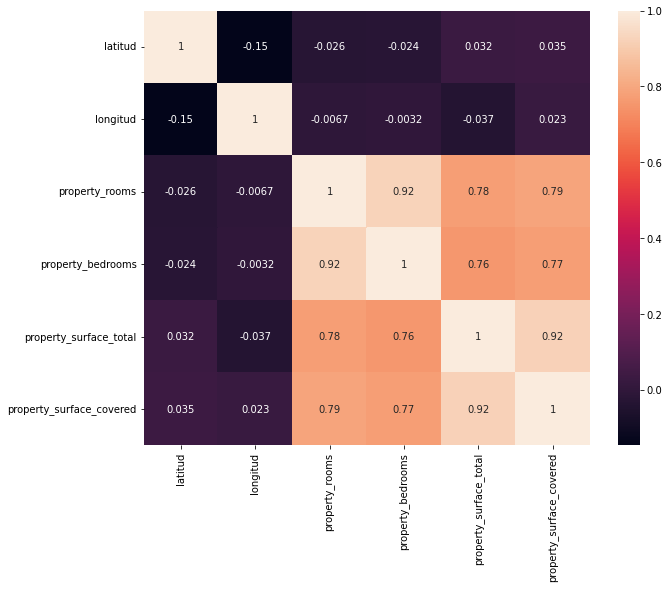

In [1657]:
if not quick_exec:
  plt.figure(figsize = (10,8))
  corr = prop_caba_data.corr()
  sns.heatmap(corr, annot=True)


Se puede apreciar en el gráfico que las variables más correlacionadas son 'property_rooms' con 'property_bedrooms' y 'property_surface_total' con 'property_surface_covered', estas correlaciónes son prácticamente lineales.

##**d) Reducción de la dimensionalidad:**

En este inciso se realizará un análisis de componentes principales, es decir, un procedimiento matemático por el cual se transforma un conjunto de variables correlacionadas en un conjunto de variables no correlacionadas de menor dimensión. Estas nuevas variables se obtienen a partir de combinaciones lineales de las variables originales, y son las que se denominan Componentes Principales.

Esta técnica intenta hallar aquellas combinaciones lineales de las variables originales que maximizan la varianza (minimizan la pérdida de información original).

Tiene sentido aplicar esta técnica para el dataset de propiedades, debido a que las variables originales están correlacionadas.

El objetivo es reducir la dimensión del problema, es decir, descartar la información redundante.

In [1670]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA

Se seleccionan columnas que tienen buena correlación para realizar el PCA.

Se crea un modelo a partir del set train.

In [1671]:
# elegir columnas y escalar
columnas_elegidas =  ['property_rooms', 'property_bedrooms', 'property_surface_total', 'property_surface_covered', 'latitud', 'longitud']

x = prop_caba_data.loc[:, columnas_elegidas].values
std_scale_pca = StandardScaler()
x = std_scale_pca.fit_transform(x)

# crear modelo
pca_comp_number = x.shape[1]
pca = PCA(n_components=pca_comp_number)

# fit y convertir en dataframe
x_transformation = pca.fit_transform(x)
pca_df_aux = pd.DataFrame(data = x_transformation
             , columns = ['cp_'+str(i) for i in range(0, x.shape[1])])
pca_df_aux.index = prop_caba_data.place_l3.index

Graficamos la varianza explicada de cada componente:

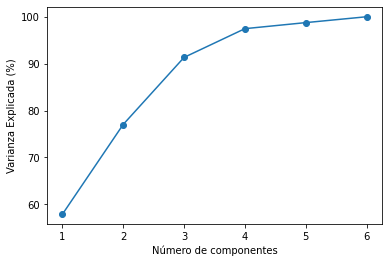

In [1672]:
varianza_explicada = pca.explained_variance_ratio_

# Grafico varianza explicada y cantidad de componentes principales
if not quick_exec:
  list_x = list(range(1, len(varianza_explicada)+1))
  plt.figure(figsize=(6, 4))
  plt.plot(list_x, varianza_explicada.cumsum() * 100, '-o')
  plt.xlabel(r'Número de componentes')
  plt.ylabel('Varianza Explicada (%)')
  plt.show()

### Replicar para test

In [1673]:
# elegir columnas y escalar
x = prop_caba_test.loc[:, columnas_elegidas].values
x_transformation = std_scale_pca.transform(x)

# aplicar pca entrenado
pca.transform(x)
pca_df_test = pd.DataFrame(data = x_transformation
             , columns = ['cp_'+str(i) for i in range(0, x.shape[1])])
pca_df_test.index = prop_caba_test.place_l3.index

### Gráficos

In [1674]:
#concatenar tipo para graficos
color = test_target.filter(pca_df_test.index)
df_pca = pd.concat([pca_df_test, color], axis = 1)
df_pca.columns= list(pca_df_test.columns) + [color.name]
df_pca.head()

,cp_0,cp_1,cp_2,cp_3,cp_4,cp_5,property_price
352750,0.26,0.22,-0.27,-0.05,1.49,-0.62,"150,000.00"
94517,0.26,0.22,-0.43,-0.44,1.45,-0.50,"156,000.00"
65779,0.26,0.22,-0.14,-0.10,1.40,-0.85,"193,000.00"
179714,-1.42,-0.89,-0.98,-0.92,-0.29,0.33,"68,500.00"
171352,0.26,0.22,0.14,-0.02,-2.16,-2.03,"180,000.00"


Graficamos los componentes principales para ver cómo se distribuyen

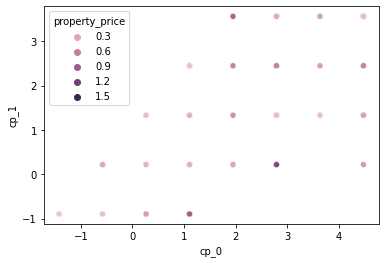

In [1675]:
if not quick_exec:
  sns.scatterplot(data=df_pca, x="cp_0", y="cp_1", hue="property_price")

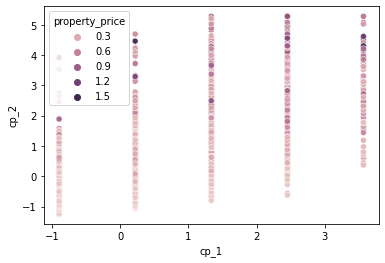

In [1676]:
if not quick_exec:
  sns.scatterplot(data=df_pca, x="cp_1", y="cp_2", hue="property_price")

Analicemos la composición de cada componente principal:

In [1677]:
pca_vectors = pd.DataFrame(pca.components_, columns = columnas_elegidas)

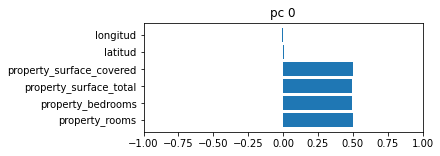

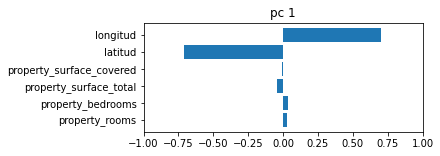

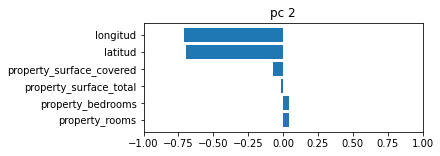

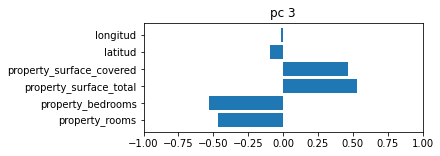

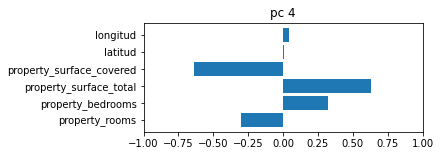

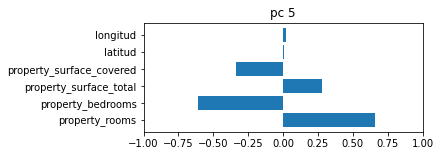

In [1678]:
if not quick_exec:
  for i in range(0, len(columnas_elegidas)):
    plt.figure(figsize=(5,2))
    plt.barh(y=columnas_elegidas, width=pca_vectors.iloc[i])
    plt.xlim((-1,1))
    plt.title("pc "+str(i))

Se ve que el componente principal crece junto con las superficies y las habitaciones/ambientes. Indica que corresponden a la mayor varianza.

### Se guarda el data frame resultante de realizar la reducción de dimensión:

Se decide entonces utilizar las tres primeras componentes, debido a  que éstas explican aproximadamente el 90% de la varianza. Logrando de este modo reducir la dimensionalidad.

In [1679]:
df_PCA_train = pd.concat([pca_df_aux.loc[:, ['cp_0', 'cp_1', 'cp_2']], prop_caba_data.loc[:, ['property_type', 'place_l3']], train_target], axis=1 )
df_PCA_train

,cp_0,cp_1,cp_2,property_type,place_l3,property_price
100248,7.69,0.73,1.46,Casa,Flores,"245,000.00"
1472,-0.20,1.76,-0.73,PH,San Telmo,"90,000.00"
117479,3.79,0.58,0.02,Departamento,Almagro,"450,000.00"
79144,-1.23,2.41,-0.22,Departamento,Barracas,"125,000.00"
108699,2.10,1.23,-0.41,Departamento,Congreso,"269,000.00"
...,...,...,...,...,...,...
290962,-2.08,0.12,0.61,Departamento,Villa Crespo,"78,000.00"
105889,-2.30,0.27,-1.03,Departamento,Palermo Chico,"65,000.00"
136266,-1.53,0.49,0.20,Departamento,Caballito,"82,000.00"
20953,0.08,0.80,-0.90,Departamento,Recoleta,"140,000.00"


In [1680]:
df_PCA_test = pd.concat([pca_df_test.loc[:, ['cp_0', 'cp_1', 'cp_2']], prop_caba_test.loc[:, ['property_type', 'place_l3']], test_target], axis=1 )
df_PCA_test

,cp_0,cp_1,cp_2,property_type,place_l3,property_price
352750,0.26,0.22,-0.27,Departamento,Belgrano,"150,000.00"
94517,0.26,0.22,-0.43,Departamento,Belgrano,"156,000.00"
65779,0.26,0.22,-0.14,Departamento,Villa Urquiza,"193,000.00"
179714,-1.42,-0.89,-0.98,Departamento,Almagro,"68,500.00"
171352,0.26,0.22,0.14,PH,Mataderos,"180,000.00"
...,...,...,...,...,...,...
419168,1.95,1.34,1.93,PH,Parque Chas,"465,000.00"
339511,-0.58,-0.89,-0.80,Departamento,Palermo,"118,000.00"
187160,0.26,-0.89,0.62,Departamento,Palermo Hollywood,"395,000.00"
30008,-0.58,-0.89,-0.51,Departamento,Coghlan,"116,000.00"


In [1681]:
try:
  df_PCA_train.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_PCA_train.csv', index_label="index")
  df_PCA_test.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_PCA_test.csv', index_label="index")
except:
  df_PCA_train.to_csv('df_PCA_train.csv', index_label="index")
  df_PCA_test.to_csv('df_PCA_test.csv', index_label="index")

# Encoding

In [1682]:
prop_caba_data['place_l3'].value_counts()

Palermo            6507
Belgrano           5125
Caballito          4912
Recoleta           3934
Villa Urquiza      3073
                   ... 
Tribunales           49
Villa Riachuelo      13
Las Cañitas           7
Villa Soldati         7
Catalinas             1
Name: place_l3, Length: 61, dtype: int64

Consideramos que son demasiados barrios como para aplicar One Hot Encoding a 'place_l3' (resultaría en al rededor de 61 columnas nuevas), por lo que se decide agrupar los barrios en Comunas.

In [1683]:
comuna = {}
comuna[1] = ['Retiro', 'San Nicolás', 'Puerto Madero', 'San Telmo', 'Montserrat', 'Monserrat', 'Constitución', 'Tribunales', 'Centro / Microcentro', 'Catalinas']
comuna[2] = ['Recoleta', 'Barrio Norte']
comuna[3] = ['Balvanera', 'San Cristóbal', 'San Cristobal', 'Once', 'Congreso', 'Abasto']
comuna[4] = ['La Boca', 'Boca', 'Barracas', 'Parque Patricios', 'Nueva Pompeya', 'Pompeya']
comuna[5] = ['Almagro', 'Boedo']
comuna[6] = ['Caballito', 'Parque Centenario']
comuna[7] = ['Flores', 'Parque Chacabuco']
comuna[8] = ['Villa Soldati', 'Villa Riachuelo', 'Villa Lugano']
comuna[9] = ['Liniers', 'Mataderos', 'Parque Avellaneda']
comuna[10] = ['Villa Real', 'Monte Castro', 'Versalles', 'Floresta', 'Vélez Sarsfield', 'Velez Sarsfield', 'Villa Luro']
comuna[11] = ['Villa General Mitre', 'Villa Devoto', 'Villa del Parque', 'Villa Santa Rita']
comuna[12] = ['Coghlan', 'Saavedra', 'Villa Urquiza', 'Villa Pueyrredón']
comuna[13] = ['Núñez', 'Nuñez', 'Belgrano', 'Colegiales']
comuna[14] = ['Palermo', 'Palermo Hollywood', 'Palermo Chico', 'Palermo Soho', 'Palermo Viejo', 'Las Cañitas']
comuna[15] = ['Chacarita', 'Villa Crespo', 'La Paternal', 'Paternal', 'Villa Ortúzar', 'Villa Ortuzar', 'Agronomía', 'Parque Chas']

In [1684]:
def numero_comuna(barrio):
  for i in range(1, len(comuna.keys()) + 1):
     if barrio in comuna[i]:
        return i
  return 0

prop_caba_data['comuna'] = prop_caba_data['place_l3'].apply(numero_comuna)

In [1685]:
prop_caba_data.loc[:, ['place_l3', 'comuna']].sample(n = 5)

,place_l3,comuna
430324,Barrio Norte,2
357129,Caballito,6
242142,Retiro,1
304859,Parque Chacabuco,7
96549,Recoleta,2


Se verifica que todas las propiedades fueron asignadas a una Comuna válida (comuna 0 no existe):

In [1686]:
prop_caba_data.loc[prop_caba_data.comuna == 0]

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna


Se aplica entonces One Hot Encoding a 'property_type' y a 'comuna':

In [1687]:
df_encoded = pd.get_dummies(prop_caba_data, columns=['comuna', 'property_type'], drop_first=True)

In [1688]:
df_encoded = pd.concat([df_encoded, train_target], axis=1)
df_encoded_train = df_encoded.drop(['place_l3'], axis=1)

In [1689]:
df_encoded_train

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna_2,comuna_3,comuna_4,comuna_5,...,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,property_price
100248,-34.64,-58.46,7.00,5.00,260.00,260.00,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"245,000.00"
1472,-34.61,-58.37,3.00,2.00,68.00,40.00,0,0,0,0,...,0,0,0,0,0,0,0,0,1,"90,000.00"
117479,-34.61,-58.43,4.00,3.00,210.00,175.00,0,0,0,1,...,0,0,0,0,0,0,0,1,0,"450,000.00"
79144,-34.64,-58.37,2.00,1.00,53.00,48.00,0,0,1,0,...,0,0,0,0,0,0,0,1,0,"125,000.00"
108699,-34.61,-58.40,4.00,3.00,124.00,104.00,0,1,0,0,...,0,0,0,0,0,0,0,1,0,"269,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290962,-34.61,-58.45,1.00,1.00,32.00,29.00,0,0,0,0,...,0,0,0,0,0,0,1,1,0,"78,000.00"
105889,-34.58,-58.40,1.00,1.00,20.00,20.00,0,0,0,0,...,0,0,0,0,0,1,0,1,0,"65,000.00"
136266,-34.61,-58.43,2.00,1.00,36.00,36.00,0,0,0,0,...,0,0,0,0,0,0,0,1,0,"82,000.00"
20953,-34.59,-58.39,3.00,2.00,65.00,65.00,1,0,0,0,...,0,0,0,0,0,0,0,1,0,"140,000.00"


Se replica el encoding para test

In [1690]:
prop_caba_test['comuna'] = prop_caba_test['place_l3'].apply(numero_comuna)

Se verifica que todas las propiedades fueron asignadas a una Comuna válida (comuna 0 no existe):

In [1691]:
prop_caba_test.loc[prop_caba_test.comuna == 0]

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna


Se aplica entinces One Hot Encoding a 'property_type' y a 'comuna':

In [1692]:
df_encoded = pd.get_dummies(prop_caba_test, columns=['comuna', 'property_type'], drop_first=True)

In [1693]:
df_encoded = pd.concat([df_encoded, test_target], axis=1)
df_encoded_test = df_encoded.drop(['place_l3'], axis=1)

In [1694]:
df_encoded_test

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna_2,comuna_3,comuna_4,comuna_5,...,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,property_price
352750,-34.56,-58.46,3.00,2.00,65.00,65.00,0,0,0,0,...,0,0,0,0,1,0,0,1,0,"150,000.00"
94517,-34.56,-58.46,3.00,2.00,57.00,49.00,0,0,0,0,...,0,0,0,0,1,0,0,1,0,"156,000.00"
65779,-34.56,-58.47,3.00,2.00,72.00,63.00,0,0,0,0,...,0,0,0,1,0,0,0,1,0,"193,000.00"
179714,-34.60,-58.43,1.00,1.00,29.00,29.00,0,0,0,1,...,0,0,0,0,0,0,0,1,0,"68,500.00"
171352,-34.65,-58.52,3.00,2.00,86.00,66.00,0,0,0,0,...,1,0,0,0,0,0,0,0,1,"180,000.00"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419168,-34.59,-58.48,5.00,3.00,178.00,178.00,0,0,0,0,...,0,0,0,0,0,0,1,0,1,"465,000.00"
339511,-34.58,-58.43,2.00,1.00,38.00,35.00,0,0,0,0,...,0,0,0,0,0,1,0,1,0,"118,000.00"
187160,-34.58,-58.44,3.00,1.00,111.00,111.00,0,0,0,0,...,0,0,0,0,0,1,0,1,0,"395,000.00"
30008,-34.56,-58.47,2.00,1.00,53.00,47.00,0,0,0,0,...,0,0,0,1,0,0,0,1,0,"116,000.00"


Encoding para el data set resutante de realizar la reducción de dimensionalidad

In [1695]:
df_encoded = pd.get_dummies(prop_caba_data, columns=['comuna', 'property_type'], drop_first=True)
df_PCA_ENCODED_train = pd.concat([df_PCA_train, df_encoded] ,axis = 1)
df_PCA_ENCODED_train = df_PCA_ENCODED_train.drop(['place_l3', 'property_type', 'property_rooms', 'property_bedrooms', 'property_surface_total', 'property_surface_covered', 'latitud', 'longitud'], axis=1)
df_PCA_ENCODED_train

,cp_0,cp_1,cp_2,property_price,comuna_2,comuna_3,comuna_4,comuna_5,comuna_6,comuna_7,comuna_8,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH
100248,7.69,0.73,1.46,"245,000.00",0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1472,-0.20,1.76,-0.73,"90,000.00",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
117479,3.79,0.58,0.02,"450,000.00",0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
79144,-1.23,2.41,-0.22,"125,000.00",0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
108699,2.10,1.23,-0.41,"269,000.00",0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290962,-2.08,0.12,0.61,"78,000.00",0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0
105889,-2.30,0.27,-1.03,"65,000.00",0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
136266,-1.53,0.49,0.20,"82,000.00",0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
20953,0.08,0.80,-0.90,"140,000.00",1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [1696]:
df_encoded = pd.get_dummies(prop_caba_test, columns=['comuna', 'property_type'], drop_first=True)
df_PCA_ENCODED_test = pd.concat([df_PCA_test, df_encoded] ,axis = 1)
df_PCA_ENCODED_test = df_PCA_ENCODED_test.drop(['place_l3', 'property_type', 'property_rooms', 'property_bedrooms', 'property_surface_total', 'property_surface_covered', 'latitud', 'longitud'], axis=1)
df_PCA_ENCODED_test

,cp_0,cp_1,cp_2,property_price,comuna_2,comuna_3,comuna_4,comuna_5,comuna_6,comuna_7,comuna_8,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH
352750,0.26,0.22,-0.27,"150,000.00",0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
94517,0.26,0.22,-0.43,"156,000.00",0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
65779,0.26,0.22,-0.14,"193,000.00",0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
179714,-1.42,-0.89,-0.98,"68,500.00",0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
171352,0.26,0.22,0.14,"180,000.00",0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419168,1.95,1.34,1.93,"465,000.00",0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
339511,-0.58,-0.89,-0.80,"118,000.00",0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
187160,0.26,-0.89,0.62,"395,000.00",0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
30008,-0.58,-0.89,-0.51,"116,000.00",0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0


## Se guardan los conjuntos de datos obtenidos luego de realizar el Encoding:

In [1697]:
try:
  df_encoded_train.to_csv('drive/My Drive/tp1 datos grupal/Datasets/prop_caba_encoded_train.csv', index_label="index")
  df_encoded_test.to_csv('drive/My Drive/tp1 datos grupal/Datasets/prop_caba_encoded_test.csv', index_label="index")
except:
  df_encoded_train.to_csv('prop_caba_encoded_train.csv', index_label="index")
  df_encoded_test.to_csv('prop_caba_encoded_test.csv', index_label="index")

In [1698]:
try:
  df_PCA_ENCODED_train.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_PCA_ENCODED_train.csv', index_label="index")
  df_PCA_ENCODED_test.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_PCA_ENCODED_test.csv', index_label="index")
except:
  df_PCA_ENCODED_train.to_csv('df_PCA_ENCODED_train.csv', index_label="index")
  df_PCA_ENCODED_test.to_csv('df_PCA_ENCODED_test.csv', index_label="index")

# Modelos

Se crean Datasets con el target, los mismos se utilizan a lo largo de la realización del TP.

In [1699]:
with_target = pd.concat([prop_caba_data, train_target], axis = 1)
with_target_test = pd.concat([prop_caba_test, test_target], axis = 1)

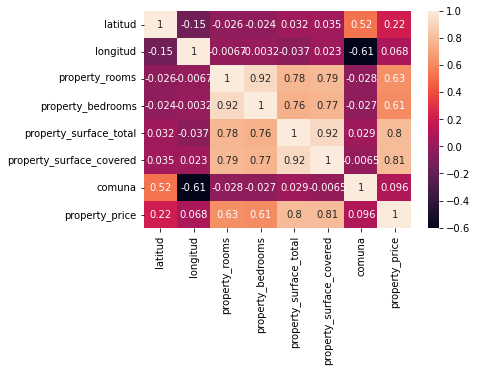

In [1700]:
corr_train = with_target.corr()
sns.heatmap(corr_train, annot=True)

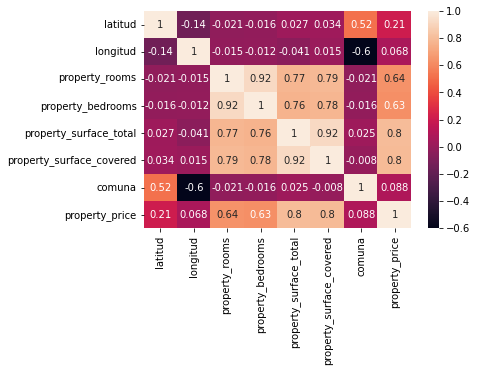

In [1701]:
corr_test = with_target_test.corr()
sns.heatmap(corr_test, annot=True)

#**2. Agrupamiento**

Seleccionamos las variables no categóricas (group cols) y solo usamos esas para el análisis no supervisado, ademas del target.

In [1828]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.cluster import KMeans
from pyclustertend import hopkins

In [1829]:
prop_caba_data.columns

Index(['latitud', 'longitud', 'place_l3', 'property_type', 'property_rooms',
       'property_bedrooms', 'property_surface_total',
       'property_surface_covered', 'comuna'],
      dtype='object')

In [1830]:
group_cols = ['latitud', 'longitud', 'property_rooms', 'property_bedrooms', 'property_surface_total', 'property_surface_covered'] 
pos = pd.concat([prop_caba_data[group_cols], train_target], axis = 1)
pos = pos.values
#pos = MinMaxScaler().fit_transform(pos) OBS: ESCALANDO SE OBTIENEN MALOS RESULTADOS
pos.shape

(58682, 7)

In [1831]:
pos = pd.DataFrame(pos, index=df_encoded_train.index,columns=group_cols + [train_target.name])

In [1832]:
pos.columns

Index(['latitud', 'longitud', 'property_rooms', 'property_bedrooms',
       'property_surface_total', 'property_surface_covered', 'property_price'],
      dtype='object')

## Tendencia al agrupamiento

A continuación se calcula la estadística de Hopkins, una prueba estadística que permite predecir si los datos siguen una distribución uniforme. Si la prueba es positiva (un puntaje de hopkins que tiende a 0) significa que los datos no están distribuidos uniformemente. Por lo tanto, la agrupación puede ser útil para clasificar las observaciones.

In [1833]:
hopkins(pos,10000)

0.0029321150848316607

El valor obtenido para la estadística de Hopkings es cercano a 0, lo que indica que los datos tienen más tendencia al clustering.

## Estimar cantidad de clusters

### Método de Elbow

El método de Elbow consiste básicamente en verificar la evolución de la suma de los cuadrados del error para varias cantidades de clusters y verificar cual es el que brinda un mejor agrupamiento

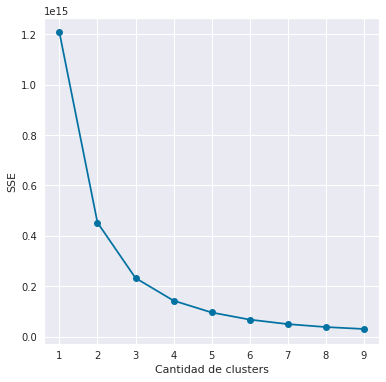

In [1834]:
# Corro el algoritmo con K entre 2 y 10 y voy guardando el error para luego graficarlo.
sse = []
list_k = list(range(1, 10))

for k in list_k:
    km = KMeans(n_clusters=k)
    km.fit(pos)
    sse.append(km.inertia_)

# Grafico el SSE por K
plt.figure(figsize=(6, 6))
plt.plot(list_k, sse, '-o')
plt.xlabel(r'Cantidad de clusters')
plt.ylabel('SSE')
plt.show()

 Si bien no se distingue un nodo en el que claramente se 'quiebre' la pendiente, se puede tomar k = 4 como cantidad de clusters debido a que para k mayores la inercia tiene una pendiente que va disminuyendo cada vez en menor medida.

### Método de Silhouette para determinar el mejor k 

In [1835]:
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.metrics import silhouette_score

In [1836]:
if quick_exec: sample = 100
else: sample = 1000
sil_dataset = pos.sample(sample, random_state=0)
best_score = 0
for n_clusters in range(2,10,1):
    clusterer = KMeans(n_clusters=n_clusters)
    clusterer.fit(sil_dataset)
    preds = clusterer.predict(sil_dataset)
    score = silhouette_score (sil_dataset, preds)
    print ("For n_clusters =" + str(n_clusters) + " silhouette score is " + str(score))
    if(score > best_score):
      best_score = score
      best_model = clusterer


For n_clusters =2 silhouette score is 0.762051029979465
For n_clusters =3 silhouette score is 0.6568541566494553
For n_clusters =4 silhouette score is 0.5876709472259072
For n_clusters =5 silhouette score is 0.5922662977812492
For n_clusters =6 silhouette score is 0.569099651481637
For n_clusters =7 silhouette score is 0.5552751151859209
For n_clusters =8 silhouette score is 0.5599080453941678
For n_clusters =9 silhouette score is 0.5651254414807749


In [1837]:
best_score

0.762051029979465

## Análisis de Silhouette

In [1838]:
visualizer = SilhouetteVisualizer(best_model, colors='yellowbrick')    # Instancio el visualizador

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names



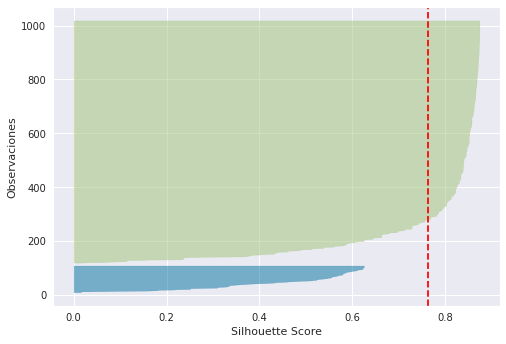

In [1839]:
visualizer.fit(sil_dataset)
plt.xlabel("Silhouette Score")
plt.ylabel("Observaciones")
plt.show()

In [1840]:
visualizer.silhouette_score_

0.762051029979465

El valor de la silueta es una medida de cuán similar es un objeto a su propio cúmulo (cohesión) en comparación con otros cúmulos (separación). 

La silueta va de -1 a +1, por lo que el valor obtenido se considera 'alto', y esto indica que los objetos están bien emparejados con su propio cúmulo y mal emparejados con los cúmulos vecinos.

## Gráficos
Grafiquemos las características para verificar la composición de los grupos.

In [1841]:
y_kmeans = best_model.predict(pos)

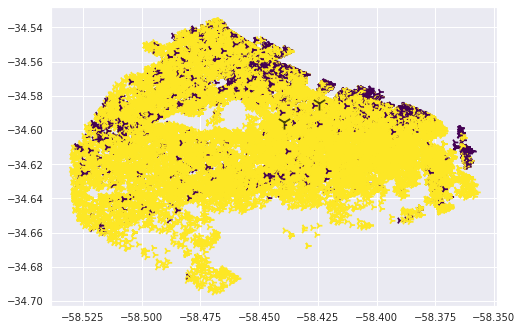

In [1842]:
plt.scatter(pos.iloc[:,1],pos.iloc[:,0], c=y_kmeans, s=50, cmap='viridis', marker='4')
centers = best_model.cluster_centers_
plt.scatter(centers[:,1], centers[:,0], c='black', s=200, alpha=0.7,marker='1')
plt.show()

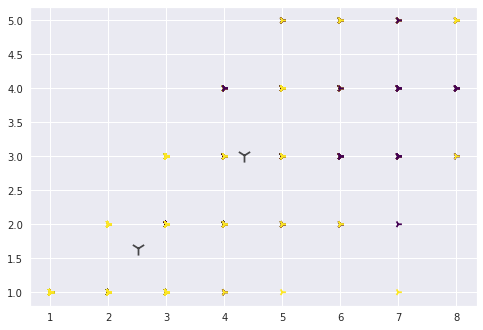

In [1843]:
plt.scatter(pos.iloc[:,2],pos.iloc[:,3], c=y_kmeans, s=50, cmap='viridis', marker='4')
centers = best_model.cluster_centers_
plt.scatter(centers[:,2], centers[:,3], c='black', s=200, alpha=0.7,marker='1')
plt.show()

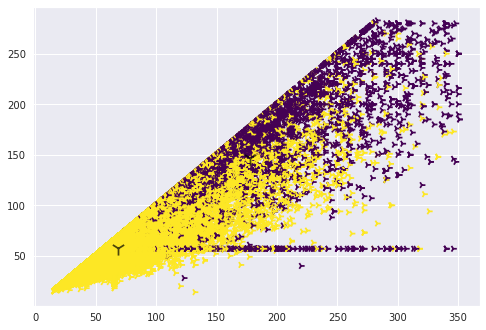

In [1844]:
if not quick_exec:
  plt.scatter(pos.iloc[:,4],pos.iloc[:,5], c=y_kmeans, s=50, cmap='viridis', marker='4')
  centers = best_model.cluster_centers_
  plt.scatter(centers[:,4], centers[:,5], c='black', s=200, alpha=0.7,marker='1')
  plt.show()

<class 'matplotlib.axes._subplots.Axes3DSubplot'>


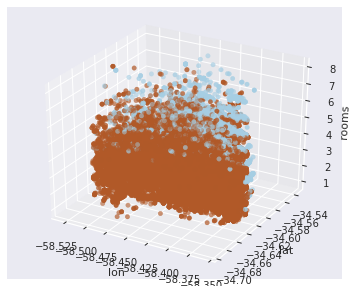

In [1845]:
sns.set_style("darkgrid")

x1 = pos['longitud']
y1 = pos['latitud']
z1 = pos['property_rooms']

plt.figure(figsize=(6,5))
axes = plt.axes(projection='3d')
print(type(axes))
axes.scatter3D(x1,y1,z1, c= y_kmeans, cmap = plt.get_cmap('Paired'))

axes.set_xlabel('lon')
axes.set_ylabel('lat')
axes.set_zlabel('rooms')
plt.show()

## Análisis de los grupos

In [1846]:
prop_caba_data[y_kmeans == 0].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna
count,"5,763.00","5,763.00","5,763.00","5,763.00","5,763.00","5,763.00","5,763.00"
mean,-34.58,-58.43,4.29,3.01,177.08,147.02,9.31
std,0.02,0.04,1.01,0.76,60.42,53.68,5.21
min,-34.69,-58.53,1.00,1.00,67.00,28.00,1.00
25%,-34.59,-58.45,4.00,3.00,130.00,109.00,2.00
50%,-34.58,-58.43,4.00,3.00,166.00,140.00,13.00
75%,-34.57,-58.40,5.00,3.00,213.00,183.00,14.00
max,-34.54,-58.36,8.00,5.00,351.00,283.00,15.00


In [1847]:
prop_caba_data[y_kmeans == 1].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna
count,"52,919.00","52,919.00","52,919.00","52,919.00","52,919.00","52,919.00","52,919.00"
mean,-34.60,-58.44,2.51,1.67,68.37,58.31,8.74
std,0.03,0.04,1.07,0.81,36.92,28.54,4.75
min,-34.69,-58.53,1.00,1.00,15.00,14.00,1.00
25%,-34.62,-58.47,2.00,1.00,43.00,38.00,5.00
50%,-34.60,-58.44,2.00,1.00,60.00,51.00,10.00
75%,-34.58,-58.41,3.00,2.00,81.00,70.00,13.00
max,-34.54,-58.36,8.00,5.00,346.00,280.00,15.00


In [1848]:
prop_caba_data[y_kmeans == 2].describe()

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna
count,0.00,0.00,0.00,0.00,0.00,0.00,0.00
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Gráfico mapa

In [1849]:
if not quick_exec:
  pos.insert(0,'group',y_kmeans)
  pos["group"] = pos["group"].astype(str)
  fig = px.scatter_geo(data_frame=pos, lat='latitud', lon='longitud', fitbounds='locations',color='group')
  fig.show()
  pos = pos.drop('group', axis=1)

## Repetir análisis con 3 clusters

In [1850]:
best_model = KMeans(n_clusters = 3)

In [1851]:
best_model.fit(pos)

KMeans(n_clusters=3)

## Análisis de Silhouette

In [1852]:
visualizer = SilhouetteVisualizer(best_model, colors='yellowbrick')    # Instancio el visualizador

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names



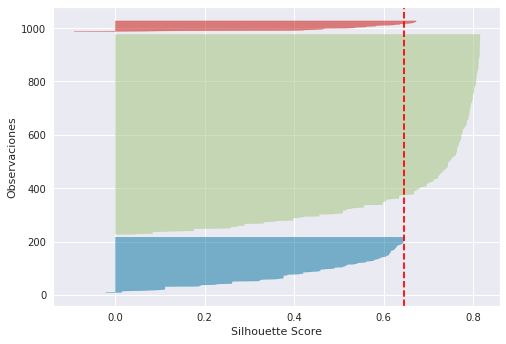

In [1853]:
visualizer.fit(sil_dataset)
plt.xlabel("Silhouette Score")
plt.ylabel("Observaciones")
plt.show()

In [1854]:
visualizer.silhouette_score_

0.6461022505426063

## Gráficos
Grafiquemos las características para verificar la composición de los grupos.

In [1855]:
y_kmeans = best_model.predict(pos)

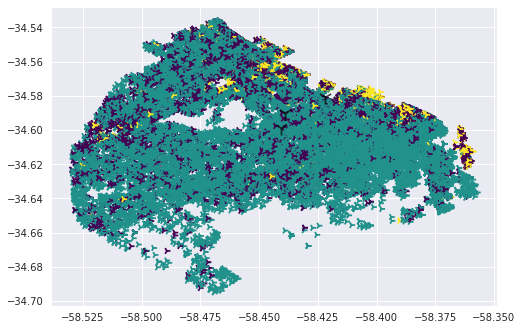

In [1856]:
plt.scatter(pos.iloc[:,1],pos.iloc[:,0], c=y_kmeans, s=50, cmap='viridis', marker='4')
centers = best_model.cluster_centers_
plt.scatter(centers[:,1], centers[:,0], c='black', s=200, alpha=0.7,marker='1')
plt.show()

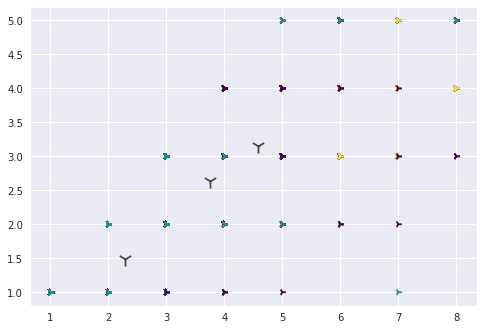

In [1857]:
plt.scatter(pos.iloc[:,2],pos.iloc[:,3], c=y_kmeans, s=50, cmap='viridis', marker='4')
centers = best_model.cluster_centers_
plt.scatter(centers[:,2], centers[:,3], c='black', s=200, alpha=0.7,marker='1')
plt.show()

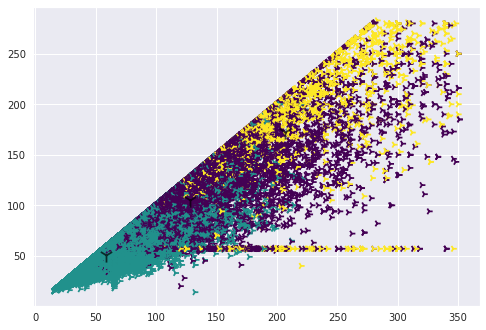

In [1858]:
plt.scatter(pos.iloc[:,4],pos.iloc[:,5], c=y_kmeans, s=50, cmap='viridis', marker='4')
centers = best_model.cluster_centers_
plt.scatter(centers[:,4], centers[:,5], c='black', s=200, alpha=0.7,marker='1')
plt.show()

<class 'matplotlib.axes._subplots.Axes3DSubplot'>


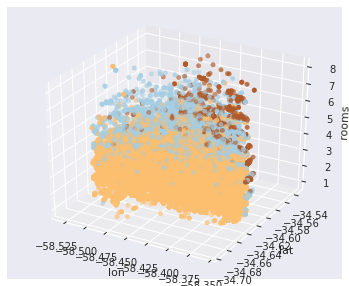

In [1859]:
if not quick_exec:
  sns.set_style("darkgrid")

  x1 = pos['longitud']
  y1 = pos['latitud']
  z1 = pos['property_rooms']

  plt.figure(figsize=(6,5))
  axes = plt.axes(projection='3d')
  print(type(axes))
  axes.scatter3D(x1,y1,z1, c= y_kmeans, cmap = plt.get_cmap('Paired'))

  axes.set_xlabel('lon')
  axes.set_ylabel('lat')
  axes.set_zlabel('rooms')
  plt.show()

### Gráfico mapa

In [1860]:
pos.insert(0,'group',y_kmeans)
pos["group"] = pos["group"].astype(str)
fig = px.scatter_geo(data_frame=pos, lat='latitud', lon='longitud', fitbounds='locations',color='group')
fig.show()
pos = pos.drop('group', axis=1)

#**3. Clasificación**

##a) Construcción del target
Para esta tarea se debe crear una nueva variable tipo_precio que tendrá tres categorías:
alto, medio, bajo. Esta nueva variable será nuestra clase en el problema de clasificación.
Para determinar cuándo el tipo_precio de una propiedad es alto, medio o bajo se deberá
analizar el precio por metro cuadrado (pxm2). Se propone evaluar las siguientes
alternativas para establecer los límites de cada categoría:

In [1884]:
algorithm_pmx2 = lambda row: (row.property_price / row.property_surface_total)
pmx2 = with_target.apply(algorithm_pmx2, axis=1)
pmx2_test = with_target_test.apply(algorithm_pmx2, axis=1)

In [1885]:
prop_caba_data['pxm2'] = pmx2.filter(prop_caba_data.index)
prop_caba_test['pxm2'] = pmx2_test.filter(prop_caba_test.index)

In [1886]:
prop_caba_data.loc[:, ['property_surface_total', 'pxm2']].head()

,property_surface_total,pxm2
100248,260.00,942.31
1472,68.00,"1,323.53"
117479,210.00,"2,142.86"
79144,53.00,"2,358.49"
108699,124.00,"2,169.35"


#### 1. Dividir la variable pxm2 en 3 intervalos con igual cantidad de observaciones.

In [1887]:
#Método para dividir en q cuantiles
def quantile_cut(_row, q, labels=['Bajo', 'Medio', 'Alto']):
  return pd.qcut(_row, q, labels=labels, retbins=True, precision = 5)

In [1888]:
prop_caba_data['tipo_precio'], bins = quantile_cut(prop_caba_data['pxm2'], 3)
prop_caba_data.loc[:, ['property_type', 'pxm2', 'tipo_precio']].sample(n=5)

,property_type,pxm2,tipo_precio
136211,Departamento,"2,822.58",Alto
80641,Departamento,"3,714.29",Alto
404700,Departamento,"2,727.27",Alto
115404,Departamento,"2,894.74",Alto
144389,Departamento,"2,292.31",Medio


Verifico cuantos valores cayeron en cada sección

In [1889]:
prop_caba_data['tipo_precio'].value_counts().sort_index()

Bajo     19564
Medio    19557
Alto     19561
Name: tipo_precio, dtype: int64

**● Mostrar la distribución del precio por metro cuadrado**

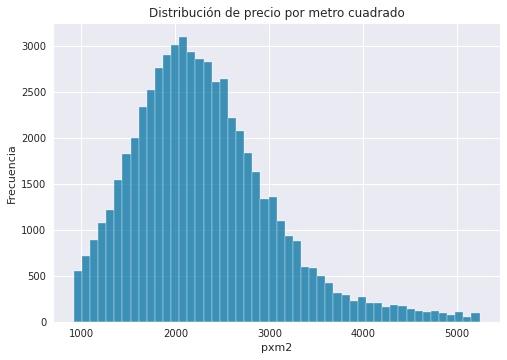

In [1890]:
sns_hist=sns.histplot(data=prop_caba_data['pxm2'], bins = 50).set(title="Distribución de precio por metro cuadrado",xlabel="pxm2",ylabel="Frecuencia")

**● Mostrar la distribución del precio por metro cuadrado por tipo de propiedad:**

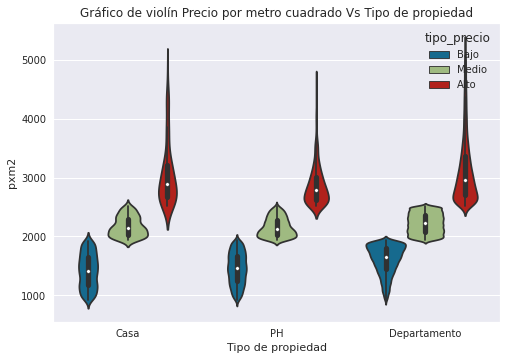

In [1891]:
ax = sns.violinplot(y="pxm2", x="property_type", data=prop_caba_data, hue='tipo_precio').set(title="Gráfico de violín Precio por metro cuadrado Vs Tipo de propiedad",xlabel='Tipo de propiedad',ylabel='pxm2') 

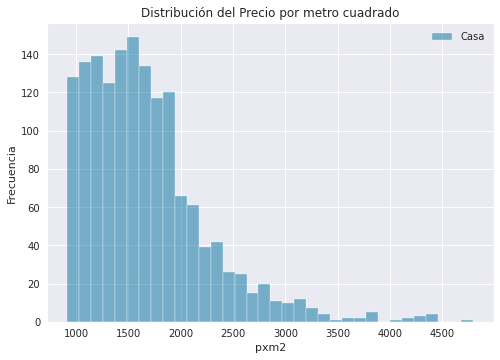

In [1892]:
pxm2_casa = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'Casa', ['pxm2']], label='Casa').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

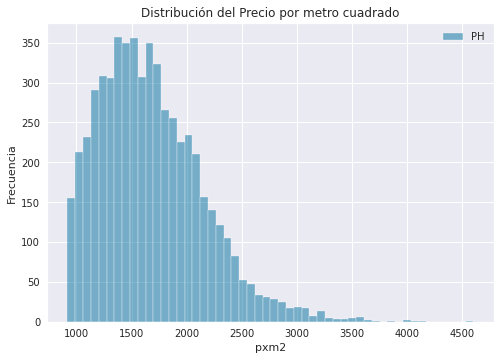

In [1893]:
pxm2_PH = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'PH', ['pxm2']], label='PH').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

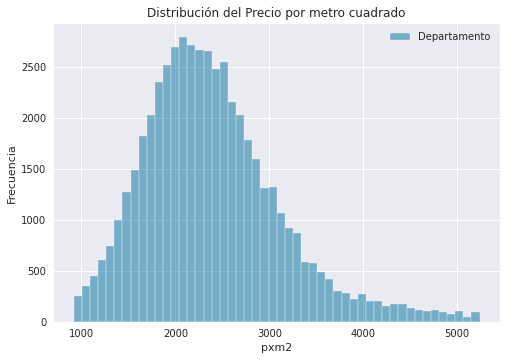

In [1894]:
pxm2_Departamento = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'Departamento', ['pxm2']], bins = 50, label='Departamento').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

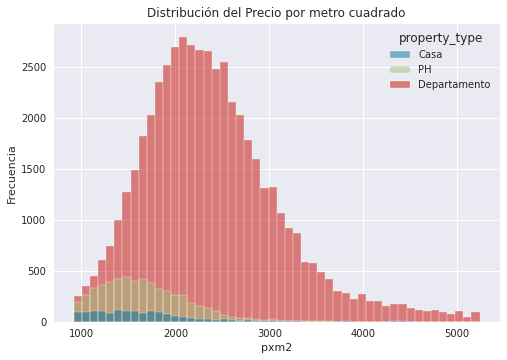

In [1895]:
pxm2_casa = sns.histplot(data=prop_caba_data, x='pxm2', hue='property_type', bins = 50).set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 

 **● Mostrar gráficamente la distribución de la nueva variable creada tipo_precio:**

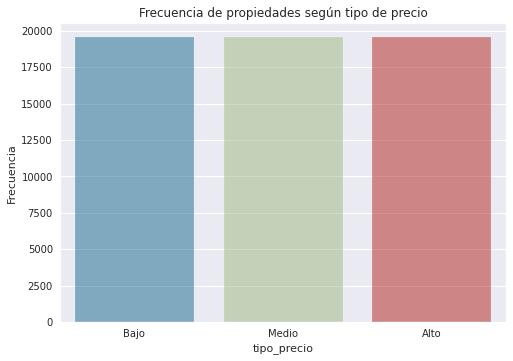

In [1896]:
ds_agrupado_Pclass= prop_caba_data.groupby(['tipo_precio']).count()  #Calculo la frecuencia de cada categoría

eje_x = ds_agrupado_Pclass.index.tolist()   ## Declaramos valores para el eje x
eje_y = ds_agrupado_Pclass['pxm2'].tolist()  ## Declaramos valores para el eje y

sns_bar_plot=sns.barplot(x=eje_x, y=eje_y, data=ds_agrupado_Pclass ,alpha=0.5).set(title="Frecuencia de propiedades según tipo de precio",ylabel='Frecuencia',xlabel='tipo_precio')

**● Mostrar en un mapa de CABA los avisos coloreados por tipo_precio**

In [1897]:
fig = px.scatter_geo(data_frame=prop_caba_data, lat='latitud', lon='longitud', fitbounds='locations',color='tipo_precio')
fig.show()

#### 2. Dividir la variable pxm2 en 3 intervalos, el primero con el 25% de las observaciones, el siguiente con el 50% y el último con el 25% de las observaciones restantes.

In [1898]:
prop_caba_data['tipo_precio'], bins = quantile_cut(prop_caba_data['pxm2'], [0, .25, .75, 1])

prop_caba_data.loc[:, ['property_type', 'pxm2', 'tipo_precio']].sample(n=5)

,property_type,pxm2,tipo_precio
70503,Departamento,"1,491.67",Bajo
353964,Departamento,"2,350.00",Medio
310790,Departamento,"1,875.00",Medio
254728,Departamento,"3,033.93",Alto
187335,Departamento,"1,950.82",Medio


Verifico cuantos valores cayeron en cada cuantil

In [1899]:
prop_caba_data['tipo_precio'].value_counts().sort_index()

Bajo     14672
Medio    29371
Alto     14639
Name: tipo_precio, dtype: int64

**● Mostrar la distribución del precio por metro cuadrado**

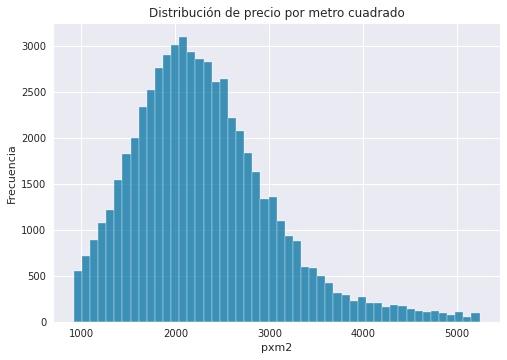

In [1900]:
sns_hist=sns.histplot(data=prop_caba_data['pxm2'], bins = 50).set(title="Distribución de precio por metro cuadrado",xlabel="pxm2",ylabel="Frecuencia")

**● Mostrar la distribución del precio por metro cuadrado por tipo de propiedad:**

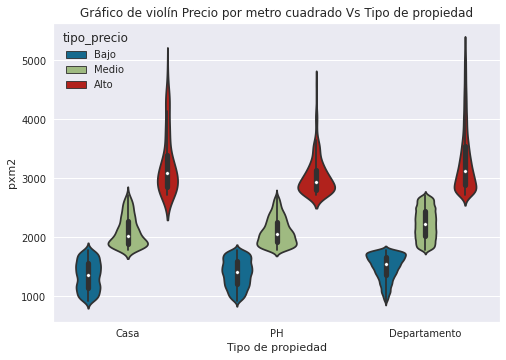

In [1901]:
ax = sns.violinplot(y="pxm2", x="property_type", data=prop_caba_data, hue='tipo_precio').set(title="Gráfico de violín Precio por metro cuadrado Vs Tipo de propiedad",xlabel='Tipo de propiedad',ylabel='pxm2') 

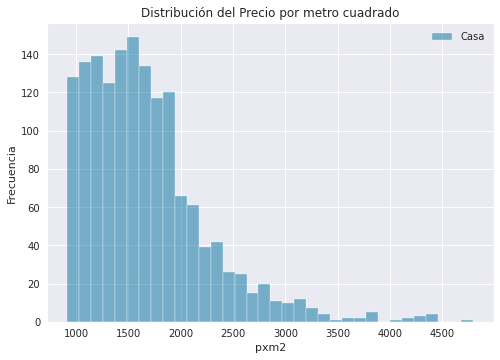

In [1902]:
pxm2_casa = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'Casa', ['pxm2']], label='Casa').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

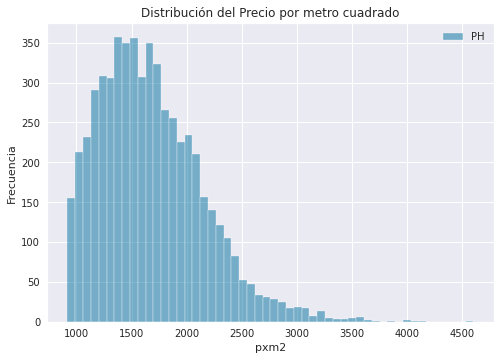

In [1903]:
pxm2_PH = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'PH', ['pxm2']], label='PH').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

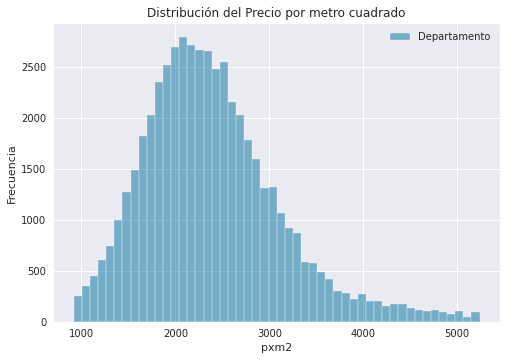

In [1904]:
pxm2_Departamento = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'Departamento', ['pxm2']], bins = 50, label='Departamento').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

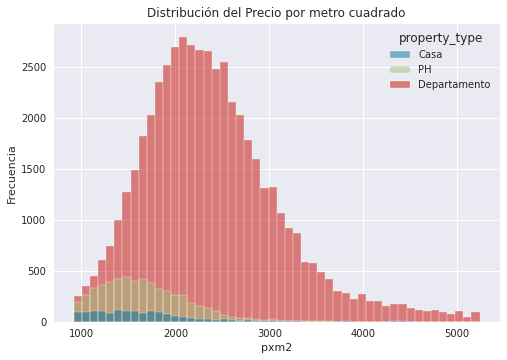

In [1905]:
pxm2_vs_prop_type = sns.histplot(data=prop_caba_data, x='pxm2', hue='property_type', bins = 50).set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 

 **● Mostrar gráficamente la distribución de la nueva variable creada tipo_precio:**

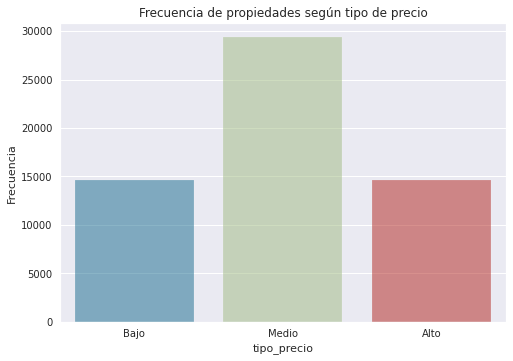

In [1906]:
ds_agrupado_Pclass= prop_caba_data.groupby(['tipo_precio']).count()  #Calculo la frecuencia de cada categoría

eje_x = ds_agrupado_Pclass.index.tolist()   ## Declaramos valores para el eje x
eje_y = ds_agrupado_Pclass['pxm2'].tolist()  ## Declaramos valores para el eje y

sns_bar_plot=sns.barplot(x=eje_x, y=eje_y, data=ds_agrupado_Pclass ,alpha=0.5).set(title="Frecuencia de propiedades según tipo de precio",ylabel='Frecuencia',xlabel='tipo_precio')

**● Mostrar en un mapa de CABA los avisos coloreados por tipo_precio**

In [1907]:
fig = px.scatter_geo(data_frame=prop_caba_data, lat='latitud', lon='longitud', fitbounds='locations',color='tipo_precio')
fig.show()

#### 3. Trabajar la variable pxm2 relativa a cada tipo de propiedad y luego dividirla como en el punto anterior.

In [1908]:
indexer_casa = prop_caba_data[prop_caba_data['property_type'] == 'Casa'].index
indexer_PH = prop_caba_data[prop_caba_data['property_type'] == 'PH'].index
indexer_Departamento = prop_caba_data[prop_caba_data['property_type'] == 'Departamento'].index

In [1909]:
#Distribuyo los cuantiles igual que antes (el primero con el 25% de las observaciones, el siguiente con el 50% 
# y el último con el 25% de las observaciones restantes), pero en este caso relativo al tipo de propiedad

prop_caba_data.loc[indexer_casa, 'tipo_precio'], bins_casa = quantile_cut(prop_caba_data.loc[indexer_casa]['pxm2'], [0, .25, .75, 1])
prop_caba_data.loc[indexer_PH, 'tipo_precio'], bins_PH = quantile_cut(prop_caba_data.loc[indexer_PH]['pxm2'], [0, .25, .75, 1])
prop_caba_data.loc[indexer_Departamento, 'tipo_precio'], bins_Departamento = quantile_cut(prop_caba_data.loc[indexer_Departamento]['pxm2'], [0, .25, .75, 1])

prop_caba_data.loc[:, ['property_type', 'pxm2', 'tipo_precio']].sample(n=5)

,property_type,pxm2,tipo_precio
457890,Departamento,"3,000.00",Alto
212384,Departamento,"1,215.38",Bajo
106763,Departamento,"2,181.82",Medio
452142,Departamento,"1,965.20",Medio
11095,Departamento,"3,064.52",Alto


Verifico cuantos valores cayeron en cada cuantil

In [1910]:
prop_caba_data['tipo_precio'].value_counts().sort_index()

Bajo     14677
Medio    29371
Alto     14634
Name: tipo_precio, dtype: int64

**● Mostrar la distribución del precio por metro cuadrado**

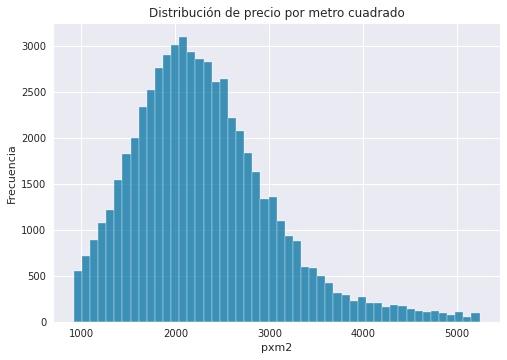

In [1911]:
sns_hist=sns.histplot(data=prop_caba_data['pxm2'], bins = 50).set(title="Distribución de precio por metro cuadrado",xlabel="pxm2",ylabel="Frecuencia")

**● Mostrar la distribución del precio por metro cuadrado por tipo de propiedad:**

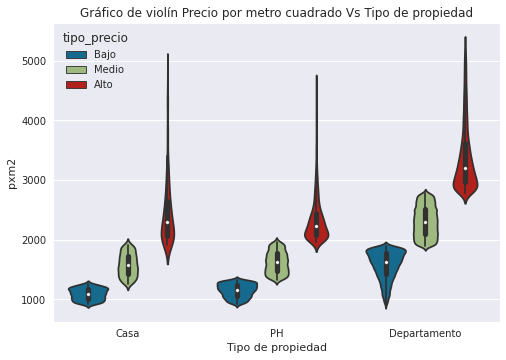

In [1912]:
ax = sns.violinplot(y="pxm2", x="property_type", data=prop_caba_data, hue='tipo_precio').set(title="Gráfico de violín Precio por metro cuadrado Vs Tipo de propiedad",xlabel='Tipo de propiedad',ylabel='pxm2')

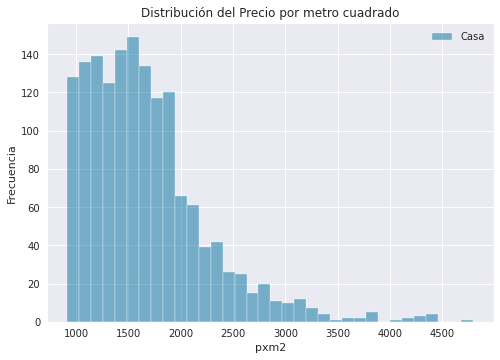

In [1913]:
pxm2_casa = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'Casa', ['pxm2']], label='Casa').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

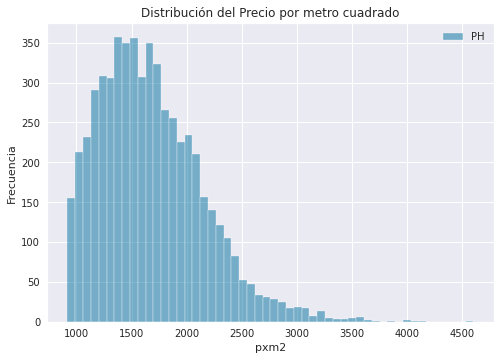

In [1914]:
pxm2_PH = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'PH', ['pxm2']], label='PH').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

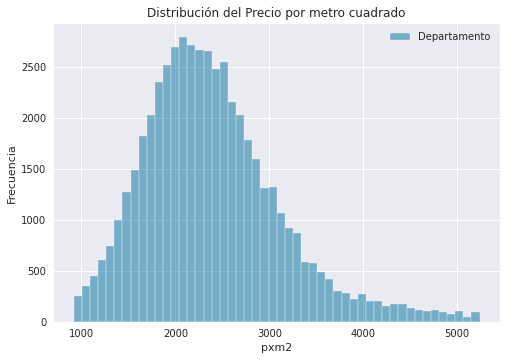

In [1915]:
pxm2_Departamento = sns.histplot(data=prop_caba_data.loc[prop_caba_data.property_type == 'Departamento', ['pxm2']], bins = 50, label='Departamento').set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 
plt.legend()

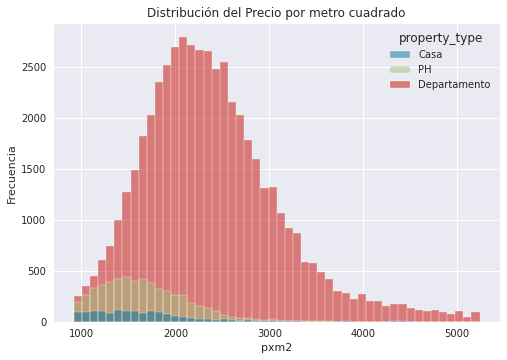

In [1916]:
pxm2_vs_prop_type = sns.histplot(data=prop_caba_data, x='pxm2', hue='property_type', bins = 50).set(title="Distribución del Precio por metro cuadrado",
                                                                                                                             xlabel='pxm2',
                                                                                                                             ylabel='Frecuencia') 

 **● Mostrar gráficamente la distribución de la nueva variable creada tipo_precio:**

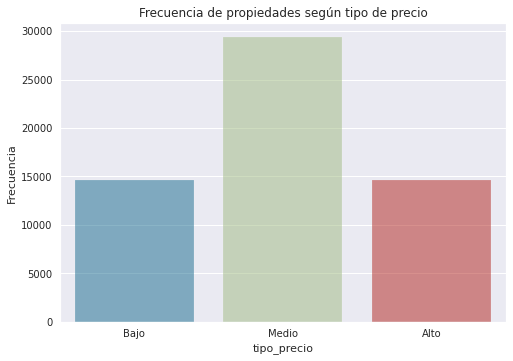

In [1917]:
ds_agrupado_Pclass= prop_caba_data.groupby(['tipo_precio']).count()  #Calculo la frecuencia de cada categoría

eje_x = ds_agrupado_Pclass.index.tolist()   ## Declaramos valores para el eje x
eje_y = ds_agrupado_Pclass['pxm2'].tolist()  ## Declaramos valores para el eje y

sns_bar_plot=sns.barplot(x=eje_x, y=eje_y, data=ds_agrupado_Pclass ,alpha=0.5).set(title="Frecuencia de propiedades según tipo de precio",ylabel='Frecuencia',xlabel='tipo_precio')

**● Mostrar en un mapa de CABA los avisos coloreados por tipo_precio**

In [1918]:
fig = px.scatter_geo(data_frame=prop_caba_data, lat='latitud', lon='longitud', fitbounds='locations',color='tipo_precio')
fig.show()

### Escoger una de las opciones
Se toma la decisión de utilizar la opción 3, pues resulta apropiado adaptar la clasificación al tipo de propiedad. Lógicamente, un apartamento de precio alto y una casa de precio alto no cuestan lo mismo, tal y como se puede apreciar a continuación haciendo un análisis de los intervalos obtenidos para la clasificación:

In [1919]:
bins_casa = list(np.float_(bins_casa))
print(bins_casa)

[918.8034188034188, 1250.0, 1914.8936170212767, 4796.0]


In [1920]:
bins_PH = list(np.float_(bins_PH))
print(bins_PH)

[918.918918918919, 1322.5806451612902, 1958.3333333333333, 4599.923076923077]


In [1921]:
bins_Departamento = list(np.float_(bins_Departamento))
print(bins_Departamento)

[918.7279151943463, 1886.0685899322932, 2777.777777777778, 5238.0952380952385]


### A partir de los bins obtenidos en train, se replica la discretización para test

In [1922]:
indexer_casa = prop_caba_test[prop_caba_test['property_type'] == 'Casa'].index
indexer_PH = prop_caba_test[prop_caba_test['property_type'] == 'PH'].index
indexer_Departamento = prop_caba_test[prop_caba_test['property_type'] == 'Departamento'].index

In [1923]:
indexer_casa

Int64Index([222805, 447946, 413099, 268534, 309260, 357640, 271066, 400709,
             94048, 372128,
            ...
            413282, 169372, 221406, 144801,  58341, 267487, 118502, 324766,
            454533, 225277],
           dtype='int64', length=337)

In [1924]:
pmx2_test

352750               2,307.69
94517                2,736.84
65779                2,680.56
179714               2,362.07
171352               2,093.02
                 ...         
419168               2,612.36
339511               3,105.26
187160               3,558.56
30008                2,188.68
222531               2,263.89
Length: 14514, dtype: float64

In [1925]:
prop_caba_test

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna,pxm2
352750,-34.56,-58.46,Belgrano,Departamento,3.00,2.00,65.00,65.00,13,"2,307.69"
94517,-34.56,-58.46,Belgrano,Departamento,3.00,2.00,57.00,49.00,13,"2,736.84"
65779,-34.56,-58.47,Villa Urquiza,Departamento,3.00,2.00,72.00,63.00,12,"2,680.56"
179714,-34.60,-58.43,Almagro,Departamento,1.00,1.00,29.00,29.00,5,"2,362.07"
171352,-34.65,-58.52,Mataderos,PH,3.00,2.00,86.00,66.00,9,"2,093.02"
...,...,...,...,...,...,...,...,...,...,...
419168,-34.59,-58.48,Parque Chas,PH,5.00,3.00,178.00,178.00,15,"2,612.36"
339511,-34.58,-58.43,Palermo,Departamento,2.00,1.00,38.00,35.00,14,"3,105.26"
187160,-34.58,-58.44,Palermo Hollywood,Departamento,3.00,1.00,111.00,111.00,14,"3,558.56"
30008,-34.56,-58.47,Coghlan,Departamento,2.00,1.00,53.00,47.00,12,"2,188.68"


In [1926]:
#Distribuyo el tipo_precio relativo al tipo de propiedad, A PARTIR DE LOS BINS OBTENIDOS EN TRAIN!!
bins_casa[0] = 0
bins_casa[len(bins_casa) - 1] = 10000

bins_PH[0] = 0
bins_PH[len(bins_PH) - 1] = 10000

bins_Departamento[0] = 0
bins_Departamento[len(bins_Departamento) - 1] = 10000

prop_caba_test.loc[indexer_casa, 'tipo_precio'] = pd.cut(prop_caba_test.loc[indexer_casa]['pxm2'], bins = bins_casa, labels = ['Bajo', 'Medio', 'Alto'])
prop_caba_test.loc[indexer_PH, 'tipo_precio'] = pd.cut(prop_caba_test.loc[indexer_PH]['pxm2'], bins = bins_PH, labels = ['Bajo', 'Medio', 'Alto'])
prop_caba_test.loc[indexer_Departamento, 'tipo_precio'] = pd.cut(prop_caba_test.loc[indexer_Departamento]['pxm2'], bins_Departamento, labels = ['Bajo', 'Medio', 'Alto'])
prop_caba_test.loc[:, ['property_type', 'pxm2', 'tipo_precio']].sample(n=5)

,property_type,pxm2,tipo_precio
53675,Departamento,"2,038.46",Medio
390121,Departamento,"1,977.78",Medio
105395,Departamento,"2,000.00",Medio
392452,Departamento,"2,000.00",Medio
143778,Departamento,"2,800.00",Alto


In [1927]:
prop_caba_test.loc[prop_caba_test.tipo_precio == np.NaN]

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna,pxm2,tipo_precio


### Se guardan los conjuntos de datos obtenidos luego de realizar la construcción del target:

In [1928]:
df_clasificacion_train = prop_caba_data.copy()
df_clasificacion_train['property_price'] = with_target.property_price
df_clasificacion_train.head(2)

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna,pxm2,tipo_precio,property_price
100248,-34.64,-58.46,Flores,Casa,7.00,5.00,260.00,260.00,7,942.31,Bajo,"245,000.00"
1472,-34.61,-58.37,San Telmo,PH,3.00,2.00,68.00,40.00,1,"1,323.53",Medio,"90,000.00"


In [1929]:
df_clasificacion_test = prop_caba_test.copy()
df_clasificacion_test['property_price'] = with_target_test.property_price
df_clasificacion_test.head(2)

,latitud,longitud,place_l3,property_type,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna,pxm2,tipo_precio,property_price
352750,-34.56,-58.46,Belgrano,Departamento,3.00,2.00,65.00,65.00,13,"2,307.69",Medio,"150,000.00"
94517,-34.56,-58.46,Belgrano,Departamento,3.00,2.00,57.00,49.00,13,"2,736.84",Medio,"156,000.00"


In [1930]:
try:
  df_clasificacion_train.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_clasificacion_train.csv', index_label="index")
  df_clasificacion_test.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_clasificacion_test.csv', index_label="index")
except:
  df_clasificacion_train.to_csv('df_clasificacion_train.csv', index_label="index")
  df_clasificacion_test.to_csv('df_clasificacion_test.csv', index_label="index")

##b) Entrenamiento y Predicción

Predecir el valor del atributo tipo_precio, excluyendo del entrenamiento la variable price,
pxm2 y cualquier otra que pueda contener información del precio de venta. Para todos los
modelos se pide:

###● Realizar las tareas de ingeniería de características necesarias para trabajar con cada algoritmo (encoding, normalización, etc)

Mapeamos los valores `tipo_precio` a variables numéricas para poder procesarlos

In [1931]:
prop_caba_data['tipo_precio'] = prop_caba_data['tipo_precio'].map({'Bajo':0,'Medio':1, 'Alto':2},na_action=None)
prop_caba_test['tipo_precio'] = prop_caba_test['tipo_precio'].map({'Bajo':0,'Medio':1, 'Alto':2},na_action=None)

Antes de realizar el análisis de hiperparámetros, verificamos que las clases estén correctamente balanceadas

In [1932]:
features=['latitud', 'longitud', 'property_rooms', 'property_bedrooms', 'property_surface_total', 
          'property_surface_covered', 'property_type_Departamento', 'property_type_PH',
          'comuna_2', 'comuna_3', 'comuna_4', 'comuna_5', 'comuna_6', 'comuna_7', 'comuna_8',
          'comuna_9', 'comuna_10', 'comuna_11', 'comuna_12', 'comuna_13', 'comuna_14', 'comuna_15']

target='tipo_precio'

#Verifico balanceo de clases
prop_caba_data[target].value_counts(normalize=True)*100

1                  50.05
0                  25.01
2                  24.94
Name: tipo_precio, dtype: float64

### Se guardan los conjuntos de datos obtenidos luego de realizar ingenieria de características:

#### DataFrame original

In [1933]:
df_encoded_train.head(2)

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna_2,comuna_3,comuna_4,comuna_5,...,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,property_price
100248,-34.64,-58.46,7.00,5.00,260.00,260.00,0,0,0,0,...,0,0,0,0,0,0,0,0,0,"245,000.00"
1472,-34.61,-58.37,3.00,2.00,68.00,40.00,0,0,0,0,...,0,0,0,0,0,0,0,0,1,"90,000.00"


In [1934]:
df_clasificacion_train_ENCODED = df_encoded_train.copy()
df_clasificacion_train_ENCODED['tipo_precio'] = prop_caba_data.tipo_precio
df_clasificacion_train_ENCODED['pxm2'] = prop_caba_data.pxm2
df_clasificacion_train_ENCODED.head(2)

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna_2,comuna_3,comuna_4,comuna_5,...,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,property_price,tipo_precio,pxm2
100248,-34.64,-58.46,7.00,5.00,260.00,260.00,0,0,0,0,...,0,0,0,0,0,0,0,"245,000.00",0,942.31
1472,-34.61,-58.37,3.00,2.00,68.00,40.00,0,0,0,0,...,0,0,0,0,0,0,1,"90,000.00",1,"1,323.53"


In [1935]:
df_clasificacion_test_ENCODED = df_encoded_test.copy()
df_clasificacion_test_ENCODED['tipo_precio'] = prop_caba_test.tipo_precio
df_clasificacion_test_ENCODED['pxm2'] = prop_caba_test.pxm2
df_clasificacion_test_ENCODED.head(2)

,latitud,longitud,property_rooms,property_bedrooms,property_surface_total,property_surface_covered,comuna_2,comuna_3,comuna_4,comuna_5,...,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,property_price,tipo_precio,pxm2
352750,-34.56,-58.46,3.00,2.00,65.00,65.00,0,0,0,0,...,0,0,1,0,0,1,0,"150,000.00",1,"2,307.69"
94517,-34.56,-58.46,3.00,2.00,57.00,49.00,0,0,0,0,...,0,0,1,0,0,1,0,"156,000.00",1,"2,736.84"


In [1936]:
try:
  df_clasificacion_train_ENCODED.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_clasificacion_train_ENCODED.csv', index_label="index")
  df_clasificacion_test_ENCODED.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_clasificacion_test_ENCODED.csv', index_label="index")
except:
  df_clasificacion_train_ENCODED.to_csv('df_clasificacion_train_ENCODED.csv', index_label="index")
  df_clasificacion_test_ENCODED.to_csv('df_clasificacion_test_ENCODED.csv', index_label="index")

#### DataFrame PCA

In [1937]:
df_PCA_ENCODED_train.head(2)

,cp_0,cp_1,cp_2,property_price,comuna_2,comuna_3,comuna_4,comuna_5,comuna_6,comuna_7,comuna_8,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH
100248,7.69,0.73,1.46,"245,000.00",0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1472,-0.20,1.76,-0.73,"90,000.00",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [1938]:
df_clasificacion_PCA_train_ENCODED = df_PCA_ENCODED_train.copy()
df_clasificacion_PCA_train_ENCODED['tipo_precio'] = prop_caba_data.tipo_precio
df_clasificacion_PCA_train_ENCODED['pxm2'] = prop_caba_data.pxm2
df_clasificacion_PCA_train_ENCODED.head(2)

,cp_0,cp_1,cp_2,property_price,comuna_2,comuna_3,comuna_4,comuna_5,comuna_6,comuna_7,...,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,tipo_precio,pxm2
100248,7.69,0.73,1.46,"245,000.00",0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,942.31
1472,-0.20,1.76,-0.73,"90,000.00",0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,1,"1,323.53"


In [1939]:
df_clasificacion_PCA_test_ENCODED = df_PCA_ENCODED_test.copy()
df_clasificacion_PCA_test_ENCODED['tipo_precio'] = prop_caba_test.tipo_precio
df_clasificacion_PCA_test_ENCODED['pxm2'] = prop_caba_test.pxm2
df_clasificacion_PCA_test_ENCODED.head(2)

,cp_0,cp_1,cp_2,property_price,comuna_2,comuna_3,comuna_4,comuna_5,comuna_6,comuna_7,...,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH,tipo_precio,pxm2
352750,0.26,0.22,-0.27,"150,000.00",0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,"2,307.69"
94517,0.26,0.22,-0.43,"156,000.00",0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,"2,736.84"


In [1940]:
try:
  df_clasificacion_PCA_train_ENCODED.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_clasificacion_PCA_train_ENCODED.csv', index_label="index")
  df_clasificacion_PCA_test_ENCODED.to_csv('drive/My Drive/tp1 datos grupal/Datasets/df_clasificacion_PCA_test_ENCODED.csv', index_label="index")
except:
  df_clasificacion_PCA_train_ENCODED.to_csv('df_clasificacion_PCA_train_ENCODED.csv', index_label="index")
  df_clasificacion_PCA_test_ENCODED.to_csv('df_clasificacion_PCA_test_ENCODED.csv', index_label="index")

## Arbol de decisión

A continuación, separamos el set de entrenamiento y pruebas y verificamos que los datos se encuentren correctamente balanceados

### Dataset

In [1941]:
#Separo un set de Evaluacion
from sklearn.model_selection import train_test_split
decision_tree_data = df_encoded_train.drop('property_price', axis=1)
x_train = decision_tree_data.values
y_train =  prop_caba_data[target].values

features = decision_tree_data.columns

decision_tree_test = df_encoded_test.drop('property_price', axis=1)
x_test = decision_tree_test.values
y_test =  prop_caba_test[target].values

#Verifico Cantidad de Datos en cada set
print('# Datos Entrenamiento: {}'.format(len(x_train)))
print('# Datos Prueba: {}'.format(len(x_test)))

#Verifico como quedaron balanceados
for split_name, split in zip(['% Positivos Entrenamiento','% Positivos Prueba'],[y_train,y_test]):
  print('{}: {:.3f}'.format(split_name,pd.Series(split).value_counts(normalize=True)[0]*100), 'Bajo')
  print('{}: {:.3f}'.format(split_name,pd.Series(split).value_counts(normalize=True)[1]*100), 'Medio')
  print('{}: {:.3f}'.format(split_name,pd.Series(split).value_counts(normalize=True)[2]*100), 'Alto')

# Datos Entrenamiento: 58682
# Datos Prueba: 14514
% Positivos Entrenamiento: 50.051 Bajo
% Positivos Entrenamiento: 25.011 Medio
% Positivos Entrenamiento: 24.938 Alto
% Positivos Prueba: 50.455 Bajo
% Positivos Prueba: 25.224 Medio
% Positivos Prueba: 24.321 Alto


Aplicamos Cross-Validation y para esto, seteamos 20 combinaciones posibles con 10 folds ya que, durante previos testeos encontramos que para entretar con CV un arbol de decisión, se realiza relativamente rápido (en el rango de 1 a 2 minutos).

Por otro lado, nos enfocamos de optimizar el f1-score ya que queremos dar una buena predicción tanto para el recall como también para el accuracy. 

#### Grid search

In [1942]:
import sklearn as sk
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold, KFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import make_scorer

#Cantidad de combinaciones que quiero porbar
n=3

#Conjunto de parámetros que quiero usar
params_grid = {'criterion':['gini','entropy'],
               'ccp_alpha':np.linspace(0,0.05,n), 
               'max_depth':list(range(1,10,2))}
                
#Cantidad de splits para el Cross Validation
folds=10

#Kfold estratificado
kfoldcv = StratifiedKFold(n_splits=folds)

#Clasificador
base_tree = DecisionTreeClassifier()

#Metrica que quiero optimizar F1 Score
scorer_fn = make_scorer(sk.metrics.f1_score, average='micro')

#GridSearch CV
gridcv = GridSearchCV(estimator=base_tree ,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

gridcv.fit(x_train,y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
             estimator=DecisionTreeClassifier(),
             param_grid={'ccp_alpha': array([0.   , 0.025, 0.05 ]),
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 3, 5, 7, 9]},
             return_train_score='True',
             scoring=make_scorer(f1_score, average=micro))

In [1943]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': 9}
0.6080909096505236


#### Importancia

Ahora validamos los atributos con mayor importancia y podemos apreciar de que, en este caso corresponden a Latitud y Longitud. Luego, para este contexto, tiene sentido decir que el precio tenga relación con estos atributos ya que los mismos corresponden a la geolocalización de las propiedades y para el caso de Capital Federal, los precios varían según el barrio.

In [1944]:
#Atributos considerados y su importancia
best_tree = gridcv.best_estimator_
feat_imps = best_tree.feature_importances_

for feat_imp,feat in sorted(zip(feat_imps,features)):
  if feat_imp>0:
    print('{}: {}'.format(feat,feat_imp))

comuna_7: 0.00021028210326709846
comuna_11: 0.00021151027224103265
comuna_5: 0.00046633781953821365
comuna_15: 0.0021687103516734294
property_bedrooms: 0.0027440842020337495
comuna_14: 0.0036113699071335576
property_rooms: 0.008967684730259592
property_type_PH: 0.010826013257228552
comuna_3: 0.02439678823645089
property_type_Departamento: 0.028759350284359202
comuna_6: 0.047963501531579855
property_surface_covered: 0.07241904463854239
property_surface_total: 0.08207043550437669
longitud: 0.2131924034584474
latitud: 0.5019924837028684


#### Mejor modelo

In [1945]:
#Creo el árbol con los mejores hiperparámetros
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_text

clf=DecisionTreeClassifier().set_params(**gridcv.best_params_)

#Entreno el arbol en todo el set
clf.fit(x_train,y_train)

rules = export_text(clf, feature_names=list(features))

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.519592 to fit



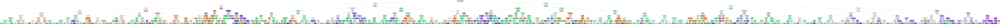

In [1946]:
from six import StringIO
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
import matplotlib.pyplot as plt

dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names=features,
                class_names=['Bajo', 'Medio', 'Alto'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

#### Evaluar

Evaluando el Arbol con los mejores hiperparámetros en train:

F1-Score: 0.6260522817899867


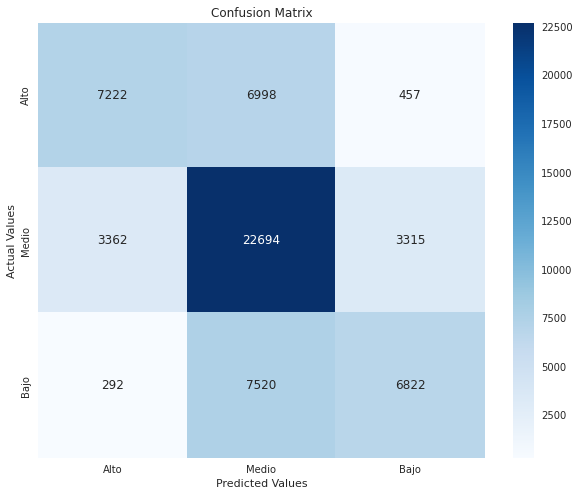

In [1947]:
#Evalúo el Arbol con los mejores hiperparámetros
from sklearn.metrics import confusion_matrix, classification_report , f1_score

#Hago predicción sobre el set de evaluacion
y_pred= clf.predict(x_train)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_train, y_pred, average='micro')))

cm = confusion_matrix(y_train,y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

En primera instancia, vemos que hay muchos mas aciertos entre los precios alto-bajo en relación a los alto-medio o medio-bajo

Accuracy: 0.6105828854898718
Recall: 0.6105828854898718
F1-Score: 0.6105828854898718


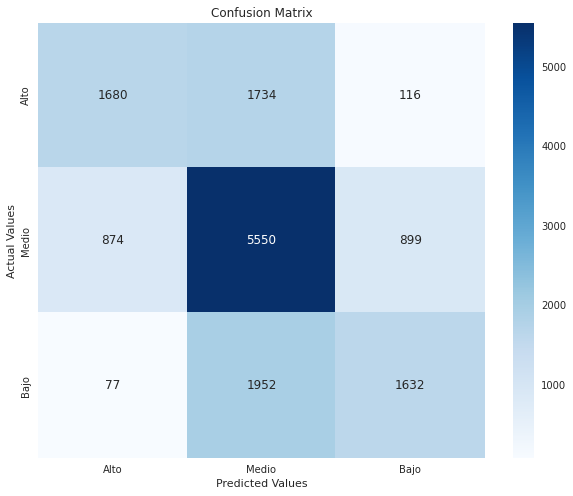

In [1949]:
#Evalúo el Arbol con los mejores hiperparámetros
from sklearn.metrics import confusion_matrix, classification_report , f1_score, recall_score, accuracy_score

#Hago predicción sobre el set de evaluacion
y_pred= clf.predict(x_test)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('Accuracy: {}'.format(accuracy_score(y_test, y_pred)))
print('Recall: {}'.format(recall_score(y_test, y_pred, average='micro')))
print('F1-Score: {}'.format(f1_score(y_test, y_pred, average='micro')))

cm = confusion_matrix(y_test,y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

En base al f1 score obtenido, el modelo performa de manera muy similar en train y en test.

Analizando los resultados, vemos que las predicciones entre los valores bajo y alto son muy acertadas. Esto es ya que en la mayoria de los datos hay mucha diferencia entre los precios que consideramos altos y bajos.

Por otro lado, si analizamos las predicciones entre medio y alto o medio y bajo, tenemos muchos menos aciertos. Por este motivo, es que priorizamos anteriormente la metrica f-score para poder enfocarnos tanto en la precisión como en el recall.

Se guarda el modelo de arbol de decisión:

In [1950]:
import joblib  

try:
  joblib.dump(clf, 'drive/My Drive/tp1 datos grupal/Modelos/ArbolDeDecision.pkl')
except:
  joblib.dump(clf, 'ArbolDeDecision.pkl')

### PCA

A continuación, separamos el set de entrenamiento y pruebas y verificamos que los datos se encuentren correctamente balanceados

In [1951]:
df_PCA_ENCODED_train

,cp_0,cp_1,cp_2,property_price,comuna_2,comuna_3,comuna_4,comuna_5,comuna_6,comuna_7,comuna_8,comuna_9,comuna_10,comuna_11,comuna_12,comuna_13,comuna_14,comuna_15,property_type_Departamento,property_type_PH
100248,7.69,0.73,1.46,"245,000.00",0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1472,-0.20,1.76,-0.73,"90,000.00",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
117479,3.79,0.58,0.02,"450,000.00",0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
79144,-1.23,2.41,-0.22,"125,000.00",0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
108699,2.10,1.23,-0.41,"269,000.00",0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290962,-2.08,0.12,0.61,"78,000.00",0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0
105889,-2.30,0.27,-1.03,"65,000.00",0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
136266,-1.53,0.49,0.20,"82,000.00",0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
20953,0.08,0.80,-0.90,"140,000.00",1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


####Dataset

In [1953]:
#Separo un set de Evaluacion
from sklearn.model_selection import train_test_split
decision_tree_data_PCA = df_PCA_ENCODED_train.drop('property_price', axis=1)
x_train_PCA = decision_tree_data_PCA.values
y_train_PCA =  prop_caba_data[target].values

features_PCA = decision_tree_data_PCA.columns

decision_tree_test_PCA = df_PCA_ENCODED_test.drop('property_price', axis=1)
x_test_PCA = decision_tree_test_PCA.values
y_test_PCA =  prop_caba_test[target].values

#Verifico Cantidad de Datos en cada set
print('# Datos Entrenamiento: {}'.format(len(x_train_PCA)))
print('# Datos Prueba: {}'.format(len(x_test_PCA)))

#Verifico como quedaron balanceados
for split_name, split in zip(['% Positivos Entrenamiento','% Positivos Prueba'],[y_train_PCA,y_test_PCA]):
  print('{}: {:.3f}'.format(split_name,pd.Series(split).value_counts(normalize=True)[0]*100), 'Bajo')
  print('{}: {:.3f}'.format(split_name,pd.Series(split).value_counts(normalize=True)[1]*100), 'Medio')
  print('{}: {:.3f}'.format(split_name,pd.Series(split).value_counts(normalize=True)[2]*100), 'Alto')

# Datos Entrenamiento: 58682
# Datos Prueba: 14514
% Positivos Entrenamiento: 50.051 Bajo
% Positivos Entrenamiento: 25.011 Medio
% Positivos Entrenamiento: 24.938 Alto
% Positivos Prueba: 50.455 Bajo
% Positivos Prueba: 25.224 Medio
% Positivos Prueba: 24.321 Alto


#### Grid search

In [1954]:
import sklearn as sk
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold, KFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import make_scorer

#Cantidad de combinaciones que quiero porbar
n=3

#Conjunto de parámetros que quiero usar
params_grid = {'criterion':['gini','entropy'],
               'ccp_alpha':np.linspace(0,0.05,n), 
               'max_depth':list(range(1,10,2))}
                
#Cantidad de splits para el Cross Validation
folds=10

#Kfold estratificado
kfoldcv = StratifiedKFold(n_splits=folds)

#Clasificador
base_tree = DecisionTreeClassifier()

#Metrica que quiero optimizar F1 Score
scorer_fn = make_scorer(sk.metrics.f1_score, average='micro')

#GridSearch CV
gridcv = GridSearchCV(estimator=base_tree ,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

gridcv.fit(x_train_PCA,y_train_PCA)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
             estimator=DecisionTreeClassifier(),
             param_grid={'ccp_alpha': array([0.   , 0.025, 0.05 ]),
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 3, 5, 7, 9]},
             return_train_score='True',
             scoring=make_scorer(f1_score, average=micro))

In [1955]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': 9}
0.6061312671584538


#### Importancia

Ahora validamos los atributos con mayor importancia y podemos apreciar de que, en este caso corresponden a las 3 componentes principales, sobre todo a la pc_2, que como vimos anteriormente es la que más peso le da a la latitud y longitud de la propiedad. Luego, para este contexto, tiene sentido decir que el precio tenga relación con estos atributos ya que los mismos corresponden a la geolocalización de las propiedades y para el caso de Capital Federal, los precios varían según el barrio.

In [1956]:
#Atributos considerados y su importancia
best_tree = gridcv.best_estimator_
feat_imps = best_tree.feature_importances_

for feat_imp,feat in sorted(zip(feat_imps,features_PCA)):
  if feat_imp>0:
    print('{}: {}'.format(feat,feat_imp))

comuna_7: 0.001641046277127861
comuna_5: 0.0027682708198521625
comuna_2: 0.0039808074489044
property_type_PH: 0.005854071716098918
comuna_13: 0.00819219356759328
comuna_6: 0.01484699447957379
comuna_14: 0.02436108110118022
comuna_3: 0.02633114035335725
property_type_Departamento: 0.031415610256500734
cp_0: 0.11037221349927001
cp_1: 0.37023439936034686
cp_2: 0.40000217112019465


#### Mejor modelo

In [1957]:
#Creo el árbol con los mejores hiperparámetros
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_text

tree_PCA = DecisionTreeClassifier().set_params(**gridcv.best_params_)

#Entreno el arbol en todo el set
tree_PCA.fit(x_train_PCA,y_train_PCA)

rules = export_text(tree_PCA, feature_names=list(features_PCA))

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.457084 to fit



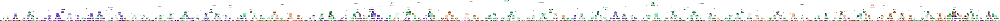

In [1958]:
from six import StringIO
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
import matplotlib.pyplot as plt

dot_data = StringIO()
export_graphviz(tree_PCA, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names=features_PCA,
                class_names=['Bajo', 'Medio', 'Alto'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

#### Evaluar

Se evalúa el modelo entrenado con PCA en train

F1-Score: 0.626120445792577


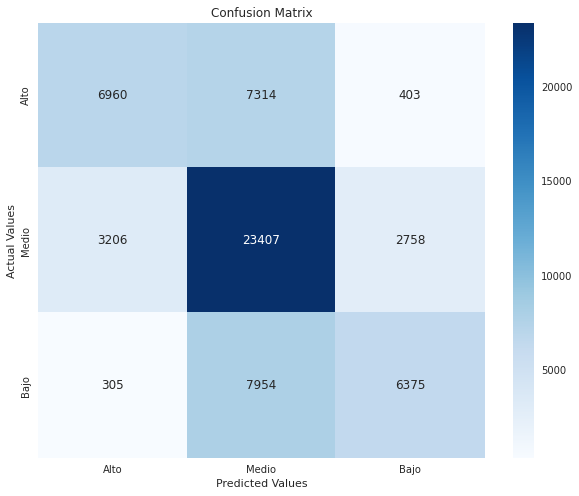

In [1960]:
#Evalúo el Arbol con los mejores hiperparámetros
from sklearn.metrics import confusion_matrix, classification_report , f1_score

#Hago predicción sobre el set de evaluacion
y_pred_PCA= tree_PCA.predict(x_train_PCA)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_train_PCA, y_pred_PCA, average='micro')))

cm = confusion_matrix(y_train_PCA,y_pred_PCA)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Dado el valor de f1-score obtenido vemos que performa de manera similar a el modelo entrenado sin realizar la reducción de dimensión, se analiza a continuación lo obtenido en test:

F1-Score: 0.43675072343943777


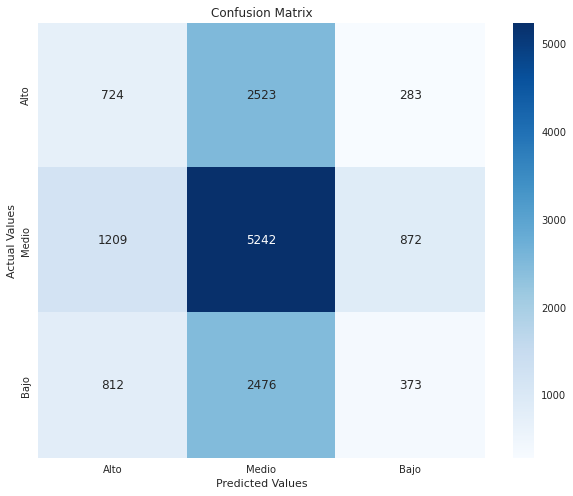

In [1961]:
#Evalúo el Arbol con los mejores hiperparámetros
from sklearn.metrics import confusion_matrix, classification_report , f1_score

#Hago predicción sobre el set de evaluacion
y_pred_PCA= tree_PCA.predict(x_test_PCA)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_test_PCA, y_pred_PCA, average='micro')))

cm = confusion_matrix(y_test_PCA,y_pred_PCA)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Esta vez vemos que el valor de f1-score es el que peor performa con los datos de test. 

Nuevamente performó de forma similar en train y en test, logrando resultados comparables a los obtenidos entrenando el modelo con el dataset completo.

Se guarda el modelo de arbol de decisión entrenado usando PCA:

In [1962]:
import joblib  

try:
  joblib.dump(tree_PCA, 'drive/My Drive/tp1 datos grupal/Modelos/ArbolDeDecision_PCA.pkl')
except:
  joblib.dump(tree_PCA, 'ArbolDeDecision_PCA.pkl')

## Random forest

###Dataset


#### Grid search

Para el Random Forest, queremos nuevamente optimizar el f1-score ya que necesitamos poder dar una buena predicción con un buen accuracy y un buen recall

In [1963]:
from sklearn.ensemble import RandomForestClassifier

#Cantidad de combinaciones que quiero porbar
n=3

#Conjunto de parámetros que quiero usar
params_grid = {'criterion':['gini','entropy'],
               'n_estimators':[4,6,8,10],
               'ccp_alpha':np.linspace(0,0.05,n), 
               'max_depth':list(range(1,6))}
                
#Cantidad de splits para el Cross Validation
folds=5

#Kfold estratificado
kfoldcv = StratifiedKFold(n_splits=folds)

#Clasificador
rf_tree = RandomForestClassifier()

#Metrica que quiero optimizar F1 Score
scorer_fn = make_scorer(sk.metrics.f1_score, average='micro')

#GridSearch CV
gridcv = GridSearchCV(estimator=rf_tree ,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

gridcv.fit(x_train,y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=RandomForestClassifier(),
             param_grid={'ccp_alpha': array([0.   , 0.025, 0.05 ]),
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 2, 3, 4, 5],
                         'n_estimators': [4, 6, 8, 10]},
             return_train_score='True',
             scoring=make_scorer(f1_score, average=micro))

In [1964]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': 5, 'n_estimators': 10}
0.5625745193495783


#### Importancia

In [1965]:
#Atributos considerados y su importancia
best_tree = gridcv.best_estimator_
feat_imps = best_tree.feature_importances_

for feat_imp,feat in sorted(zip(feat_imps,features)):
  if feat_imp>0:
    print('{}: {}'.format(feat,feat_imp))

comuna_5: 0.0005329298145477519
comuna_4: 0.0005468246757991994
comuna_8: 0.002674306717045059
comuna_9: 0.0034058593758232872
property_type_PH: 0.0039533172941871985
property_bedrooms: 0.009461366214880595
comuna_15: 0.009670748821986673
property_type_Departamento: 0.010276601678856159
comuna_12: 0.01099838113458098
property_rooms: 0.013041291219222725
comuna_6: 0.017938551711412166
property_surface_covered: 0.020677320026699565
comuna_7: 0.02746567622410062
property_surface_total: 0.04461243138260168
comuna_2: 0.058657047497043834
comuna_13: 0.06285375599707044
comuna_3: 0.09122761580187055
comuna_14: 0.11024491041557347
longitud: 0.1573034487092188
latitud: 0.3444576152874792


En esta caso, vemos que nuevamente que la latitud y longitud son uno de los atributos más importante ya que indica la geoposición de la vivienda. Esto tiene sentido ya que, sin analizar los datos, podíamos estimar que el precio de una propiedad tiene una relación con su posición geográfica. 

Por otro lado, otro de los atributos importantes que vemos es la superficie cubierta y la superficie total que también son puntos que sabíamos que iban a tener una gran relación.

#### Mejor modelo

In [1966]:
rf_tree_clf = RandomForestClassifier().set_params(**gridcv.best_params_)

#Entreno el arbol en todo el set
rf_tree_clf.fit(x_train,y_train)

RandomForestClassifier(max_depth=5, n_estimators=10)

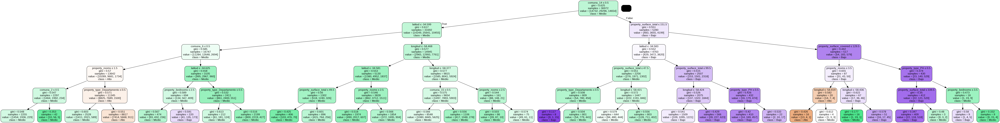

In [1967]:
dot_data = StringIO()

#Grafico uno de los arboles
export_graphviz(rf_tree_clf.estimators_[0], out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names=features,
                class_names=['Alto','Medio', 'Bajo'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

#### Evaluar

Se evalúa el modelo para datos de train:

F1-Score: 0.5671756245526738


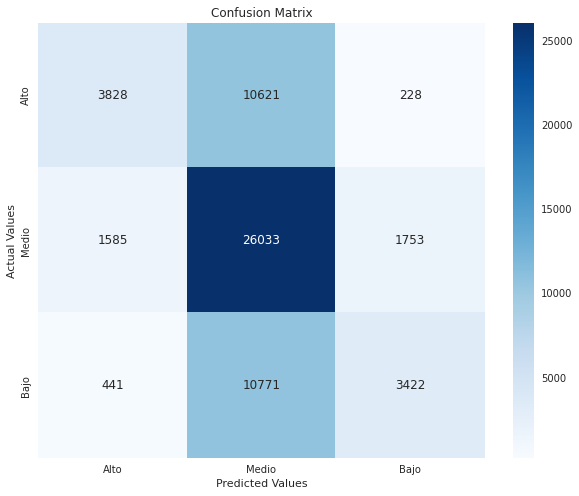

In [1968]:
#Hago predicción sobre el set de evaluacion
y_pred= rf_tree_clf.predict(x_train)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_train, y_pred, average='micro')))

cm = confusion_matrix(y_train,y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

El F1 score obtenido para datos de train es similar a los modelos anteriores, en la matriz de confusión se puede ver como el modelo predice la mayoria de las veces precio 'Medio'. a continuación sanaliza la performance ahora para datos de test:

F1-Score: 0.560217720821276


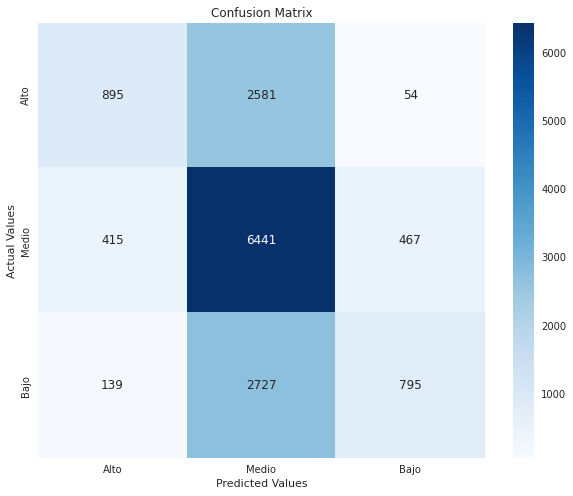

In [1969]:
#Hago predicción sobre el set de evaluacion
y_pred= rf_tree_clf.predict(x_test)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_test, y_pred, average='micro')))

cm = confusion_matrix(y_test,y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

El resultado obtenido es similar al de test.

Se guarda el modelo Random Forest:

In [1970]:
import joblib  

try:
  joblib.dump(rf_tree_clf, 'drive/My Drive/tp1 datos grupal/Modelos/RandomForest.pkl')
except:
  joblib.dump(rf_tree_clf, 'RandomForest.pkl')

### PCA

Se replica a continuación el análisis pero utilizando el data set con la reducción de dimensionalidad aplicada en el punto 1)d.

#### Grid search

In [1971]:
from sklearn.ensemble import RandomForestClassifier

#Cantidad de combinaciones que quiero porbar
n=3

#Conjunto de parámetros que quiero usar
params_grid = {'criterion':['gini','entropy'],
               'n_estimators':[4,6,8,10],
               'ccp_alpha':np.linspace(0,0.05,n), 
               'max_depth':list(range(1,6))}
                
#Cantidad de splits para el Cross Validation
folds=5

#Kfold estratificado
kfoldcv = StratifiedKFold(n_splits=folds)

#Clasificador
rf_tree = RandomForestClassifier()

#Metrica que quiero optimizar F1 Score
scorer_fn = make_scorer(sk.metrics.f1_score, average='micro')

#GridSearch CV
gridcv = GridSearchCV(estimator=rf_tree ,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

gridcv.fit(x_train_PCA, y_train_PCA)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=RandomForestClassifier(),
             param_grid={'ccp_alpha': array([0.   , 0.025, 0.05 ]),
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 2, 3, 4, 5],
                         'n_estimators': [4, 6, 8, 10]},
             return_train_score='True',
             scoring=make_scorer(f1_score, average=micro))

In [1972]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': 5, 'n_estimators': 6}
0.5662723392526005


#### Importancia

In [1973]:
#Atributos considerados y su importancia
best_tree = gridcv.best_estimator_
feat_imps = best_tree.feature_importances_

for feat_imp,feat in sorted(zip(feat_imps,features_PCA)):
  if feat_imp>0:
    print('{}: {}'.format(feat,feat_imp))

comuna_9: 0.003538909495847132
comuna_8: 0.004181241315494015
comuna_12: 0.00912266809798985
property_type_PH: 0.009665898459437872
property_type_Departamento: 0.010592902144707312
comuna_7: 0.03761012343737898
comuna_2: 0.057340873588885476
cp_0: 0.06731143539811577
comuna_13: 0.09010792920832023
comuna_3: 0.13111222440221265
cp_1: 0.13318510866975783
comuna_14: 0.1461736521725642
cp_2: 0.30005703360928876


#### Mejor modelo

In [1974]:
rf_tree_clf_PCA = RandomForestClassifier().set_params(**gridcv.best_params_)

#Entreno el arbol en todo el set
rf_tree_clf_PCA.fit(x_train_PCA,y_train_PCA)

RandomForestClassifier(max_depth=5, n_estimators=6)

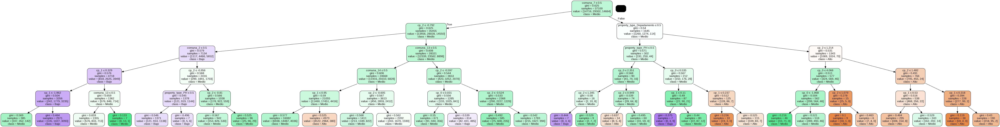

In [1975]:
dot_data = StringIO()

#Grafico uno de los arboles
export_graphviz(rf_tree_clf_PCA.estimators_[0], out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names=features_PCA,
                class_names=['Alto','Medio', 'Bajo'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

#### Evaluar

Se evalúa la performance del modelo para datos de train

F1-Score: 0.574452131829181


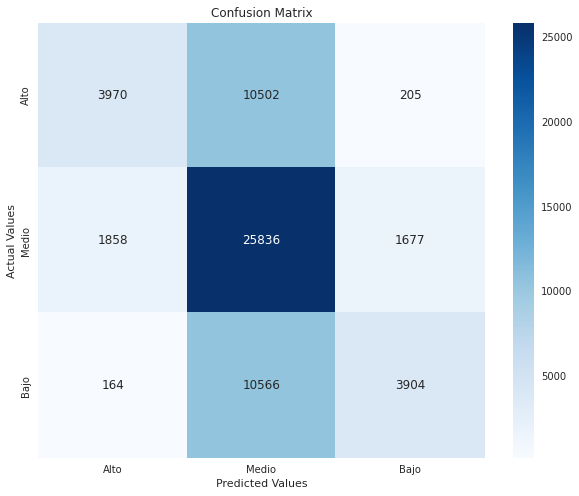

In [1976]:
y_pred_PCA= rf_tree_clf_PCA.predict(x_train_PCA)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_train_PCA, y_pred_PCA, average='micro')))

cm = confusion_matrix(y_train_PCA,y_pred_PCA)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

A continuación se evalúa para datos de test

F1-Score: 0.47113132148270637


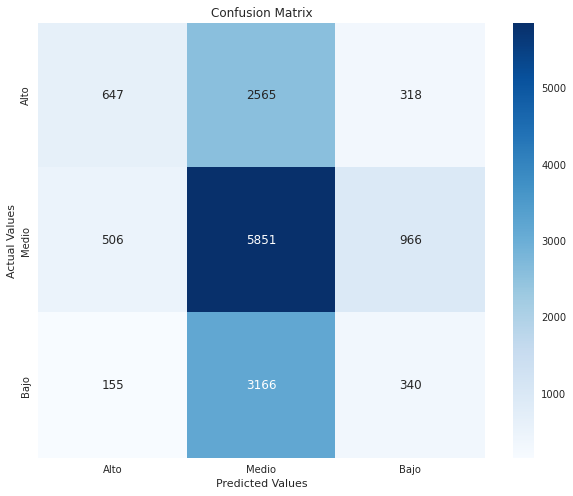

In [1977]:
#Hago predicción sobre el set de evaluacion
y_pred_PCA= rf_tree_clf_PCA.predict(x_test_PCA)

#Arbol Reporte y Matriz de Confusion
#print(classification_report(y_test,y_pred))
print('F1-Score: {}'.format(f1_score(y_test_PCA, y_pred_PCA, average='micro')))

cm = confusion_matrix(y_test_PCA,y_pred_PCA)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Nuevamente las performance en train y test resultan similares, y el modelo predice la mayoría de las veces tipo_precio Medio.

Se guarda el modelo Random Forest entrenado con PCA

In [1978]:
import joblib  

try:
  joblib.dump(rf_tree_clf_PCA, 'drive/My Drive/tp1 datos grupal/Modelos/RandomForest_PCA.pkl')
except:
  joblib.dump(rf_tree_clf_PCA, 'RandomForest_PCA.pkl')

## CatBoost Classifier

### Dataset original

In [1979]:
!pip install catboost
import catboost as cb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 76.6 MB 1.2 MB/s 


In [1980]:
import numpy as np

x_train = df_encoded_train.drop('property_price', axis=1).values
y_train = prop_caba_data[target].tolist()


x_test = df_encoded_test.drop('property_price', axis=1).values
y_test =  prop_caba_test[target].tolist()

model =  cb.CatBoostClassifier(random_seed = 0, loss_function='MultiClass', verbose=False)

grid = {'learning_rate': [0.7, 0.8, 0.9],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1,10,20]}

grid_search_result = model.grid_search(grid, 
                                       X=x_train[:60], 
                                       y=y_train[:60])


bestTest = 1.084474407
bestIteration = 0

0:	loss: 1.0844744	best: 1.0844744 (0)	total: 652ms	remaining: 17s

bestTest = 1.097248947
bestIteration = 0

1:	loss: 1.0972489	best: 1.0844744 (0)	total: 2.19s	remaining: 27.4s

bestTest = 1.113534022
bestIteration = 0

2:	loss: 1.1135340	best: 1.0844744 (0)	total: 4.31s	remaining: 34.5s

bestTest = 1.024657487
bestIteration = 3

3:	loss: 1.0246575	best: 1.0246575 (3)	total: 5.29s	remaining: 30.4s

bestTest = 1.027503772
bestIteration = 3

4:	loss: 1.0275038	best: 1.0246575 (3)	total: 5.79s	remaining: 25.5s

bestTest = 1.043327652
bestIteration = 2

5:	loss: 1.0433277	best: 1.0246575 (3)	total: 6.26s	remaining: 21.9s

bestTest = 1.03086229
bestIteration = 3

6:	loss: 1.0308623	best: 1.0246575 (3)	total: 6.69s	remaining: 19.1s

bestTest = 1.028066321
bestIteration = 3

7:	loss: 1.0280663	best: 1.0246575 (3)	total: 7.17s	remaining: 17s

bestTest = 1.02648106
bestIteration = 3

8:	loss: 1.0264811	best: 1.0246575 (3)	total: 8.43s	remaining: 16.9

In [1981]:
grid_search_result['params']

{'depth': 4, 'l2_leaf_reg': 10, 'learning_rate': 0.7}

In [1982]:
model = cb.CatBoostClassifier(random_seed = 0, l2_leaf_reg = grid_search_result['params']['l2_leaf_reg'],
                          learning_rate=grid_search_result['params']['learning_rate'],
                          depth=grid_search_result['params']['depth'])
# Fit model
model.fit(x_train, y_train)
# Get predictions for train
y_pred = model.predict(x_train)

0:	learn: 0.9580658	total: 22.2ms	remaining: 22.2s
1:	learn: 0.9157556	total: 55.4ms	remaining: 27.6s
2:	learn: 0.8912026	total: 77.3ms	remaining: 25.7s
3:	learn: 0.8745638	total: 99.8ms	remaining: 24.8s
4:	learn: 0.8612221	total: 126ms	remaining: 25.1s
5:	learn: 0.8497585	total: 148ms	remaining: 24.5s
6:	learn: 0.8450173	total: 169ms	remaining: 23.9s
7:	learn: 0.8404689	total: 191ms	remaining: 23.6s
8:	learn: 0.8359842	total: 212ms	remaining: 23.4s
9:	learn: 0.8320366	total: 237ms	remaining: 23.5s
10:	learn: 0.8287428	total: 258ms	remaining: 23.2s
11:	learn: 0.8253933	total: 279ms	remaining: 23s
12:	learn: 0.8220153	total: 301ms	remaining: 22.9s
13:	learn: 0.8195981	total: 322ms	remaining: 22.7s
14:	learn: 0.8172742	total: 343ms	remaining: 22.5s
15:	learn: 0.8159139	total: 367ms	remaining: 22.6s
16:	learn: 0.8144987	total: 387ms	remaining: 22.4s
17:	learn: 0.8106632	total: 410ms	remaining: 22.4s
18:	learn: 0.8076970	total: 431ms	remaining: 22.3s
19:	learn: 0.8040220	total: 456ms	remai

F1-Score: 0.7317916908080843


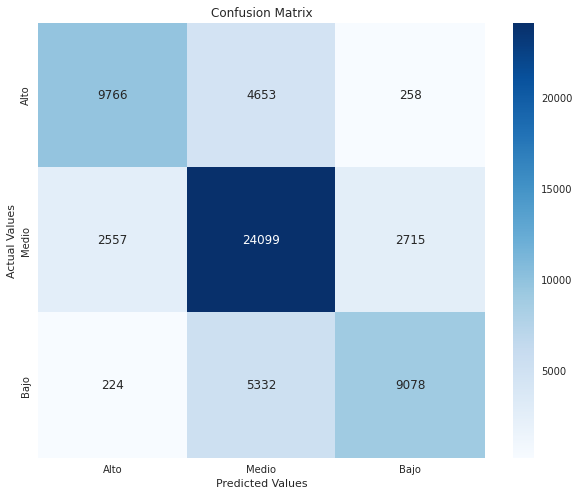

In [1983]:
from sklearn.metrics import confusion_matrix, f1_score
print('F1-Score: {}'.format(f1_score(y_train, y_pred, average='micro')))

cm = confusion_matrix(prop_caba_data[target].tolist(),y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Para train se obtiene un F1 score alto. Analizamos los resultados en test:

In [1984]:
# Get predictions
y_pred = model.predict(x_test)

F1-Score: 0.67142069725782


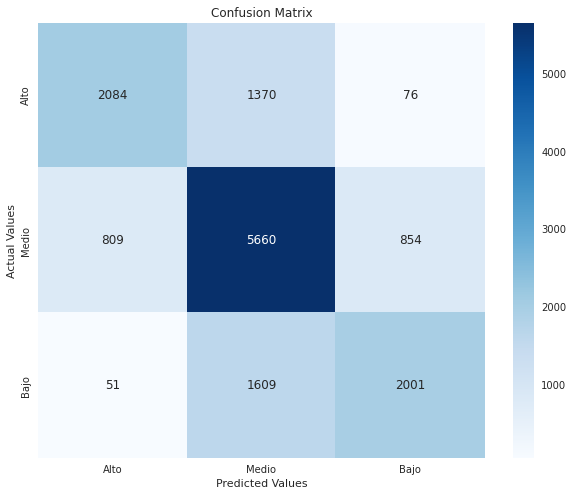

In [1985]:
from sklearn.metrics import confusion_matrix, f1_score
print('F1-Score: {}'.format(f1_score(y_test, y_pred, average='micro')))

cm = confusion_matrix(prop_caba_test[target].tolist(),y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Al igual que en los modelos anteriores, decidimos utilizar la métrica del f1-score para poder tener un mejor resultado en predicciones para el accuracy y el recall.

En este caso obtuvimos para test un F1 de aproximadamente 0.7, resultando entonces en nuestro mejor modelo de clasificación. A que costo? El tiempo de ejecución es muy elevado, la búsqueda de hiperparámetros se realiza con porciones muy pequeñas de datos, de modo contrario se cuelga y finaliza la ejecución.

Se guarda el modelo Cat Boost

In [1986]:
import joblib  

try:
  joblib.dump(model, 'drive/My Drive/tp1 datos grupal/Modelos/CatBoostClassifier.pkl')
except:
  joblib.dump(model, 'CatBoostClassifier.pkl')

### PCA

In [1987]:
#Separo un set de Evaluacion
y_train = prop_caba_data[target].tolist()
y_test =  prop_caba_test[target].tolist()

X_train = df_PCA_ENCODED_train.drop('property_price', axis=1)
X_test = df_PCA_ENCODED_test.drop('property_price', axis=1)

#Verifico Cantidad de Datos en cada set
print('# Datos Entrenamiento: {}'.format(len(x_train)))
print('# Datos Prueba: {}'.format(len(x_test)))


# Datos Entrenamiento: 58682
# Datos Prueba: 14514


In [1988]:
model =   cb.CatBoostClassifier(random_seed = 0, verbose=False)

grid = {'learning_rate': [0.7, 0.8, 0.9],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1,10,20]}

grid_search_result = model.grid_search(grid, 
                                       X=X_train[:60], 
                                       y=y_train[:60], verbose=False)


bestTest = 1.091645581
bestIteration = 0


bestTest = 1.10100727
bestIteration = 0


bestTest = 1.112679344
bestIteration = 0


bestTest = 1.070754129
bestIteration = 1


bestTest = 1.069877979
bestIteration = 1


bestTest = 1.069643237
bestIteration = 1


bestTest = 1.060592428
bestIteration = 11


bestTest = 1.076301422
bestIteration = 1


bestTest = 1.074766762
bestIteration = 1


bestTest = 1.097800356
bestIteration = 0


bestTest = 1.108786202
bestIteration = 0


bestTest = 1.122394774
bestIteration = 0


bestTest = 1.056247501
bestIteration = 1


bestTest = 1.048883757
bestIteration = 2


bestTest = 1.049639674
bestIteration = 2


bestTest = 1.054824327
bestIteration = 3


bestTest = 1.053727417
bestIteration = 3


bestTest = 1.054923915
bestIteration = 2


bestTest = 1.126981192
bestIteration = 0


bestTest = 1.128561881
bestIteration = 2


bestTest = 1.143193152
bestIteration = 2


bestTest = 1.048221507
bestIteration = 3


bestTest = 1.047766947
bestIteration = 3


bestTest =

In [1989]:
model = cb.CatBoostClassifier(l2_leaf_reg = grid_search_result['params']['l2_leaf_reg'],
                          learning_rate=grid_search_result['params']['learning_rate'],
                          depth=grid_search_result['params']['depth'], verbose=False, random_seed = 0)
# Fit model
model.fit(X_train, y_train)

# Get predictions for train
y_pred = model.predict(X_train)

F1-Score: 0.8663303909205549


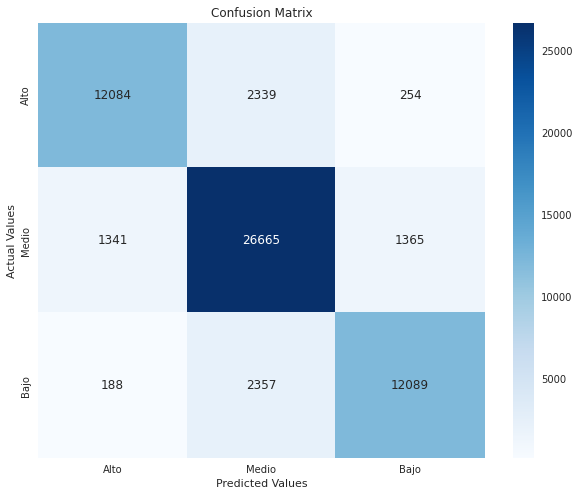

In [1990]:
from sklearn.metrics import confusion_matrix, f1_score
print('F1-Score: {}'.format(f1_score(y_train, y_pred, average='micro')))

cm = confusion_matrix(prop_caba_data[target].tolist(), y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Para train se obtiene un F1 cercano a 0.9, lo que en un principio resulta sospechoso, a continuación se analiza que sucede en test

In [1993]:
# Get predictions
y_pred = model.predict(x_test)

F1-Score: 0.33457351522667766


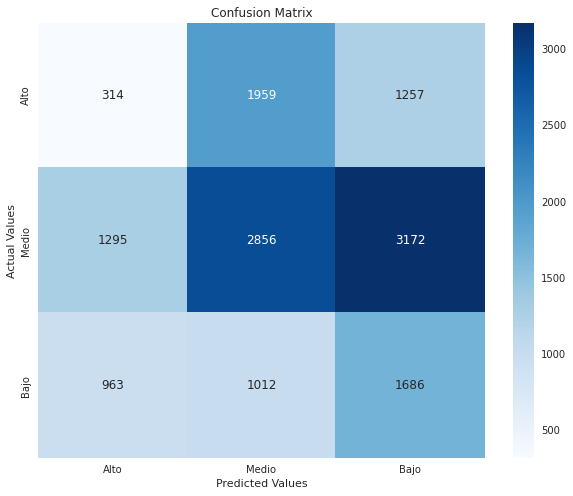

In [1994]:
from sklearn.metrics import confusion_matrix, f1_score
print('F1-Score: {}'.format(f1_score(y_test, y_pred, average='micro')))

cm = confusion_matrix(prop_caba_test[target].tolist(),y_pred)

# Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
cm_df = pd.DataFrame(cm,
                     index = ['Alto','Medio','Bajo'], 
                     columns = ['Alto','Medio','Bajo'])

#Plotting the confusion matrix
plt.figure(figsize=(10,8))
sns.heatmap(cm_df, cmap='Blues', annot=True, fmt='g')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.show()

Se obtuvo un F1 de aproximadamente 0.3 para test, mientras que en train se obtuvo F1 de 0.9, esto nos dice que el modelo performó bien en train pero muy mal en test, por lo que concluímos que el modelo hizo overfitting.

Se guarda el modelo Cat Boost entrenado con PCA

In [1995]:
import joblib  

try:
  joblib.dump(model, 'drive/My Drive/tp1 datos grupal/Modelos/CatBoostClassifier_PCA.pkl')
except:
  joblib.dump(model, 'CatBoostClassifier_PCA.pkl')

## Análisis de performance
En base a la métrica elegida para evaluar la performance de los modelos entrenados, es decir F1 score, se concluye que utilizando CatBoost Classifier se obtienen los mejores resultados, sin embargo la performance al entrenar CatBoost Classifier usando PCA no fue similar a la obtenida utilizando el DataSet original, sino que los resultados fueron bastante malos y el modelo overfitteo los datos.

Por otro lado, vimos que el arbol de decisión y el random forest obtuvieron métricas similares de f1 score a diferencia que el arbol de decisión se construyó con mayor cantidad de nodos pero el modelo de random forest tardó mayor tiempo en entrenarse.

#**4. Regresión**

In [1996]:

#diccionario para guardar performance de modelos para analisis
mse_model_performance = {}

## Regresión KNN

#### Grid search

In [1997]:
from sklearn import neighbors
#Conjunto de parámetros que quiero usar
params_grid = {'metric':['euclidean','manhattan'],
               'n_neighbors':list(range(2,6)),
               'weights': ['uniform','distance'], 
               'leaf_size':list(range(10,40,10))}
                
#Cantidad de folds utilizados
folds=3

#KFold
kfoldcv = KFold(n_splits=folds)

#Modelo
model = neighbors.KNeighborsRegressor()

#Usamos MSE como métrica para buscar hiperparámetros
scorer_fn = make_scorer(sk.metrics.mean_squared_error)

#GridSearch CV
gridcv = GridSearchCV(estimator=model,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

In [1998]:
gridcv.fit(x_train[:1000],train_target.values[:1000])

GridSearchCV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
             estimator=KNeighborsRegressor(),
             param_grid={'leaf_size': [10, 20, 30],
                         'metric': ['euclidean', 'manhattan'],
                         'n_neighbors': [2, 3, 4, 5],
                         'weights': ['uniform', 'distance']},
             return_train_score='True',
             scoring=make_scorer(mean_squared_error))

In [1999]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'leaf_size': 10, 'metric': 'euclidean', 'n_neighbors': 2, 'weights': 'uniform'}
7325456740.901591


#### Mejor modelo

In [2000]:
import numpy as np
import matplotlib.pyplot as plt


knn = neighbors.KNeighborsRegressor().set_params(**gridcv.best_params_)
knn.fit(x_train,train_target)

KNeighborsRegressor(leaf_size=10, metric='euclidean', n_neighbors=2)

#### Evaluar 

In [2001]:
from sklearn import metrics

y_pred = knn.predict(x_train)
mse = metrics.mean_squared_error(
        y_true  = train_target,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de train es: {mse}")

y_pred = knn.predict(x_test)
mse = metrics.mean_squared_error(
        y_true  = test_target,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de test es: {mse}")
mse_model_performance['knn_regression'] = mse

El error (mse) de train es: 1271526146.4098105
El error (mse) de test es: 4750613079.718117


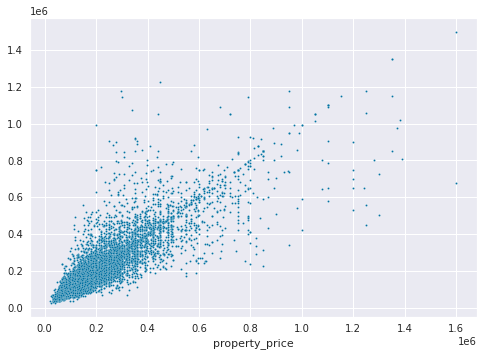

In [2002]:
sns.scatterplot(x=test_target, y=y_pred,s=4)

In [2003]:
prop_caba_test.columns

Index(['latitud', 'longitud', 'place_l3', 'property_type', 'property_rooms',
       'property_bedrooms', 'property_surface_total',
       'property_surface_covered', 'comuna', 'pxm2', 'tipo_precio'],
      dtype='object')

In [2004]:
test_target.max()

1600000.0

In [2005]:
test_target.min()

23000.0

Se guarda el modelo entrenado KNN:

In [2006]:
import joblib  

try:
  joblib.dump(knn, 'drive/My Drive/tp1 datos grupal/Modelos/RegresionKNN.pkl')
except:
  joblib.dump(knn, 'RegresionKNN.pkl')

### PCA

In [2007]:
#Separo un set de Evaluacion
y_train = df_PCA_ENCODED_train['property_price']
y_test = df_PCA_ENCODED_test['property_price']
X_train = df_PCA_ENCODED_train.drop('property_price', axis=1)
X_test = df_PCA_ENCODED_test.drop('property_price', axis=1)

#Verifico Cantidad de Datos en cada set
print('# Datos Entrenamiento: {}'.format(len(x_train)))
print('# Datos Prueba: {}'.format(len(x_test)))

# Datos Entrenamiento: 58682
# Datos Prueba: 14514


In [2008]:
from sklearn import neighbors
#Conjunto de parámetros que quiero usar
params_grid = {'metric':['euclidean','manhattan'],
               'n_neighbors':list(range(2,6,2)),
               'weights': ['uniform','distance'], 
               'leaf_size':list(range(10,40,10))}
                
#Cantidad de folds utilizados
folds=3

#KFold
kfoldcv = KFold(n_splits=folds)

#Modelo
model = neighbors.KNeighborsRegressor()

#Usamos MSE como métrica para buscar hiperparámetros
scorer_fn = make_scorer(sk.metrics.mean_squared_error)

#GridSearch CV
gridcv = GridSearchCV(estimator=model,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

In [2009]:
gridcv.fit(X_train[:1000],y_train.values[:1000])

GridSearchCV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
             estimator=KNeighborsRegressor(),
             param_grid={'leaf_size': [10, 20, 30],
                         'metric': ['euclidean', 'manhattan'],
                         'n_neighbors': [2, 4],
                         'weights': ['uniform', 'distance']},
             return_train_score='True',
             scoring=make_scorer(mean_squared_error))

In [2010]:
knn = neighbors.KNeighborsRegressor().set_params(**gridcv.best_params_)
knn.fit(X_train,y_train)

KNeighborsRegressor(leaf_size=10, metric='manhattan', n_neighbors=2)

In [2011]:
from sklearn import metrics

y_pred = knn.predict(X_train)
mse = metrics.mean_squared_error(
        y_true  = y_train,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de train es: {mse}")

y_pred = knn.predict(X_test)
mse = metrics.mean_squared_error(
        y_true  = y_test,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de test es: {mse}")
mse_model_performance['knn_regression_pca'] = mse

El error (mse) de train es: 896214902.36089
El error (mse) de test es: 20911576329.56385


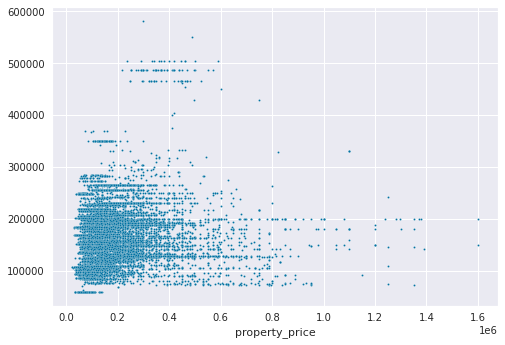

In [2012]:
sns.scatterplot(x=test_target, y=y_pred,s=4)

Se guarda el modelo KNN entrenado con PCA:

In [2013]:
import joblib  

try:
  joblib.dump(knn, 'drive/My Drive/tp1 datos grupal/Modelos/RegresionKNN_PCA.pkl')
except:
  joblib.dump(knn, 'RegresionKNN_PCA.pkl')

### Análisis de performance
La calidad del modelo KNN es la más baja, con muchos puntos muy alejados del valor real. 

TODO: razonar por qué predijo mal, lo que peor predijo

## XGBoost

In [2014]:
from sklearn.metrics import mean_squared_error
import xgboost as xgb

#### Grid search

In [2015]:
#Conjunto de parámetros que quiero usar
params_grid = {"learning_rate": (0.1, 0.2, 0.4),
                        "max_depth": [8, 16, 32],
                        "min_child_weight": [5, 10, 20],
                        "gamma":[ 0.0, 0.2, 0.4],
                        "colsample_bytree":[ 0.3, 0.4, 0.5]}
                
#Cantidad de folds utilizados
folds=3

#KFold
kfoldcv = KFold(n_splits=folds)

#Modelo
model =  xgb.XGBRegressor(objective = "reg:squarederror")

#Usamos MSE como métrica para buscar hiperparámetros
scorer_fn = make_scorer(sk.metrics.mean_squared_error)

#GridSearch CV
gridcv = GridSearchCV(estimator=model,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

In [2016]:
gridcv.fit(x_train[:100],train_target.values[:100])

GridSearchCV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
             estimator=XGBRegressor(objective='reg:squarederror'),
             param_grid={'colsample_bytree': [0.3, 0.4, 0.5],
                         'gamma': [0.0, 0.2, 0.4],
                         'learning_rate': (0.1, 0.2, 0.4),
                         'max_depth': [8, 16, 32],
                         'min_child_weight': [5, 10, 20]},
             return_train_score='True',
             scoring=make_scorer(mean_squared_error))

In [2017]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'colsample_bytree': 0.5, 'gamma': 0.0, 'learning_rate': 0.4, 'max_depth': 8, 'min_child_weight': 10}
9491406490.381033


#### Mejor modelo

In [2018]:
reg =  xgb.XGBRegressor(**gridcv.best_params_)
reg.fit(x_train,train_target)

[03:32:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(colsample_bytree=0.5, gamma=0.0, learning_rate=0.4, max_depth=8,
             min_child_weight=10)

In [2019]:
from sklearn import metrics

y_pred = reg.predict(x_train)
mse = metrics.mean_squared_error(
        y_true  = train_target,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de train es: {mse}")

y_pred = reg.predict(x_test)
mse = metrics.mean_squared_error(
        y_true  = test_target,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de test es: {mse}")
mse_model_performance['xgb'] = mse

El error (mse) de train es: 1118917868.550943
El error (mse) de test es: 2136148658.8986006


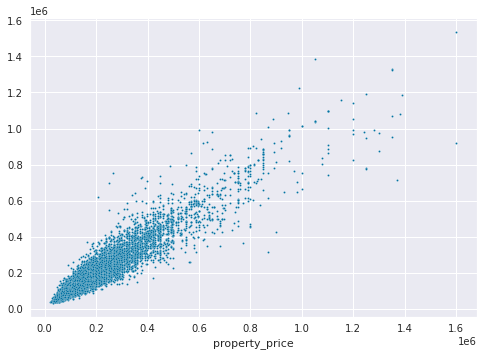

In [2020]:
sns.scatterplot(x=test_target, y=y_pred,s=4)

Se guarda el modelo XGBoost entrenado:

In [2021]:
import joblib  

try:
  joblib.dump(reg, 'drive/My Drive/tp1 datos grupal/Modelos/RegresionXGBoost.pkl')
except:
  joblib.dump(reg, 'RegresionXGBoost.pkl')

### PCA

In [2022]:
#Separo un set de Evaluacion
y_train = df_PCA_ENCODED_train['property_price']
y_test = df_PCA_ENCODED_test['property_price']
X_train = df_PCA_ENCODED_train.drop('property_price', axis=1)
X_test = df_PCA_ENCODED_test.drop('property_price', axis=1)

#Verifico Cantidad de Datos en cada set
print('# Datos Entrenamiento: {}'.format(len(x_train)))
print('# Datos Prueba: {}'.format(len(x_test)))

# Datos Entrenamiento: 58682
# Datos Prueba: 14514


In [2023]:
#Conjunto de parámetros que quiero usar
params_grid = {"learning_rate": (0.1, 0.2, 0.4),
                        "max_depth": [8, 16, 32],
                        "min_child_weight": [5, 10, 20],
                        "gamma":[ 0.0, 0.2, 0.4],
                        "colsample_bytree":[ 0.3, 0.4, 0.5]}
                
#Cantidad de folds utilizados
folds=3

#KFold
kfoldcv = KFold(n_splits=folds)

#Modelo
model =  xgb.XGBRegressor(objective = "reg:squarederror")

#Usamos MSE como métrica para buscar hiperparámetros
scorer_fn = make_scorer(sk.metrics.mean_squared_error)

#GridSearch CV
gridcv = GridSearchCV(estimator=model,param_grid=params_grid,scoring=scorer_fn,cv=kfoldcv,return_train_score='True')

In [2024]:
gridcv.fit(X_train[:100],y_train.values[:100])

GridSearchCV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
             estimator=XGBRegressor(objective='reg:squarederror'),
             param_grid={'colsample_bytree': [0.3, 0.4, 0.5],
                         'gamma': [0.0, 0.2, 0.4],
                         'learning_rate': (0.1, 0.2, 0.4),
                         'max_depth': [8, 16, 32],
                         'min_child_weight': [5, 10, 20]},
             return_train_score='True',
             scoring=make_scorer(mean_squared_error))

In [2025]:
#Mejores hiperparametros del arbol
print(gridcv.best_params_)
#Mejor métrica
print(gridcv.best_score_)

{'colsample_bytree': 0.5, 'gamma': 0.0, 'learning_rate': 0.4, 'max_depth': 8, 'min_child_weight': 10}
8784748645.24153


In [2026]:
reg =  xgb.XGBRegressor(**gridcv.best_params_)
reg.fit(X_train,y_train)

[03:32:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(colsample_bytree=0.5, gamma=0.0, learning_rate=0.4, max_depth=8,
             min_child_weight=10)

In [2027]:
from sklearn import metrics

y_pred = reg.predict(X_train)
mse = metrics.mean_squared_error(
        y_true  = y_train,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de train es: {mse}")

y_pred = reg.predict(X_test)
mse = metrics.mean_squared_error(
        y_true  = y_test,
        y_pred  = y_pred,
        squared = True
       )

print(f"El error (mse) de test es: {mse}")
mse_model_performance['xgb_pca'] = mse

El error (mse) de train es: 1856371441.4571242
El error (mse) de test es: 18359129561.955074


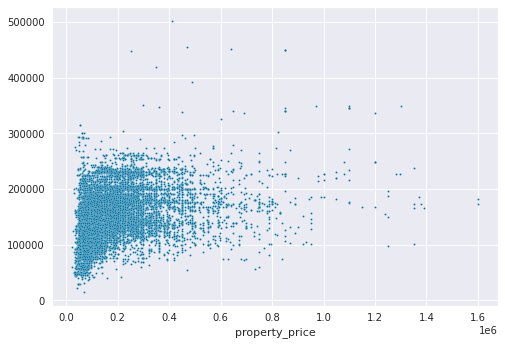

In [2028]:
sns.scatterplot(x=test_target, y=y_pred,s=4)

### Análisis de performance
El error MSE es proporcional a la escala de los precios de las propiedades. Aun así, se ve del gráfico que hay una amplia diferencia entre los valores reales y predichos, a menudo de hasta el doble del valor real. La performance del modelo es mediocre. Sin embargo, tiene una performance en la misma magnitud en train y test. Usando PCA se obtuvieron resultados similares.

Se guarda el modelo XGBoost entrenado con PCA:

In [2029]:
import joblib  

try:
  joblib.dump(reg, 'drive/My Drive/tp1 datos grupal/Modelos/RegresionXGBoost_PCA.pkl')
except:
  joblib.dump(reg, 'RegresionXGBoost_PCA.pkl')

## CatBoost Regressor

### Dataset original

In [2030]:
!pip install catboost
import catboost as cb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2031]:
import numpy as np

model =  cb.CatBoostRegressor()

grid = {'learning_rate': [0.7, 0.8, 0.9],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1,10,20]}

grid_search_result = model.grid_search(grid, 
                                       X=x_train[:100], 
                                       y=train_target.values[:100], verbose = False)

Se truncaron las últimas líneas 5000 del resultado de transmisión.
23:	learn: 29142.7913932	test: 82463.6841836	best: 82463.6841836 (23)	total: 215ms	remaining: 8.72s
24:	learn: 28201.1200956	test: 82459.5700525	best: 82459.5700525 (24)	total: 226ms	remaining: 8.82s
25:	learn: 27096.1342837	test: 82240.8473183	best: 82240.8473183 (25)	total: 237ms	remaining: 8.86s
26:	learn: 25776.8624323	test: 82094.1412901	best: 82094.1412901 (26)	total: 243ms	remaining: 8.74s
27:	learn: 24922.2048930	test: 82068.0464719	best: 82068.0464719 (27)	total: 251ms	remaining: 8.71s
28:	learn: 24027.9988123	test: 81460.4294784	best: 81460.4294784 (28)	total: 260ms	remaining: 8.72s
29:	learn: 23248.3111627	test: 81191.5893126	best: 81191.5893126 (29)	total: 272ms	remaining: 8.79s
30:	learn: 22543.2903715	test: 80936.0301596	best: 80936.0301596 (30)	total: 281ms	remaining: 8.78s
31:	learn: 21926.5768865	test: 80972.9203810	best: 80936.0301596 (30)	total: 290ms	remaining: 8.79s
32:	learn: 21101.6844922	test: 80

In [2032]:
grid_search_result['params']

{'depth': 4, 'l2_leaf_reg': 20, 'learning_rate': 0.8}

In [2033]:
model = cb.CatBoostRegressor(l2_leaf_reg = grid_search_result['params']['l2_leaf_reg'],
                          learning_rate=grid_search_result['params']['learning_rate'],
                          depth=grid_search_result['params']['depth'], verbose = False)
# Fit model
model.fit(x_train, train_target)
# Get predictions for train
preds = model.predict(x_train)

In [2034]:
mse = metrics.mean_squared_error(
        y_true  = train_target,
        y_pred  = preds,
        squared = True
       )

print(f"El error (mse) de train es: {mse}")

El error (mse) de train es: 1217548883.7710893


In [2035]:
# Get predictions
preds = model.predict(x_test)

In [2036]:
mse = metrics.mean_squared_error(
        y_true  = test_target,
        y_pred  = preds,
        squared = True
       )

print(f"El error (mse) de test es: {mse}")
mse_model_performance['cat_regression'] = mse

El error (mse) de test es: 2149678349.977782


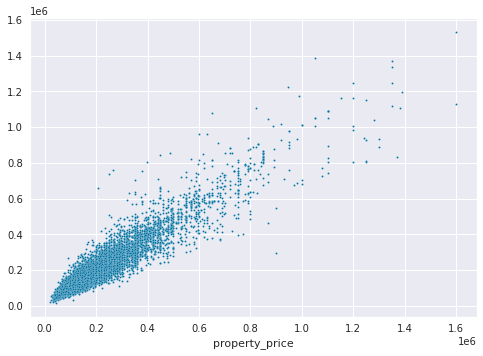

In [2037]:
sns.scatterplot(x=test_target, y=preds,  s=4)

Se guarda el modelo Cat Boost

In [2038]:
import joblib  

try:
  joblib.dump(model, 'drive/My Drive/tp1 datos grupal/Modelos/RegresionCatBoost.pkl')
except:
  joblib.dump(model, 'RegresionCatBoost.pkl')

### PCA

In [2039]:
#Separo un set de Evaluacion
y_train = df_PCA_ENCODED_train['property_price']
y_test = df_PCA_ENCODED_test['property_price']
X_train = df_PCA_ENCODED_train.drop('property_price', axis=1)
X_test = df_PCA_ENCODED_test.drop('property_price', axis=1)

#Verifico Cantidad de Datos en cada set
print('# Datos Entrenamiento: {}'.format(len(x_train)))
print('# Datos Prueba: {}'.format(len(x_test)))


# Datos Entrenamiento: 58682
# Datos Prueba: 14514


In [2040]:
model =   cb.CatBoostRegressor()

grid = {'learning_rate': [0.7, 0.8, 0.9],
        'depth': [4, 6, 10],
        'l2_leaf_reg': [1,10,20]}

grid_search_result = model.grid_search(grid, 
                                       X=X_train[:100], 
                                       y=y_train.values[:100])

Se truncaron las últimas líneas 5000 del resultado de transmisión.
26:	learn: 34918.6319884	test: 123289.4570343	best: 123278.8027481 (25)	total: 113ms	remaining: 4.08s
27:	learn: 32989.5980600	test: 122494.6426935	best: 122494.6426935 (27)	total: 117ms	remaining: 4.08s
28:	learn: 32041.5022516	test: 122672.3761019	best: 122494.6426935 (27)	total: 122ms	remaining: 4.07s
29:	learn: 31336.5862866	test: 122618.8936281	best: 122494.6426935 (27)	total: 126ms	remaining: 4.06s
30:	learn: 30486.0609214	test: 122600.7266000	best: 122494.6426935 (27)	total: 130ms	remaining: 4.05s
31:	learn: 29556.2709286	test: 122423.1267965	best: 122423.1267965 (31)	total: 134ms	remaining: 4.05s
32:	learn: 28632.9179806	test: 122351.8607038	best: 122351.8607038 (32)	total: 138ms	remaining: 4.04s
33:	learn: 27461.5495087	test: 121977.1974051	best: 121977.1974051 (33)	total: 142ms	remaining: 4.04s
34:	learn: 26207.2133208	test: 121428.7375598	best: 121428.7375598 (34)	total: 146ms	remaining: 4.04s
35:	learn: 2536

In [2041]:
model = cb.CatBoostRegressor(l2_leaf_reg = grid_search_result['params']['l2_leaf_reg'],
                          learning_rate=grid_search_result['params']['learning_rate'],
                          depth=grid_search_result['params']['depth'])
# Fit model
model.fit(X_train, y_train)
# Get predictions for train
preds = model.predict(X_train)

0:	learn: 90564.4809989	total: 7.3ms	remaining: 7.3s
1:	learn: 77262.9950793	total: 14.6ms	remaining: 7.28s
2:	learn: 72716.3776316	total: 20.7ms	remaining: 6.88s
3:	learn: 69525.8999499	total: 27.1ms	remaining: 6.75s
4:	learn: 68208.3816964	total: 33.4ms	remaining: 6.65s
5:	learn: 67401.4149190	total: 39.6ms	remaining: 6.56s
6:	learn: 66102.0638595	total: 46ms	remaining: 6.52s
7:	learn: 65360.0582629	total: 52.3ms	remaining: 6.49s
8:	learn: 64787.3937460	total: 59.2ms	remaining: 6.52s
9:	learn: 64349.0257640	total: 65.3ms	remaining: 6.46s
10:	learn: 63867.1359493	total: 71.5ms	remaining: 6.42s
11:	learn: 63596.2530382	total: 77.6ms	remaining: 6.39s
12:	learn: 63332.2117248	total: 84.2ms	remaining: 6.39s
13:	learn: 62812.7896003	total: 91.3ms	remaining: 6.43s
14:	learn: 62531.5001153	total: 98.1ms	remaining: 6.44s
15:	learn: 62239.9880521	total: 105ms	remaining: 6.46s
16:	learn: 61941.8325076	total: 112ms	remaining: 6.46s
17:	learn: 61597.5683028	total: 118ms	remaining: 6.46s
18:	learn

In [2042]:
mse = metrics.mean_squared_error(
        y_true  = y_train,
        y_pred  = preds,
        squared = True
       )

print(f"El error (mse) de train es: {mse}")

El error (mse) de train es: 2006566685.4295251


In [2043]:
# Get predictions
preds = model.predict(X_test)

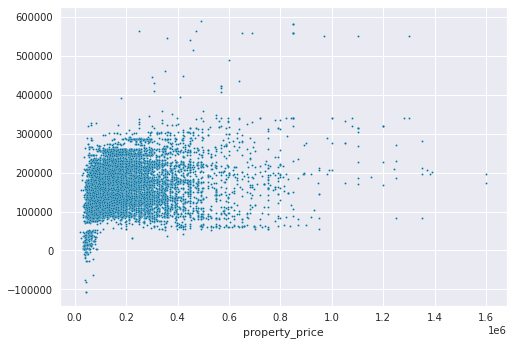

In [2044]:
sns.scatterplot(x=y_test, y=preds,  s=4)

In [2045]:
mse = metrics.mean_squared_error(
        y_true  = y_test,
        y_pred  = preds,
        squared = True
       )

print(f"El error (mse) de test es: {mse}")
mse_model_performance['cat_regression_pca'] = mse

El error (mse) de test es: 19054676364.049404


Se guarda el modelo Cat Boost entrenado con PCA

In [2046]:
import joblib  

try:
  joblib.dump(model, 'drive/My Drive/tp1 datos grupal/Modelos/RegresionCatBoost_PCA.pkl')
except:
  joblib.dump(model, 'RegresionCatBoost_PCA.pkl')

### Análisis de performance
Comparamos el error MSE de cada modelo:

In [2047]:
pairs = mse_model_performance.items()
keys = list(map(lambda pair: pair[0], pairs))
values = list(map(lambda pair: pair[1], pairs))

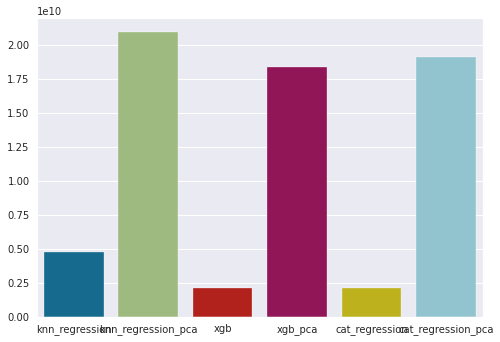

In [2048]:
sns.barplot(x = keys, y=values)

Se ve que la mejor performance la lograron XGB y CatBoost Regression, sin usar el dataset PCA.

In [2049]:
print("Performance de xgb:" + str(mse_model_performance['xgb']))
print("Performance de cat boost:" + str(mse_model_performance['cat_regression']))

Performance de xgb:2136148658.8986006
Performance de cat boost:2149678349.977782


#**5. Conclusiones**

A lo largo del desarrollo del TP se aplicaron diversas técnicas aprendidas en la teoría, pero que se terminaron de afianzar y entender en la práctica.

Nos hubiera gustado explorar más técnicas de preprocesamiento de datos, creemos que identificar mejor casos especiales de propiedades, datos mal ingresados como coordenadas incorrectas, dónde codificar y transformar u omitir ciertas variables habría mejorado mucho la performance en modelos individuales. Además, no se tuvo en cuenta el dataset con las descripciones de las propiedades, probablemente se podrían haber extraído conclusiones y mejorado ciertos resultados a partir de ello, pero consideramos que excedió el alcance de este TP.

Los modelos entrenados en general performaron de buena forma. Se pudo poner a prueba las ventajas y desventajas de cada uno de ellos, destacando CatBoost, que comprobamos que tiene una potencia muy interesante pero tiene como desventaja por ejemplo la búsqueda de hiperparámetros y el tiempo de ejecución.

 En cuanto a regresión, se logró obtener modelos que están correlacionados a los valores reales en testing, obteniendo mejores resultados con árboles que en la regresión KNN.

En cuanto a clasificación, se intentó en un principio entrenar el modelo a elección utilizando Support Vector Machine, más precisamente Support Vector Classifier, pero no dió sus frutos debido a que la busqueda de hiperparámetros se hizo imposible. Por lo que se decidió entrenar un modelo utilizando Cat Boost, y resultó ser nuestro mejor modelo para clasificar las propiedades según su 'tipo_precio'.

Las clases teóricas y prácticas resultaron de mucha ayuda para la realización del TP, en especial las notebooks de la práctica, que muchas veces ahorran el trabajo de empezar algo desde cero.